***
# 4.1 Bio-mechanic Estimations for Bird 5
### JX, 03/19/2022
***
    Bird5:
    LS110131.10.9.2015GeoPool.aiff
    LS110136.10.10.2015GeoGreens.aiff
    LS110143.10.12.2015GeoGreens.aiff
    LS110146A.10.13.2015GeoGreens.aiff
    
***

In [1]:
indv = 'Bird5'

In [2]:
## Load up Note Dataframe

import pandas as pd
from pathlib2 import Path

from butcherbird.utils.paths import DATA_DIR

SAVE_LOC = 'interim/fine_labels/butcherbird_note_df_'+indv+'_fine.pickle'
SAVE_LOC = DATA_DIR / SAVE_LOC

note_df = pd.read_pickle(SAVE_LOC)

note_df

,phrase_nb,phrase_strt,phrase_end,phrase_len,note_cnt,note_nb,note_strt,note_end,note_len,indv,...,key,audio,rate,spectrogram,umap,hdbscan_labels,recur_labels,recur_labels_id,lasso_labels,seq_id
0,0,513.780000,517.061923,3.281923,15,0,513.780000,513.905214,0.125214,Bird5,...,LS110143.10.12.2015GeoGreens_dn,"[-0.0, -7.356902671940375e-05, -0.000162745769...",44100,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...","[4.8774133, 15.248685]",16,16|1|0|nan|nan|nan|nan|nan|nan,87,55,0
1,0,513.780000,517.061923,3.281923,15,1,513.917747,513.980936,0.063188,Bird5,...,LS110143.10.12.2015GeoGreens_dn,"[0.0, 0.0014728324725323874, 0.002769917049663...",44100,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...","[6.9320498, 10.134182]",13,13|1|0|1.0|0.0|1.0|0.0|nan|nan,45,58,0
2,0,513.780000,517.061923,3.281923,15,2,514.170000,514.480698,0.310698,Bird5,...,LS110143.10.12.2015GeoGreens_dn,"[0.0, 4.4531726447127805e-05, 4.62385657049665...",44100,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...","[8.438871, 21.151648]",5,5|2|0|0.0|nan|nan|nan|nan|nan,143,8,0
3,0,513.780000,517.061923,3.281923,15,3,514.620783,515.310000,0.689217,Bird5,...,LS110143.10.12.2015GeoGreens_dn,"[-0.0, -3.2631556531601904e-06, -7.44037823939...",44100,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...","[19.637224, -5.1326833]",7,7|0|1|0.0|nan|nan|nan|nan|nan,151,31,0
4,0,513.780000,517.061923,3.281923,15,4,515.355217,515.660180,0.304964,Bird5,...,LS110143.10.12.2015GeoGreens_dn,"[-0.0, -2.958346783314775e-05, -7.119856074752...",44100,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...","[9.055997, -1.52321]",12,12|1|0|nan|nan|nan|nan|nan|nan,38,48,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17325,488,3955.500491,3957.771268,2.270777,16,11,3956.827269,3956.984287,0.157018,Bird5,...,LS110146A.10.13.2015GeoGreens_dn,"[-0.0, -0.0003734800289541283, -0.000744419409...",44100,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...","[5.5191817, -9.9033375]",8,8|1|0|nan|nan|nan|nan|nan|nan,161,9,1770
17326,488,3955.500491,3957.771268,2.270777,16,12,3957.129954,3957.413722,0.283767,Bird5,...,LS110146A.10.13.2015GeoGreens_dn,"[-0.0, -5.999877314464557e-06, -1.294964036885...",44100,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...","[17.48298, -3.0183713]",15,15|1|0|nan|nan|nan|nan|nan|nan,81,34,1770
17327,488,3955.500491,3957.771268,2.270777,16,13,3957.530000,3957.576257,0.046257,Bird5,...,LS110146A.10.13.2015GeoGreens_dn,"[-0.0, -0.00020799144552458053, -0.00033384171...",44100,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...","[4.470899, -3.3807]",4,4|1|1|0.0|1.0|0.0|nan|nan|nan,138,45,1770
17328,488,3955.500491,3957.771268,2.270777,16,14,3957.585716,3957.644361,0.058645,Bird5,...,LS110146A.10.13.2015GeoGreens_dn,"[0.0, 0.0007728977791414965, 0.000127507273682...",44100,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...","[4.4345427, -3.3523924]",4,4|1|1|0.0|1.0|0.0|nan|nan|nan,138,45,1770


## Relationship Between Pre/Post Gap and Note Length

In [3]:
note_lengths = note_df['note_len'][1:] ##do not count first note
note_pres = note_df['note_strt'][1:].values-note_df['note_end'][:-1].values  ## minus previous note end from start
prebiomech = pd.DataFrame({'len': note_lengths, 
                           'pregap': note_pres})
prebiomech

,len,pregap
1,0.063188,0.012533
2,0.310698,0.189064
3,0.689217,0.140085
4,0.304964,0.045217
5,0.043540,0.232055
...,...,...
17325,0.157018,0.009474
17326,0.283767,0.145667
17327,0.046257,0.116278
17328,0.058645,0.009459


In [4]:
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
from butcherbird.utils.paths import FIGURE_DIR

In [5]:
cleanprebiomech = prebiomech[prebiomech['pregap'] < 1]

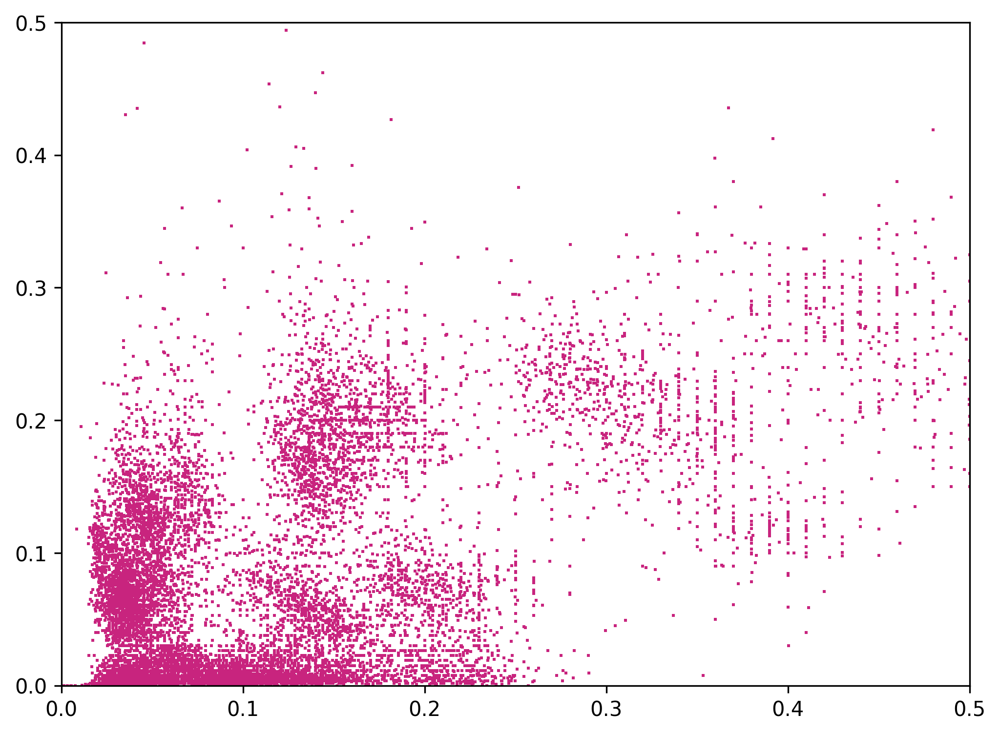

In [6]:
figure(figsize=(8, 6), dpi = 300)
plt.scatter(x = cleanprebiomech['len'], y = cleanprebiomech['pregap'], 
            marker = ",", lw = 0, s = 1.5, alpha = 1, color = "#C8247E"
           )
plt.xlim([0, 0.5])
plt.ylim([0, 0.5])
plt.savefig(FIGURE_DIR/'pregap.svg')
plt.show()

In [7]:
note_lengths = note_df['note_len'][:-1] ##do not count first note
note_post = note_df['note_strt'][1:].values-note_df['note_end'][:-1].values  ## minus previous note end from start
postbiomech = pd.DataFrame({'len': note_lengths, 
                           'postgap': note_post})
postbiomech

,len,postgap
0,0.125214,0.012533
1,0.063188,0.189064
2,0.310698,0.140085
3,0.689217,0.045217
4,0.304964,0.232055
...,...,...
17324,0.032160,0.009474
17325,0.157018,0.145667
17326,0.283767,0.116278
17327,0.046257,0.009459


In [8]:
cleanpostbiomech = postbiomech[postbiomech['postgap'] < 1]
cleanpostbiomech

,len,postgap
0,0.125214,0.012533
1,0.063188,0.189064
2,0.310698,0.140085
3,0.689217,0.045217
4,0.304964,0.232055
...,...,...
17324,0.032160,0.009474
17325,0.157018,0.145667
17326,0.283767,0.116278
17327,0.046257,0.009459


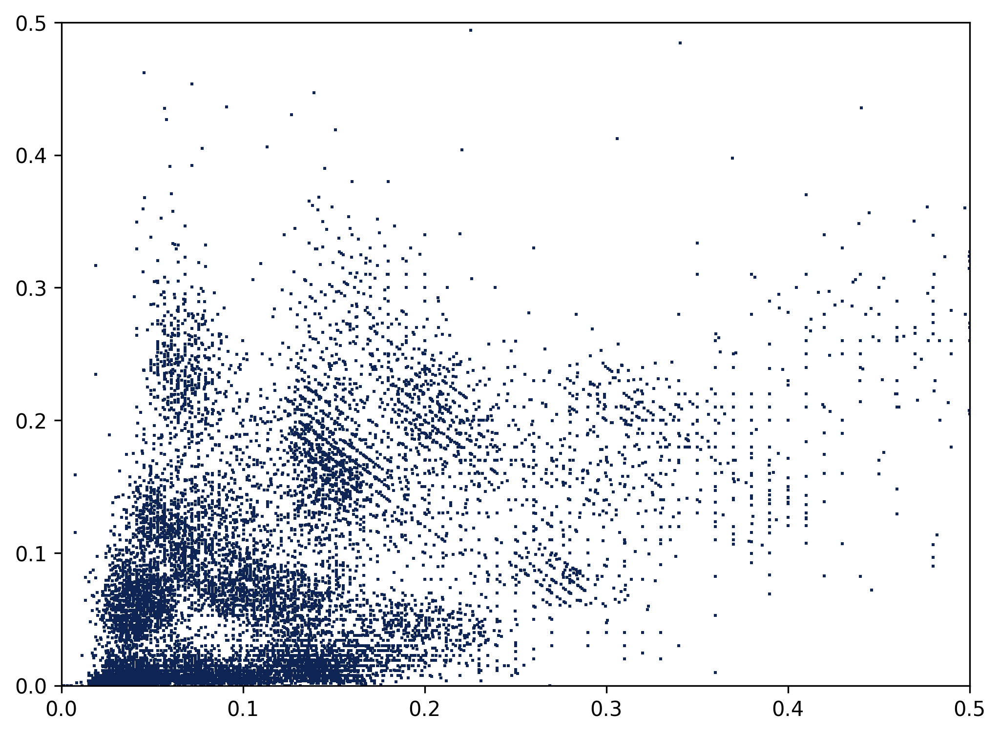

In [9]:
figure(figsize=(8, 6), dpi=300)
plt.scatter(x = cleanpostbiomech['len'], y = cleanpostbiomech['postgap'], marker = ",", lw = 0, s = 2, alpha = 1, color = '#0E2455')
plt.xlim([0, 0.5])
plt.ylim([0, 0.5])
plt.savefig(FIGURE_DIR/'postgap.svg')
plt.show()

## Heteroscedasticity test

In [10]:
from statsmodels.stats.diagnostic import het_breuschpagan
from statsmodels.stats.diagnostic import het_white
import pandas as pd
import statsmodels.api as sm
from statsmodels.formula.api import ols

In [11]:
cleanprebiomech

,len,pregap
1,0.063188,0.012533
2,0.310698,0.189064
3,0.689217,0.140085
4,0.304964,0.045217
5,0.043540,0.232055
...,...,...
17325,0.157018,0.009474
17326,0.283767,0.145667
17327,0.046257,0.116278
17328,0.058645,0.009459


In [12]:
f ='pregap~len'
premodel = ols(formula=f, data=cleanprebiomech).fit()

In [13]:
premodel.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                 pregap   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.000
Method:                 Least Squares   F-statistic:                   0.06960
Date:                Fri, 29 Jul 2022   Prob (F-statistic):              0.792
Time:                        11:31:02   Log-Likelihood:                -78293.
No. Observations:               15565   AIC:                         1.566e+05
Df Residuals:                   15563   BIC:                         1.566e+05
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept     -0.5225      0.455     -1.148      0.251      -1.415       0.370
len            0.7841      2.972      0.264      0.792      -5.042       6.610
==============================================================================
Omnibus:                    56483.720   Durbin-Watson:                   2.000
Prob(Omnibus):                  0.000   Jarque-Bera (JB):      22476386189.614
Skew:                         -75.755   Prob(JB):                         0.00
Kurtosis:                    5888.054   Cond. No.                         10.2
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [14]:
labels = ['LM Statistic', 'LM-Test p-value', 'F-Statistic', 'F-Test p-value']
prewhite = het_white(premodel.resid, premodel.model.exog)
print(dict(zip(labels, prewhite)))

{'LM Statistic': 0.6706221658714628, 'LM-Test p-value': 0.7151155914895886, 'F-Statistic': 0.3352608998415191, 'F-Test p-value': 0.7151566443098322}


In [15]:
cleanpostbiomech

,len,postgap
0,0.125214,0.012533
1,0.063188,0.189064
2,0.310698,0.140085
3,0.689217,0.045217
4,0.304964,0.232055
...,...,...
17324,0.032160,0.009474
17325,0.157018,0.145667
17326,0.283767,0.116278
17327,0.046257,0.009459


In [16]:
f ='postgap~len'
postmodel = ols(formula=f, data=cleanpostbiomech).fit()

In [17]:
postmodel.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                postgap   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.000
Method:                 Least Squares   F-statistic:                    0.1688
Date:                Fri, 29 Jul 2022   Prob (F-statistic):              0.681
Time:                        11:31:02   Log-Likelihood:                -78293.
No. Observations:               15565   AIC:                         1.566e+05
Df Residuals:                   15563   BIC:                         1.566e+05
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept     -0.2801      0.473     -0.592      0.554      -1.207       0.647
len           -1.3777      3.353     -0.411      0.681      -7.950       5.195
==============================================================================
Omnibus:                    56483.117   Durbin-Watson:                   2.000
Prob(Omnibus):                  0.000   Jarque-Bera (JB):      22474349550.386
Skew:                         -75.752   Prob(JB):                         0.00
Kurtosis:                    5887.787   Cond. No.                         11.4
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [18]:
labels = ['LM Statistic', 'LM-Test p-value', 'F-Statistic', 'F-Test p-value']
postwhite = het_white(postmodel.resid, postmodel.model.exog)
print(dict(zip(labels, postwhite)))

{'LM Statistic': 0.9793699315449361, 'LM-Test p-value': 0.6128194228709989, 'F-Statistic': 0.48962139144322553, 'F-Test p-value': 0.6128678243171608}


## Ratio of Pre to Post as predicted by Note length

In [19]:
postbiomech[1:]

,len,postgap
1,0.063188,0.189064
2,0.310698,0.140085
3,0.689217,0.045217
4,0.304964,0.232055
5,0.043540,0.001893
...,...,...
17324,0.032160,0.009474
17325,0.157018,0.145667
17326,0.283767,0.116278
17327,0.046257,0.009459


In [20]:
prebiomech[:-1]

,len,pregap
1,0.063188,0.012533
2,0.310698,0.189064
3,0.689217,0.140085
4,0.304964,0.045217
5,0.043540,0.232055
...,...,...
17324,0.032160,0.005675
17325,0.157018,0.009474
17326,0.283767,0.145667
17327,0.046257,0.116278


In [21]:
hybrid = prebiomech[:-1]
hybrid['postgap'] = postbiomech[1:]['postgap']

/tmp/ipykernel_45588/507738760.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  hybrid['postgap'] = postbiomech[1:]['postgap']


In [22]:
hybrid_clean = hybrid
hybrid_clean = hybrid_clean[hybrid_clean['postgap'] < 1]
hybrid_clean = hybrid_clean[hybrid_clean['pregap'] < 1]
hybrid_clean = hybrid_clean[hybrid_clean['postgap'] != 0]
hybrid_clean = hybrid_clean[hybrid_clean['pregap'] != 0]

In [23]:
hybrid_clean

,len,pregap,postgap
1,0.063188,0.012533,0.189064
2,0.310698,0.189064,0.140085
3,0.689217,0.140085,0.045217
4,0.304964,0.045217,0.232055
5,0.043540,0.232055,0.001893
...,...,...,...
17324,0.032160,0.005675,0.009474
17325,0.157018,0.009474,0.145667
17326,0.283767,0.145667,0.116278
17327,0.046257,0.116278,0.009459


In [24]:
hybrid_clean['ratio'] = hybrid_clean['pregap']/(hybrid_clean['pregap']+ hybrid_clean['postgap'])
hybrid_clean['altratio'] = hybrid_clean['pregap']/(hybrid_clean['pregap']+ hybrid_clean['len'])

## find local minimum of len distribution

(array([1.000e+01, 2.270e+02, 6.400e+02, 1.214e+03, 1.419e+03, 1.081e+03,
        6.660e+02, 6.310e+02, 5.180e+02, 4.480e+02, 4.010e+02, 3.240e+02,
        4.660e+02, 4.670e+02, 3.360e+02, 3.580e+02, 2.760e+02, 3.990e+02,
        4.480e+02, 4.190e+02, 3.470e+02, 2.490e+02, 2.410e+02, 1.720e+02,
        1.030e+02, 1.810e+02, 1.270e+02, 9.700e+01, 1.170e+02, 8.400e+01,
        7.400e+01, 5.000e+01, 6.400e+01, 4.100e+01, 2.100e+01, 3.800e+01,
        4.300e+01, 2.800e+01, 4.500e+01, 5.300e+01, 4.100e+01, 4.300e+01,
        4.800e+01, 3.200e+01, 4.600e+01, 4.200e+01, 2.300e+01, 4.300e+01,
        3.900e+01, 4.600e+01, 8.000e+00, 5.700e+01, 3.900e+01, 5.000e+00,
        3.000e+01, 2.500e+01, 6.000e+00, 1.600e+01, 1.800e+01, 3.000e+00,
        1.300e+01, 1.100e+01, 3.000e+00, 1.200e+01, 9.000e+00, 2.000e+00,
        1.300e+01, 6.000e+00, 4.000e+00, 1.600e+01, 6.000e+00, 1.100e+01,
        1.000e+00, 7.000e+00, 8.000e+00, 1.000e+00, 4.000e+00, 8.000e+00,
        3.000e+00, 6.000e+00, 4.000e+0

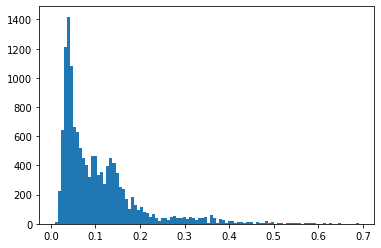

In [25]:
plt.hist(x = hybrid_clean['len'], bins = 100)

In [26]:
import numpy as np
from scipy.signal import argrelmin, argrelmax
import matplotlib.pyplot as plt

y = np.histogram(hybrid_clean['len'], bins = 100)[0]
x = np.histogram(hybrid_clean['len'], bins = 100)[1]

# find local minima and maxima
min_idx = argrelmin(y)
print("Indices of minima: {0}".format(min_idx))
print("Minima: {0}".format(y[min_idx]))

max_idx = argrelmax(y)
print("Indices of maxima: {0}".format(max_idx))
print("Maxima: {0}".format(y[max_idx]))

Indices of minima: (array([11, 14, 16, 24, 27, 31, 34, 37, 40, 43, 46, 48, 50, 53, 56, 59, 62,
       65, 68, 70, 72, 75, 78, 81, 87, 89, 97]),)
Minima: [324 336 276 103  97  50  21  28  41  32  23  39   8   5   6   3   3   2
   4   6   1   1   3   2   1   2   0]
Indices of maxima: (array([ 4, 13, 15, 18, 25, 28, 32, 36, 39, 42, 44, 47, 49, 51, 54, 58, 60,
       63, 66, 69, 71, 74, 77, 79, 82, 88, 90, 93, 96]),)
Maxima: [1419  467  358  448  181  117   64   43   53   48   46   43   46   57
   30   18   13   12   13   16   11    8    8    6    7    5    4    3
    2]


In [27]:
len_minimum = x[min_idx[0][-4]]
len_minimum1 = x[min_idx[0][1]]

In [28]:
x[min_idx[0]]

array([0.08368802, 0.10417557, 0.11783393, 0.17246737, 0.19295491,
       0.22027163, 0.24075917, 0.26124671, 0.28173425, 0.30222179,
       0.32270933, 0.33636769, 0.35002605, 0.37051359, 0.39100113,
       0.41148867, 0.43197621, 0.45246375, 0.47295129, 0.48660965,
       0.50026801, 0.52075555, 0.54124309, 0.56173063, 0.60270571,
       0.61636407, 0.67099751])

## Plot intergap ratio predicted by note length, minima represented by the dashed line. 

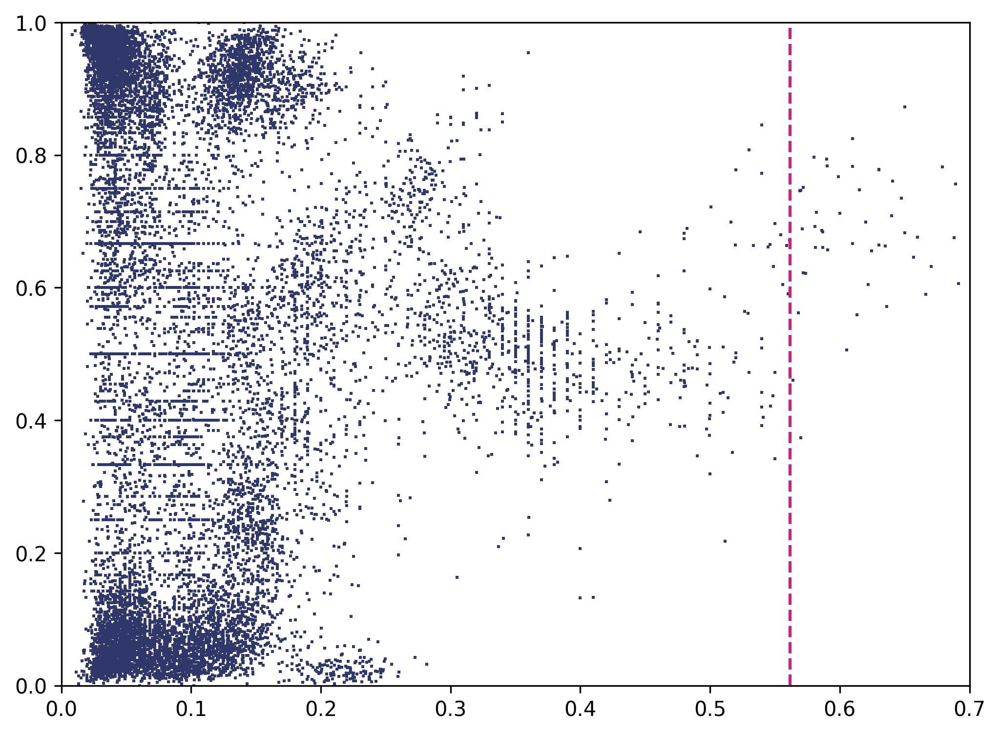

In [29]:
figure(figsize=(8, 6), dpi=300)
plt.scatter(x = hybrid_clean['len'], y = hybrid_clean['ratio'], marker = ",", lw = 0, s = 2, alpha = 1, color = '#30376B')
plt.xlim([0, 0.7])
plt.ylim([0, 1])
plt.axvline(x = x[min_idx[0][-4]], label = 'axvline - full height', linestyle='--', color = '#C8247E', alpha = 1)
plt.savefig(FIGURE_DIR/'intergapratio_cutoff_constrained.pdf')
plt.show()

## test correlation?

In [30]:
f = 'ratio~len'
ratiomodel = ols(formula=f, data=hybrid_clean).fit()

In [31]:
ratiomodel.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  ratio   R-squared:                       0.002
Model:                            OLS   Adj. R-squared:                  0.002
Method:                 Least Squares   F-statistic:                     26.60
Date:                Fri, 29 Jul 2022   Prob (F-statistic):           2.54e-07
Time:                        11:31:04   Log-Likelihood:                -5241.2
No. Observations:               13729   AIC:                         1.049e+04
Df Residuals:                   13727   BIC:                         1.050e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.5314      0.005    114.235      0.000       0.522       0.541
len           -0.1725      0.033     -5.158      0.000      -0.238      -0.107
==============================================================================
Omnibus:                    73696.955   Durbin-Watson:                   3.034
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             1407.572
Skew:                          -0.107   Prob(JB):                    2.24e-306
Kurtosis:                       1.446   Cond. No.                         11.2
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [32]:
filteredmodel = ols(formula=f, data = hybrid_clean[hybrid_clean['len']> len_minimum]).fit()

In [33]:
filteredmodel.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  ratio   R-squared:                       0.020
Model:                            OLS   Adj. R-squared:                 -0.001
Method:                 Least Squares   F-statistic:                    0.9440
Date:                Fri, 29 Jul 2022   Prob (F-statistic):              0.336
Time:                        11:31:04   Log-Likelihood:                 45.857
No. Observations:                  48   AIC:                            -87.71
Df Residuals:                      46   BIC:                            -83.97
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.4602      0.230      1.999      0.052      -0.003       0.924
len            0.3633      0.374      0.972      0.336      -0.389       1.116
==============================================================================
Omnibus:                        6.538   Durbin-Watson:                   1.718
Prob(Omnibus):                  0.038   Jarque-Bera (JB):                5.386
Skew:                          -0.732   Prob(JB):                       0.0677
Kurtosis:                       3.741   Cond. No.                         37.5
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

## test heteroscedasticity

In [34]:
f = 'ratio~len'
prop_model = ols(formula=f, data=hybrid_clean).fit()
labels = ['LM Statistic', 'LM-Test p-value', 'F-Statistic', 'F-Test p-value']
postwhite = het_white(postmodel.resid, postmodel.model.exog)
print(dict(zip(labels, postwhite)))

{'LM Statistic': 0.9793699315449361, 'LM-Test p-value': 0.6128194228709989, 'F-Statistic': 0.48962139144322553, 'F-Test p-value': 0.6128678243171608}


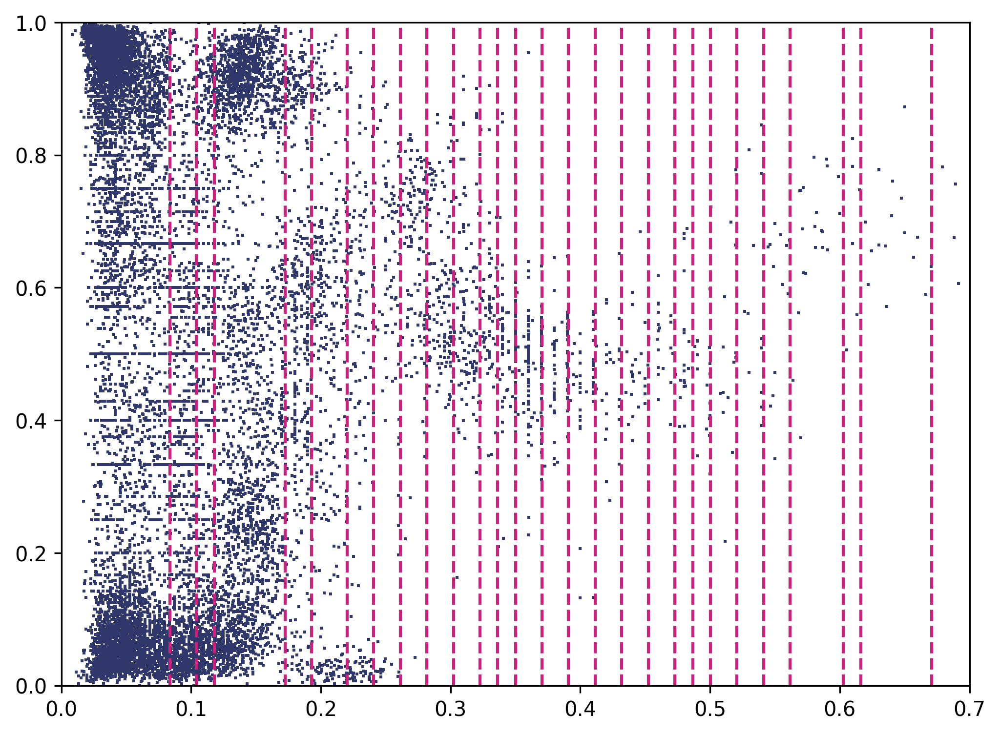

In [35]:
figure(figsize=(8, 6), dpi=300)
plt.scatter(x = hybrid_clean['len'], y = hybrid_clean['ratio'], marker = ",", lw = 0, s = 2, alpha = 1, color = '#30376B')
plt.xlim([0, 0.7])
plt.ylim([0, 1])
for mini in x[min_idx[0]]:
    plt.axvline(x = mini, label = 'axvline - full height', linestyle='--', color = '#C8247E', alpha = 1)
plt.savefig(FIGURE_DIR/'intergapratio_lines.pdf')
plt.show()

## output dyadic with len information

In [36]:
import butcherbird.rhythm

/home/AD/j8xing/syntax_rhythm_pbb/butcherbird/rhythm.py:151: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  from tqdm.autonotebook import tqdm


In [37]:
## modified dyadic to have len info as well

def construct_rhythm_df(onsets, lengths, syntactic_units, expected_interval_range):
    '''
    This function transforms a list of onsets and list of syntactic units for rhythm analyses
    '''
    
    ### DISCOVER ALL INTER-ONSET INTERVALS
    ## Use counter design
    i = 0
    intervals = []
    
    
    ## for every note onset
    for onset in onsets:
        
        ## if at last note, exit for loop
        if i == (len(onsets) - 1):
            continue
        
        ## interval = next onset - current onset, add to interval list
        interval = onsets[i + 1] - onsets[i]
        intervals.append(interval)
        
        ## counter up
        i = i + 1
        
    ## Collect intervals into dyadic formation
    
    ## interval 1 does not include last interval
    intervals1 = list(intervals)
    del(intervals1[-1])
    
    ## interval 2 does not include first interval
    intervals2 = list(intervals)
    del(intervals2[0])
    
    ## Put intervals into datafrmae
    d = {'intervals1': intervals1, 'intervals2': intervals2}
    dyadic = pd.DataFrame(data = d)
    
    ######## back propagate label information
    
    ## note identity 1 // Delete last two values
    labels1 = list(syntactic_units)
    del(labels1[-1])
    del(labels1[-1])
    
    ## note identity 2 // Delete first and last value
    labels2 = list(syntactic_units)
    del(labels2[0])
    del(labels2[-1])
    
    ## note identity 3 // Delete first two values
    labels3 = list(syntactic_units)
    del(labels3[0])
    del(labels3[0])
    
    ## fill
    dyadic['label1'] = labels1
    dyadic['label2'] = labels2
    dyadic['label3'] = labels3
    
    ######### backpropagate length information
    
    ## note identity 1 // Delete last two values
    len1 = list(lengths)
    del(len1[-1])
    del(len1[-1])
    
    ## note identity 2 // Delete first and last value
    len2 = list(lengths)
    del(len2[0])
    del(len2[-1])
    
    ## note identity 3 // Delete first two values
    len3 = list(lengths)
    del(len3[0])
    del(len3[0])
    
    ## fill
    dyadic['len1'] = len1
    dyadic['len2'] = len2
    dyadic['len3'] = len3
    
    ## Sort dyadic into short/long interval
    ### sort all intervals and calculate necessary components
    s_interval = []
    l_interval = []
    cycle_dur = []
    ratio_custom = []
    ratio_roeske = []
    
    ## for every dyadic
    for index, row in dyadic.iterrows():

        i1 = row['intervals1']
        i2 = row['intervals2']

        ## short long decider
        if i1 > i2:
            s = i2
            l = i1
        else:
            s = i1
            l = i2
            
        ## calculate components
        s_interval.append(s)
        l_interval.append(l)
        cycle_dur.append(s + l)
        ratio_roeske.append(i1/(i1+i2))
        ratio_custom.append(s/l)

    ## push into dyadic
    dyadic['s_interval'] = s_interval
    dyadic['l_interval'] = l_interval
    dyadic['cycle_dur'] = cycle_dur
    dyadic['ratio_roeske'] = ratio_roeske
    dyadic['ratio_custom'] = ratio_custom
    
    ## sort ascending by shortest cycle to longest cycle
    dyadic = dyadic.sort_values(by = ['cycle_dur'])
    
    ## filter out transition between phrases
    dyadic = dyadic[dyadic['l_interval'] < expected_interval_range[1]]
    dyadic = dyadic[dyadic['s_interval'] > expected_interval_range[0]]
    
    ## put cycle rank into data frame
    dyadic['cycle_rank'] = dyadic['cycle_dur'].rank().astype(int)
    
    return dyadic

In [38]:
dyadic = construct_rhythm_df(
    onsets = note_df['note_strt'], 
    lengths = note_df['note_len'],
    syntactic_units = note_df['lasso_labels'], 
    expected_interval_range = [0, 1]
)

In [39]:
dyadic

,intervals1,intervals2,label1,label2,label3,len1,len2,len3,s_interval,l_interval,cycle_dur,ratio_roeske,ratio_custom,cycle_rank
6572,0.036773,0.003309,14,48,25,0.036773,0.003309,0.107575,0.003309,0.036773,0.040083,0.917441,0.089989,1
1010,0.034970,0.005312,30,48,2,0.034970,0.005312,0.090756,0.005312,0.034970,0.040282,0.868121,0.151913,2
72,0.039629,0.001440,14,48,11,0.039629,0.001440,0.051921,0.001440,0.039629,0.041068,0.964946,0.036327,3
12132,0.045232,0.011358,45,45,28,0.045232,0.011358,0.078019,0.011358,0.045232,0.056590,0.799288,0.251113,4
6555,0.022714,0.034077,6,6,50,0.022241,0.011361,0.126834,0.022714,0.034077,0.056791,0.399952,0.666534,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12402,0.411473,0.858550,51,32,41,0.171216,0.548550,0.400000,0.411473,0.858550,1.270023,0.323989,0.479265,13789
3,0.734433,0.537019,31,48,14,0.689217,0.304964,0.043540,0.537019,0.734433,1.271452,0.577633,0.731202,13790
8044,0.460000,0.820000,51,32,41,0.157714,0.520000,0.420000,0.460000,0.820000,1.280000,0.359375,0.560976,13791
8144,0.440000,0.875788,51,32,41,0.143105,0.440389,0.367250,0.440000,0.875788,1.315788,0.334400,0.502405,13792


## Calculate Uniform Rhythm
> Uniform rhythm is calculated under the assumption that interval lengths are uniformly distributed between a minimum and maximum interval length.  

In [40]:
import numpy as np
import numpy.random as random

In [41]:
interval_min = np.min([dyadic['intervals1'].values, dyadic['intervals2']])
interval_max = np.max([dyadic['intervals1'].values, dyadic['intervals2']])

In [42]:
interval1_uni = random.uniform(low = interval_min, high = interval_max, size = len(dyadic) * 1000)
interval2_uni = random.uniform(low = interval_min, high = interval_max, size = len(dyadic) * 1000)
uni_ratio = interval1_uni / (interval1_uni + interval2_uni)

<AxesSubplot:ylabel='Count'>

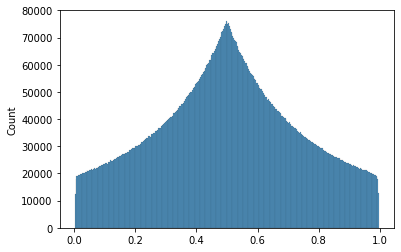

In [43]:
sns.histplot(uni_ratio)

## Output each dyadic below stratum, output its hopkins statistic, save a plot

Currently Processing below 
0.08368802484138087


  0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


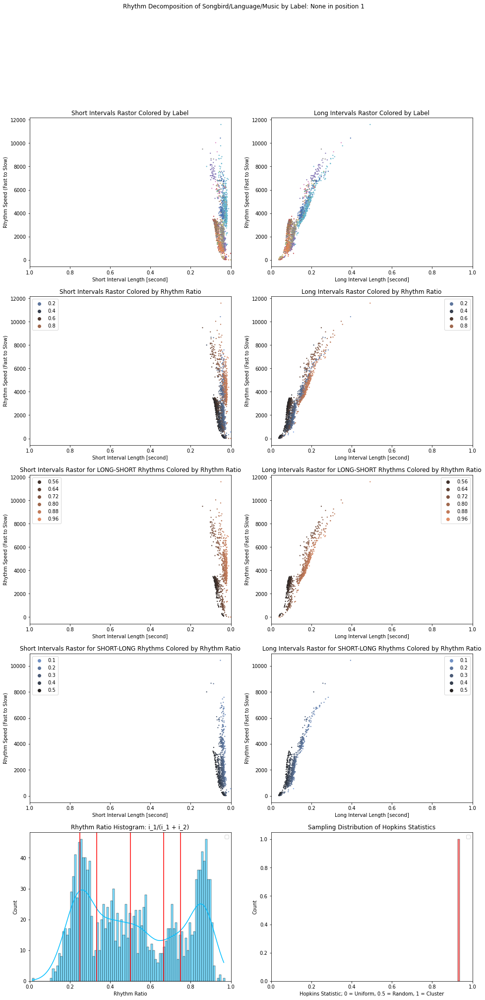

Currently Processing below 
0.10417556518920719


  0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


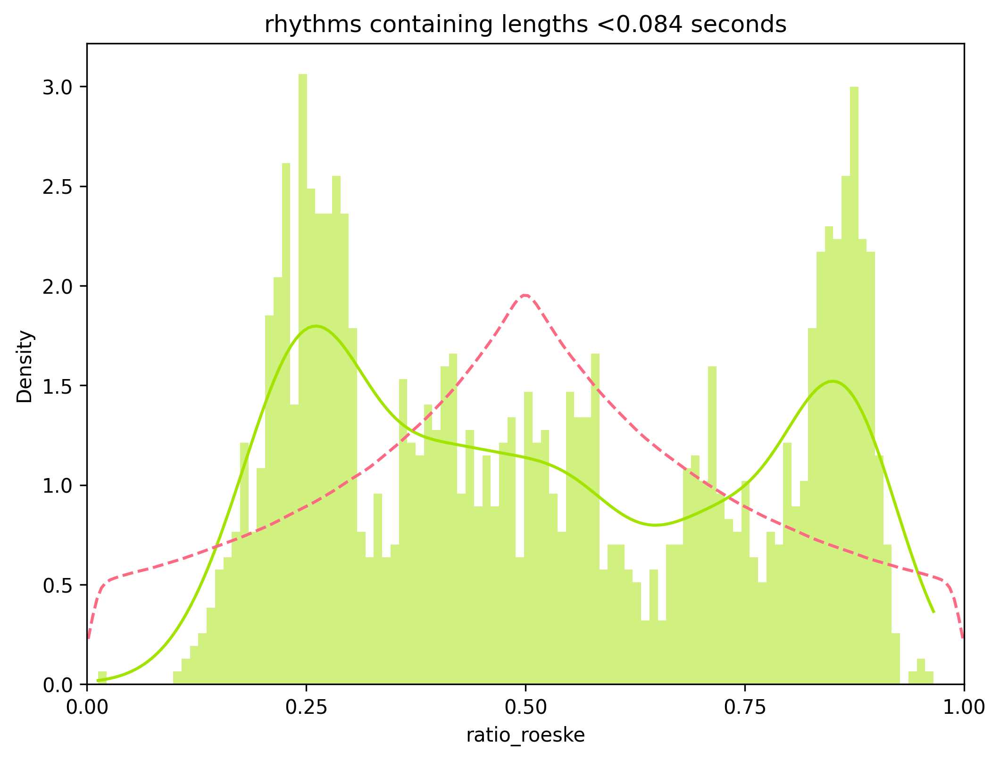

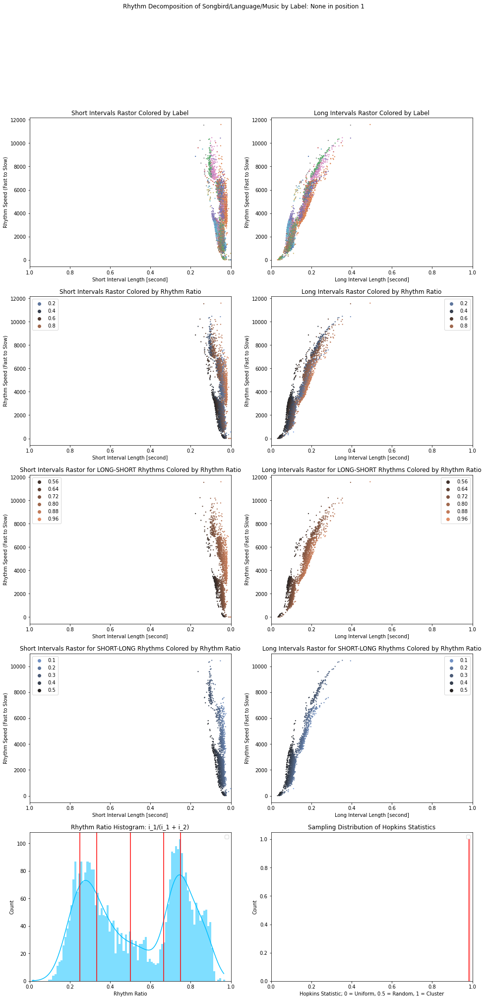

Currently Processing below 
0.1178339254210914


  0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


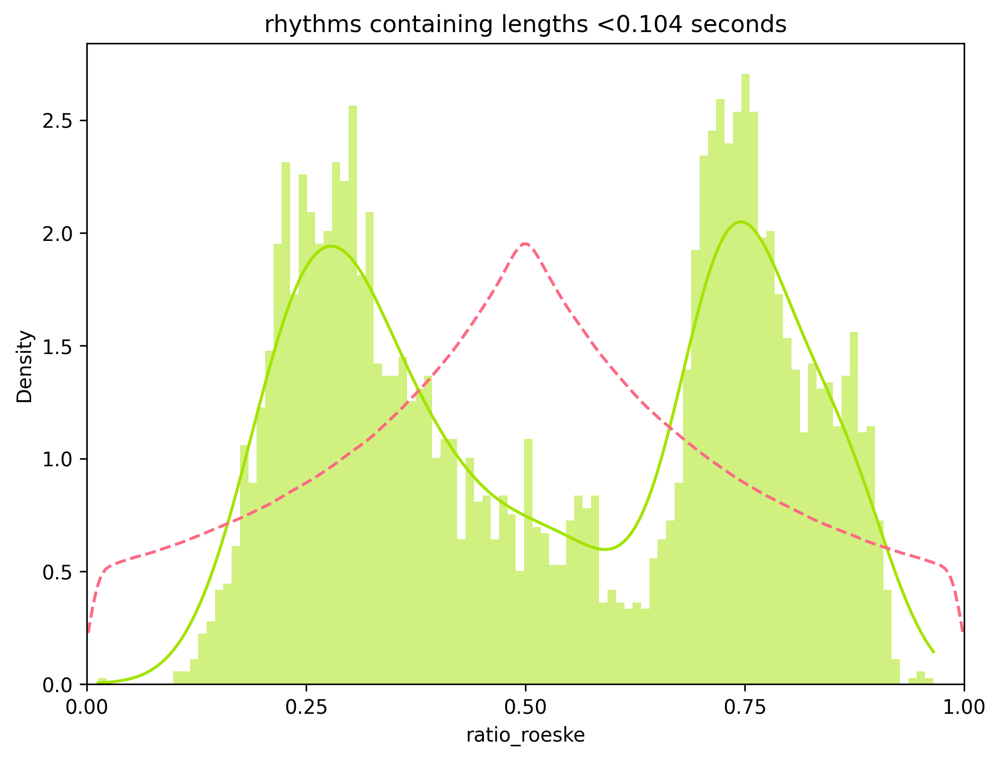

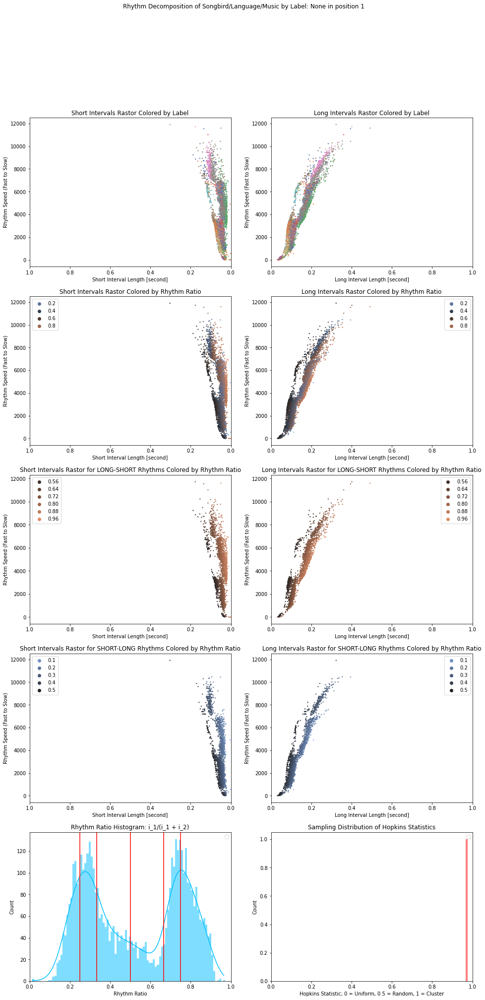

Currently Processing below 
0.17246736634862828


  0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


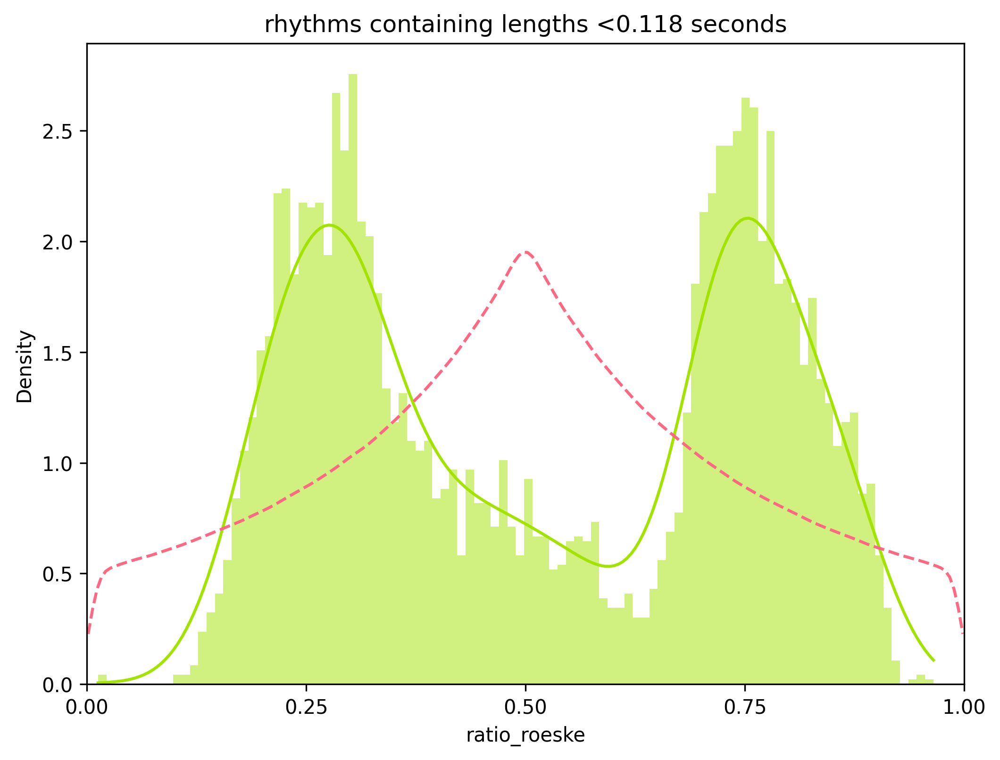

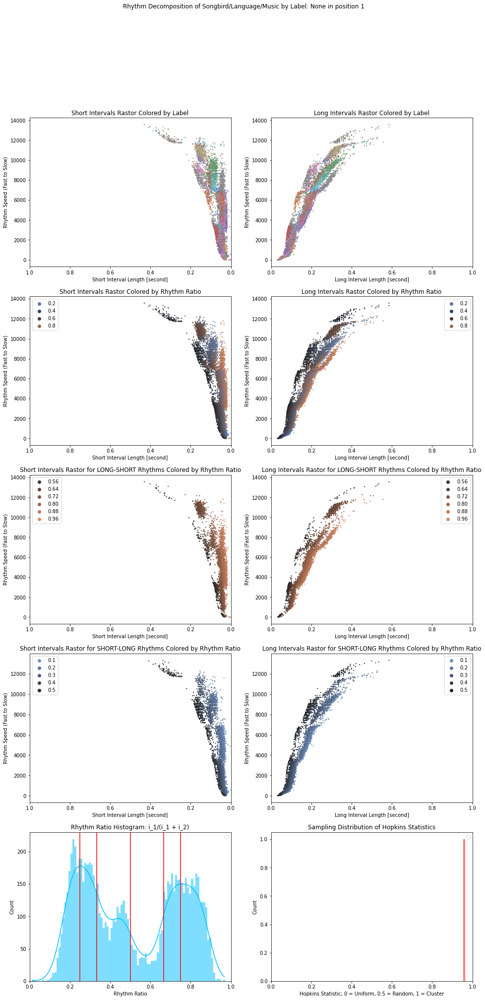

Currently Processing below 
0.1929549066964546


  0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


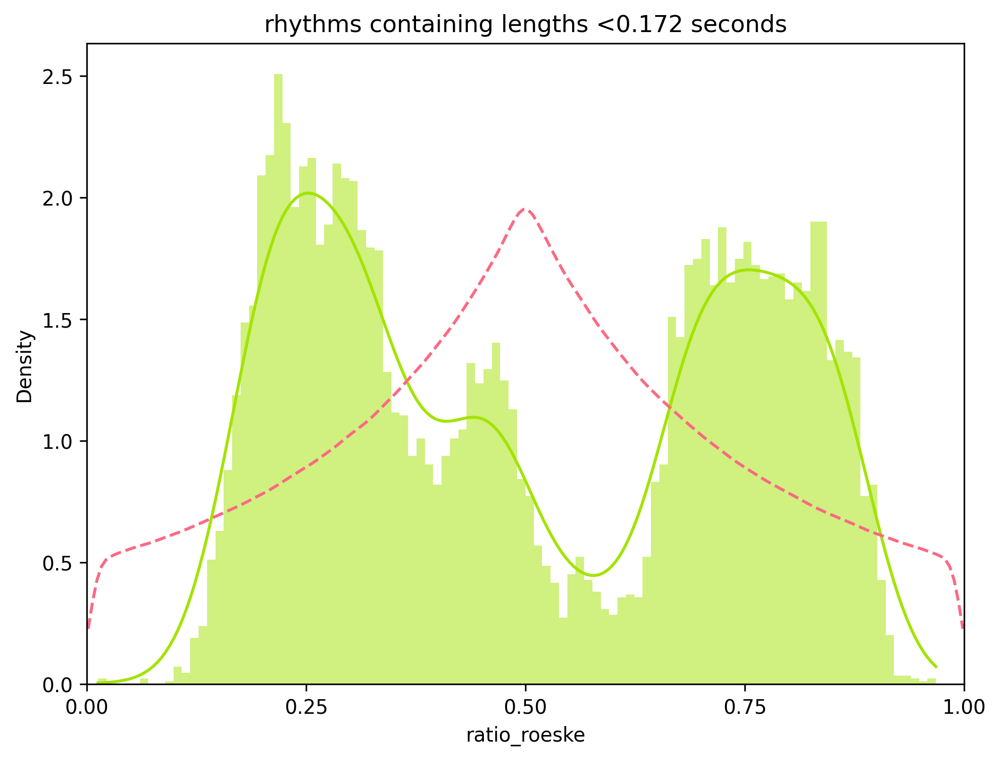

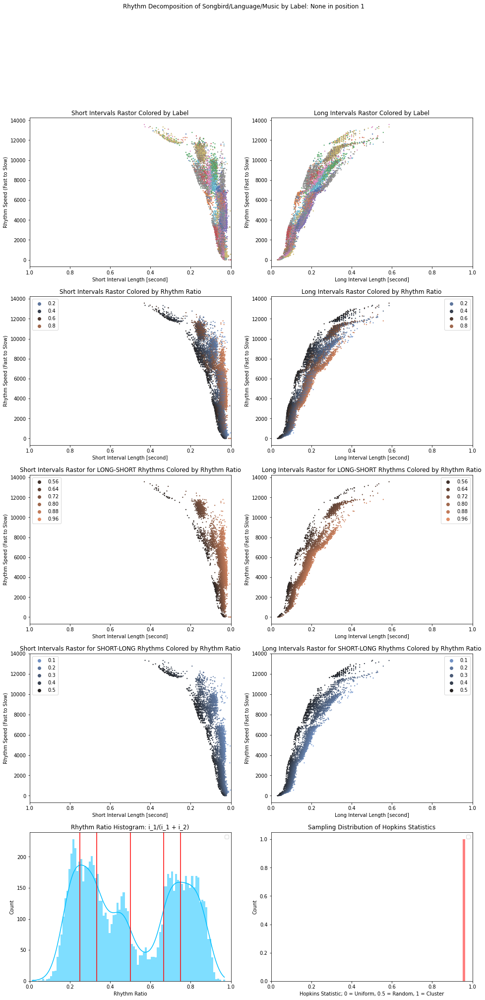

Currently Processing below 
0.22027162716022303


  0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


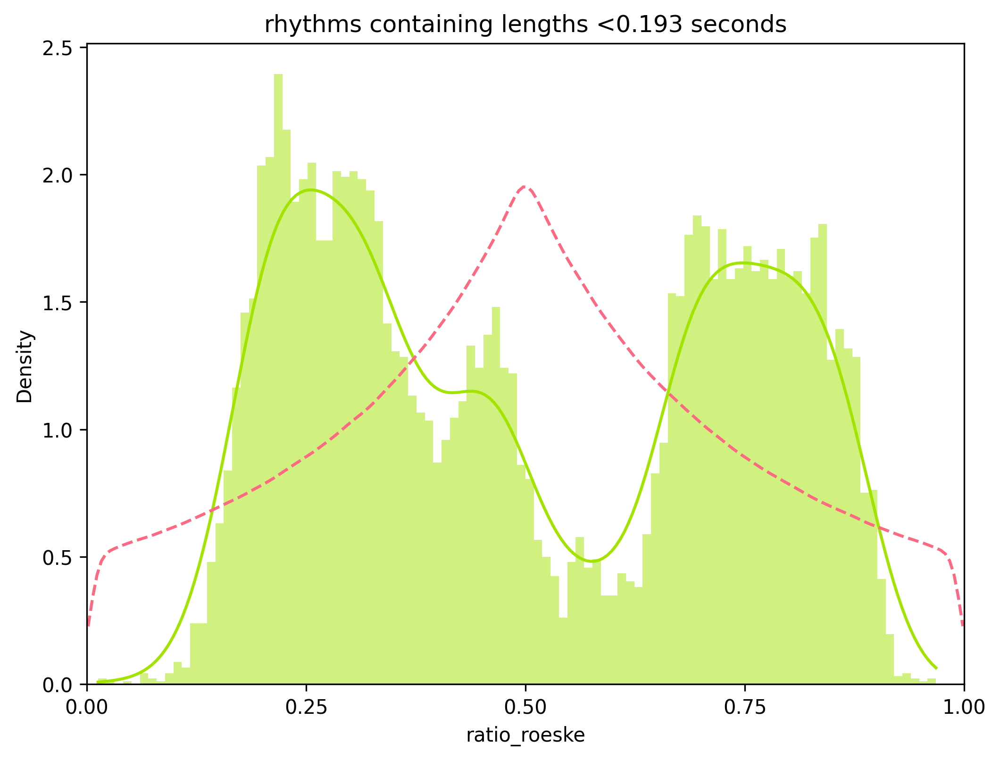

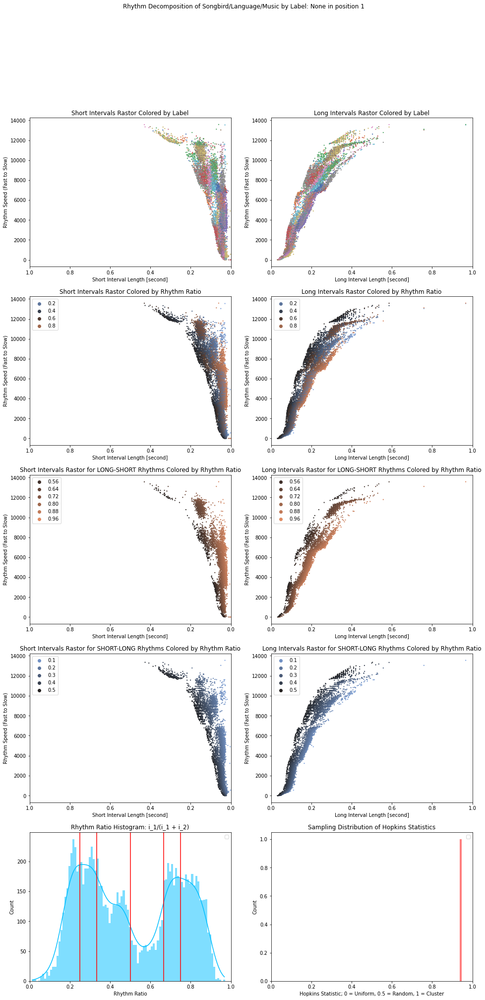

Currently Processing below 
0.24075916750804935


  0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


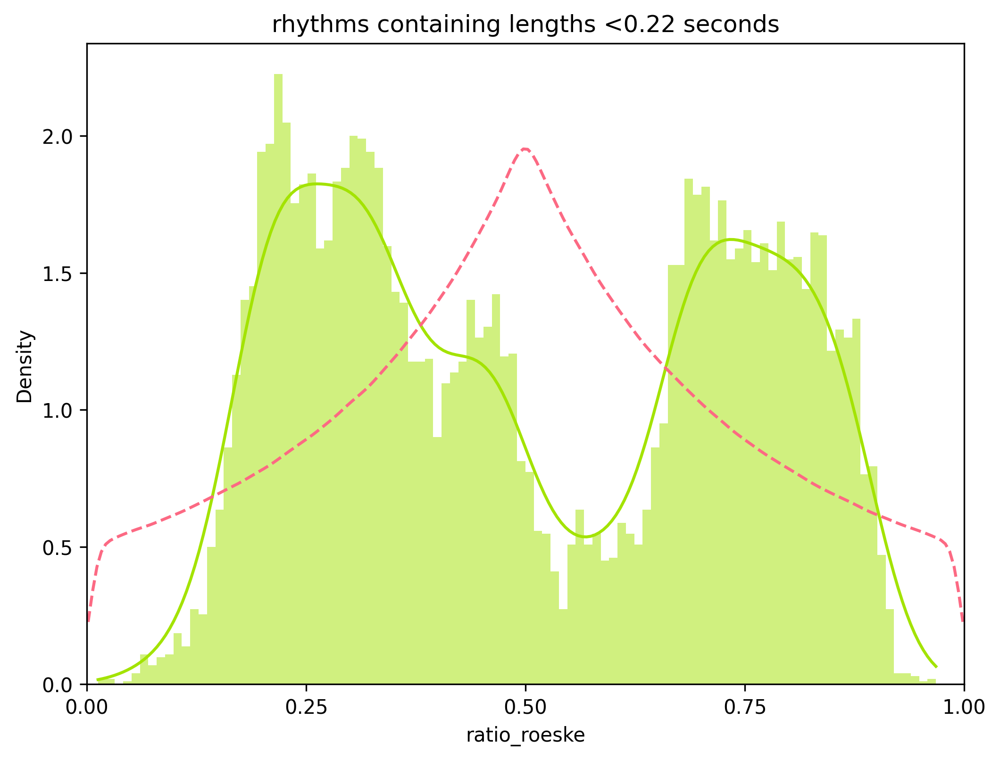

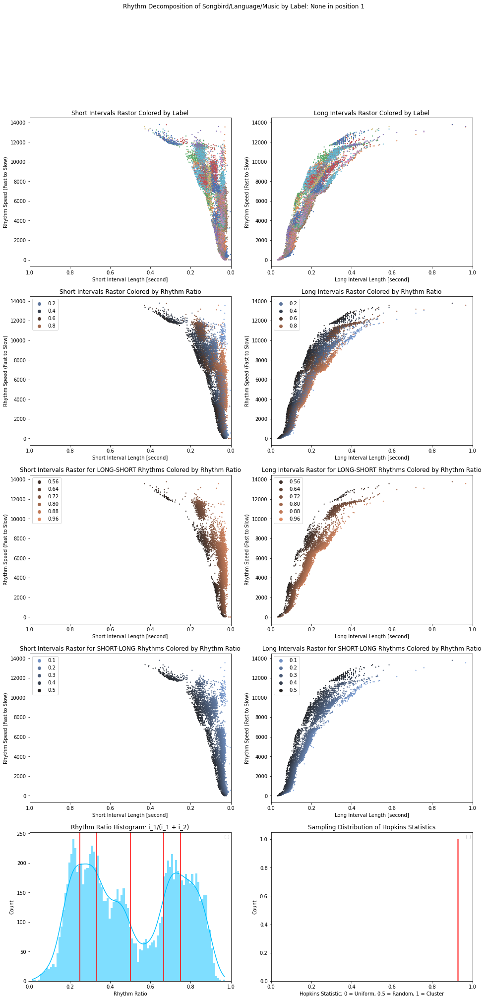

Currently Processing below 
0.26124670785587567


  0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


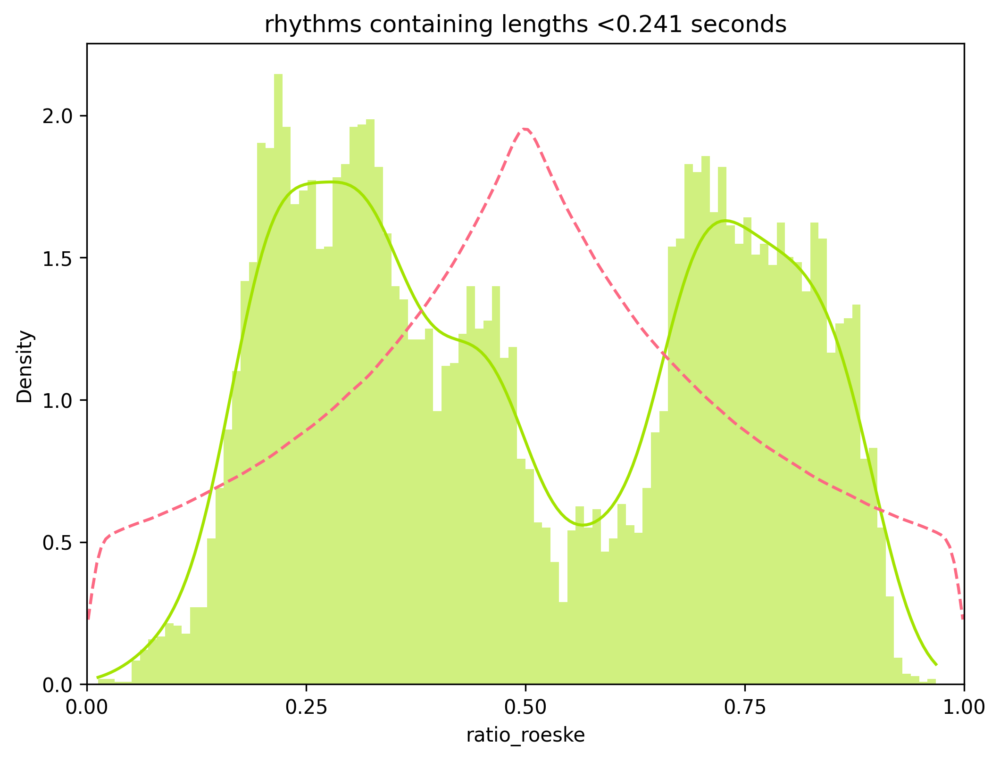

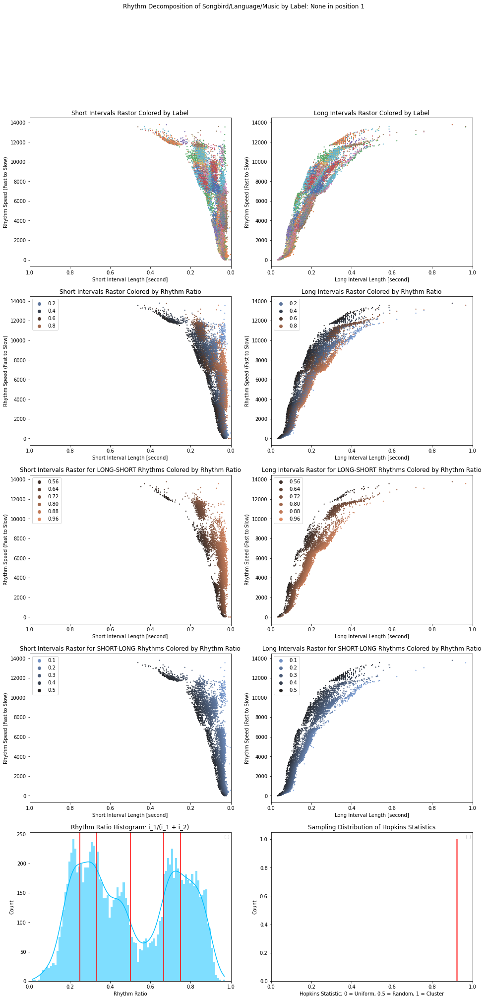

Currently Processing below 
0.281734248203702


  0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


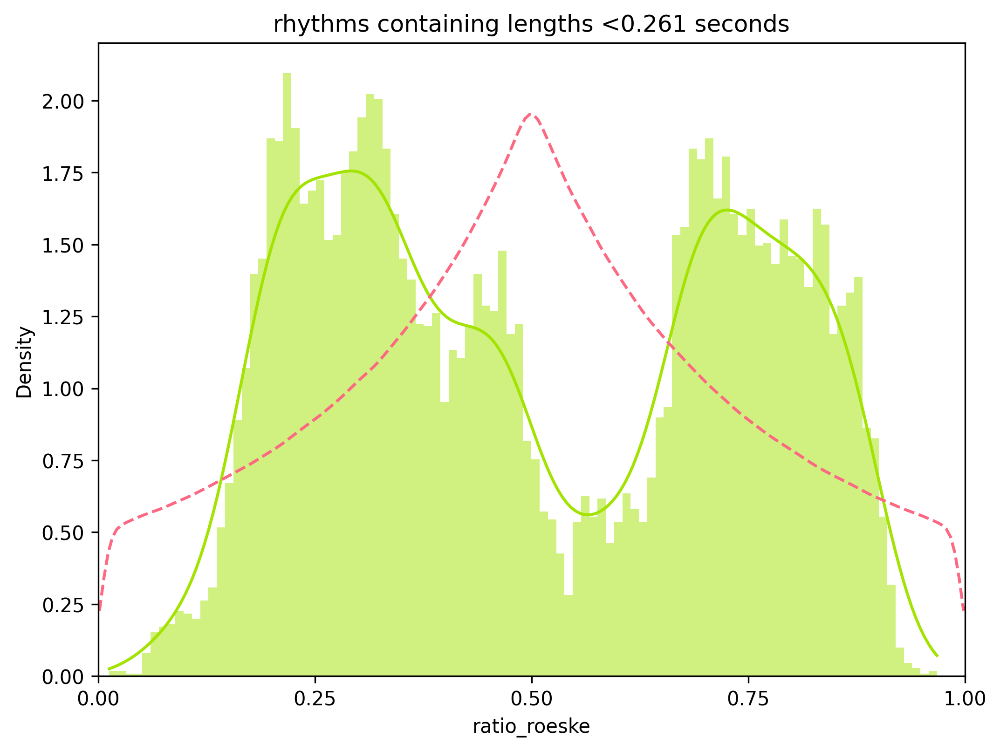

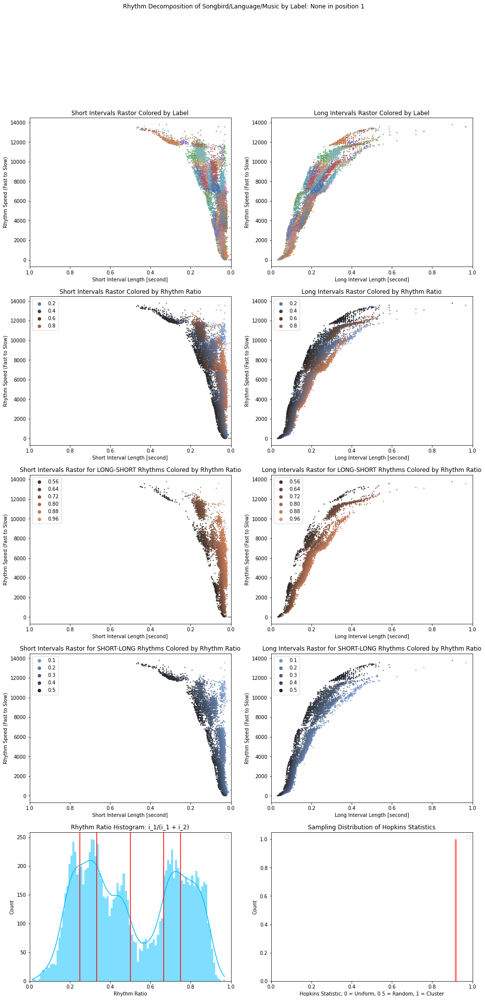

Currently Processing below 
0.3022217885515283


  0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


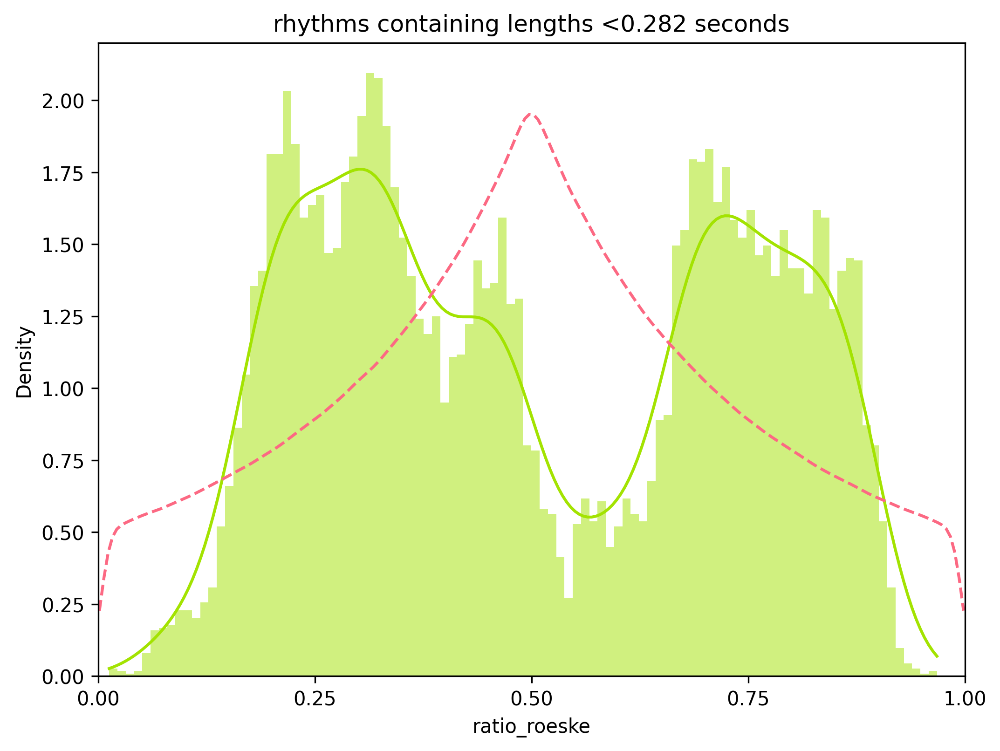

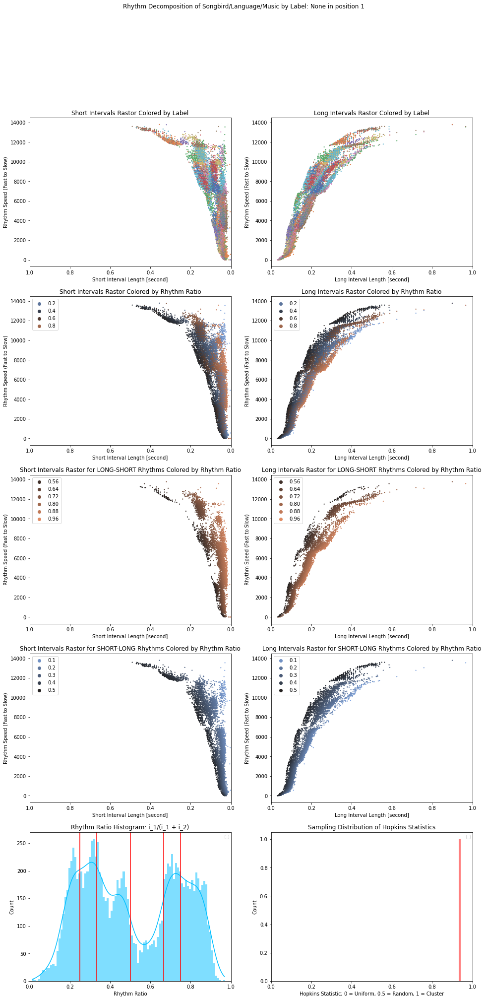

Currently Processing below 
0.32270932889935466


  0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


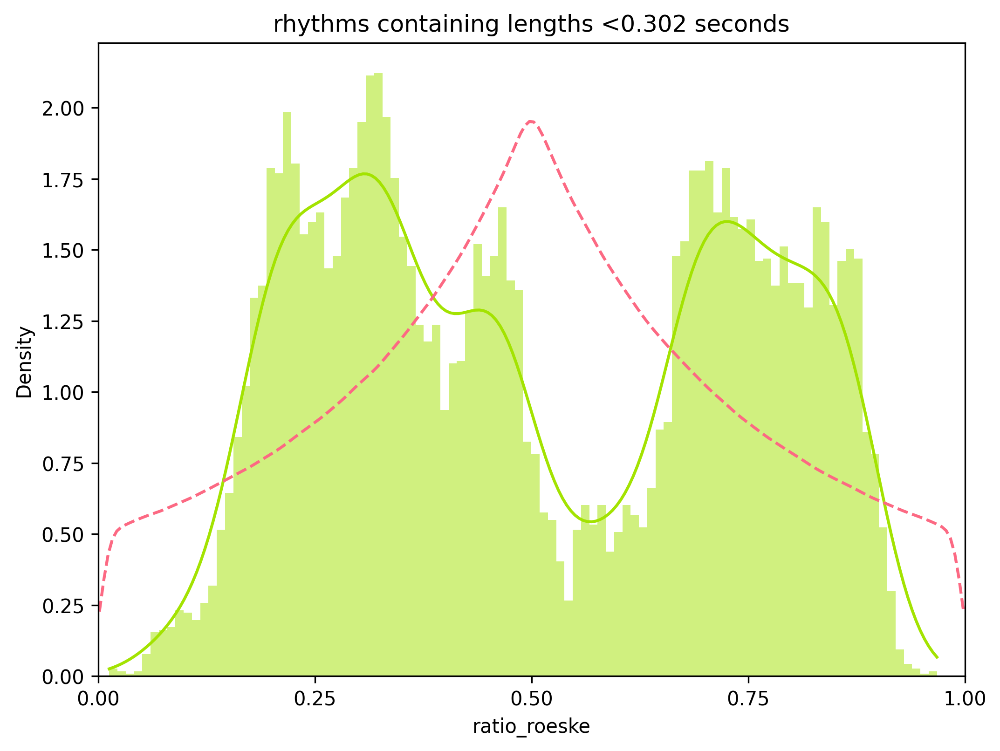

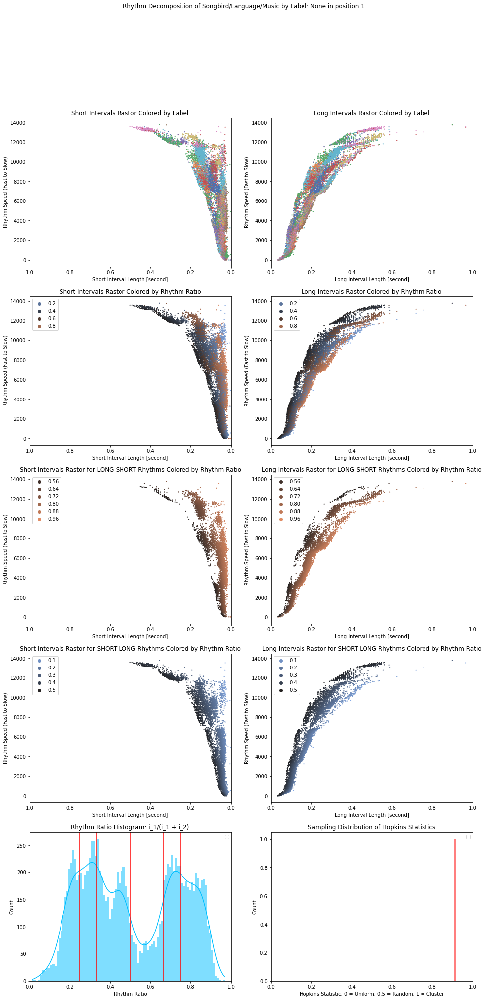

Currently Processing below 
0.3363676891312389


  0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


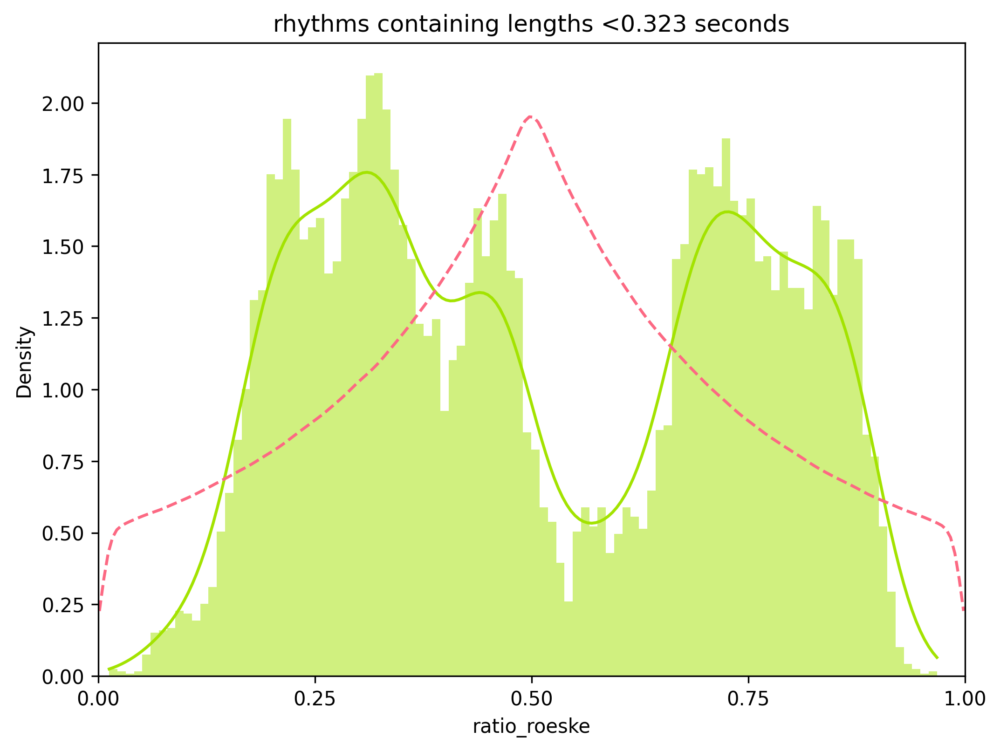

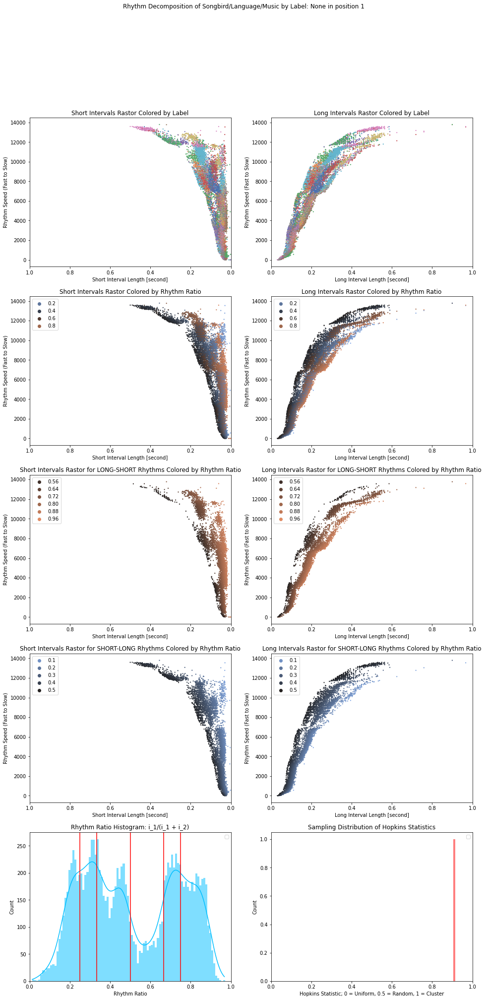

Currently Processing below 
0.3500260493631231


  0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


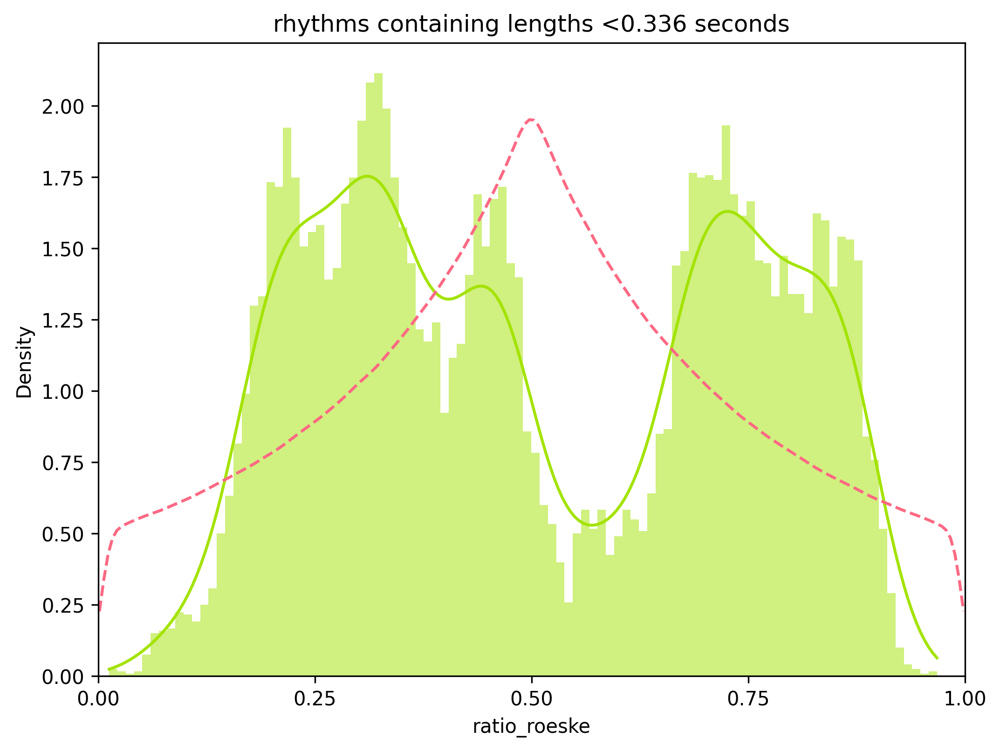

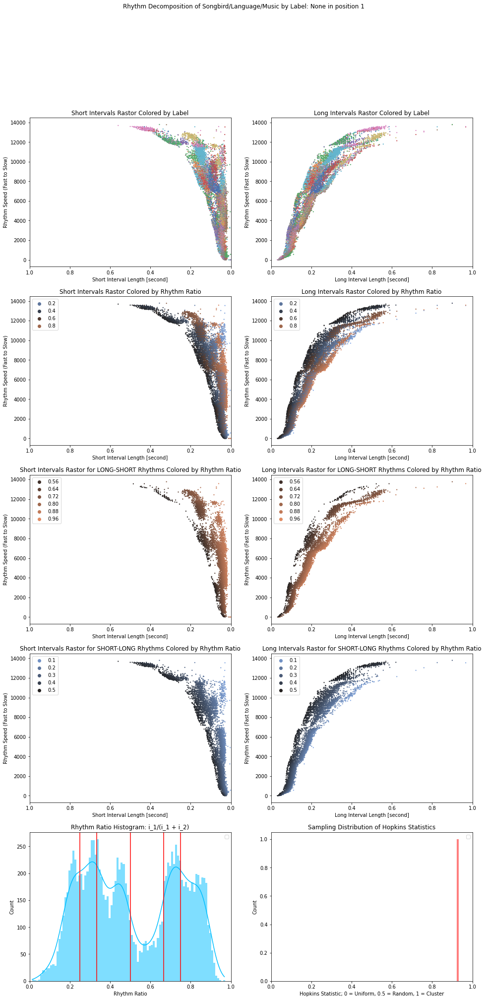

Currently Processing below 
0.3705135897109494


  0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


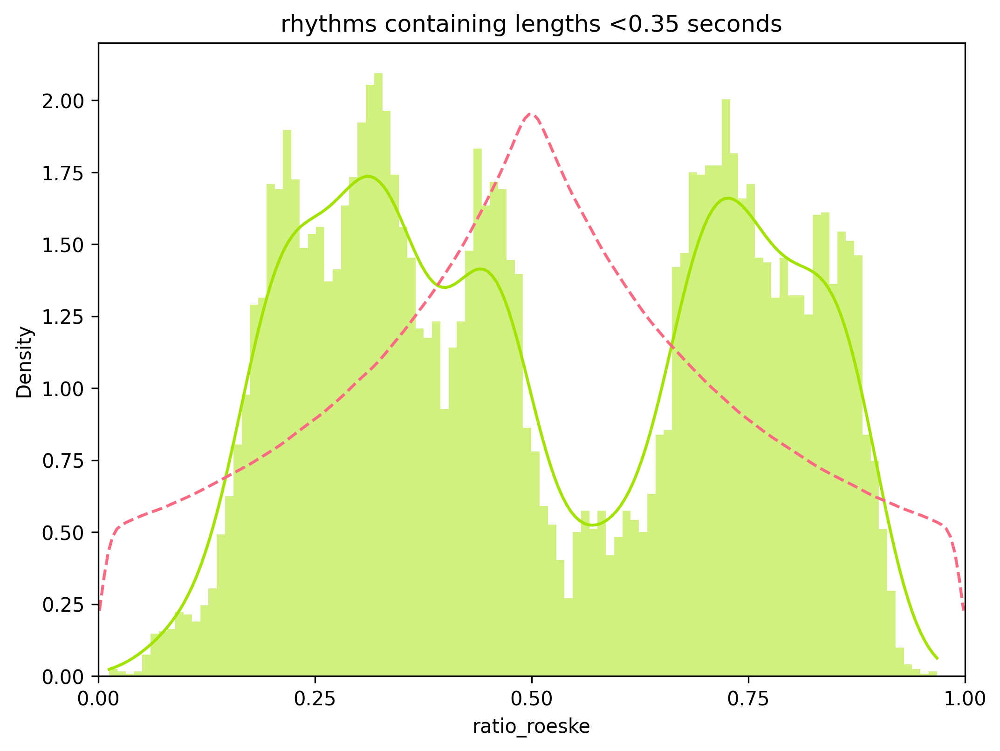

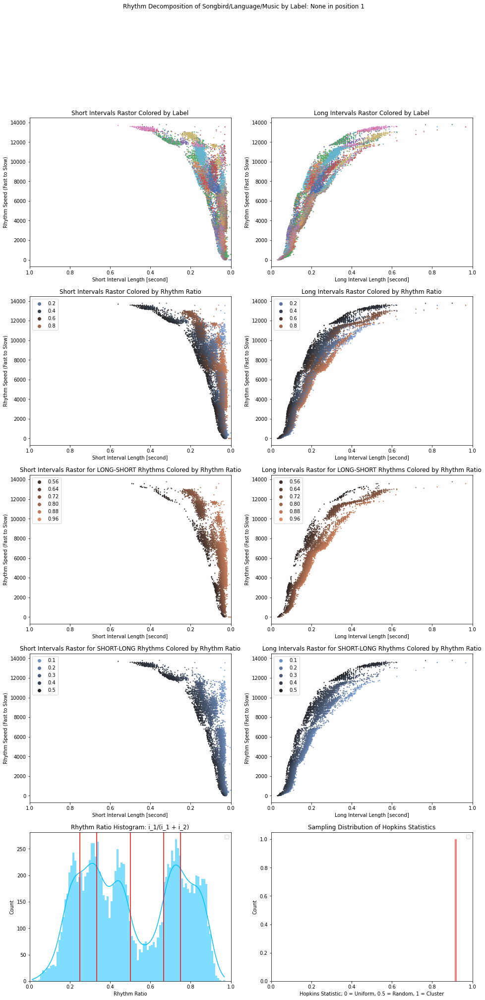

Currently Processing below 
0.39100113005877574


  0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


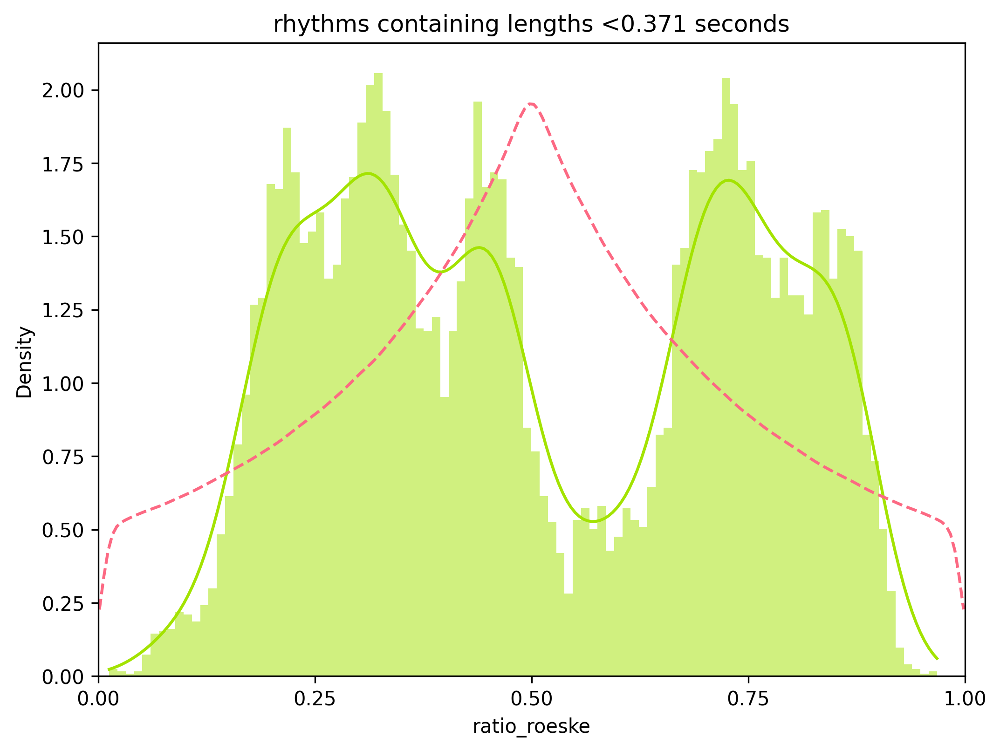

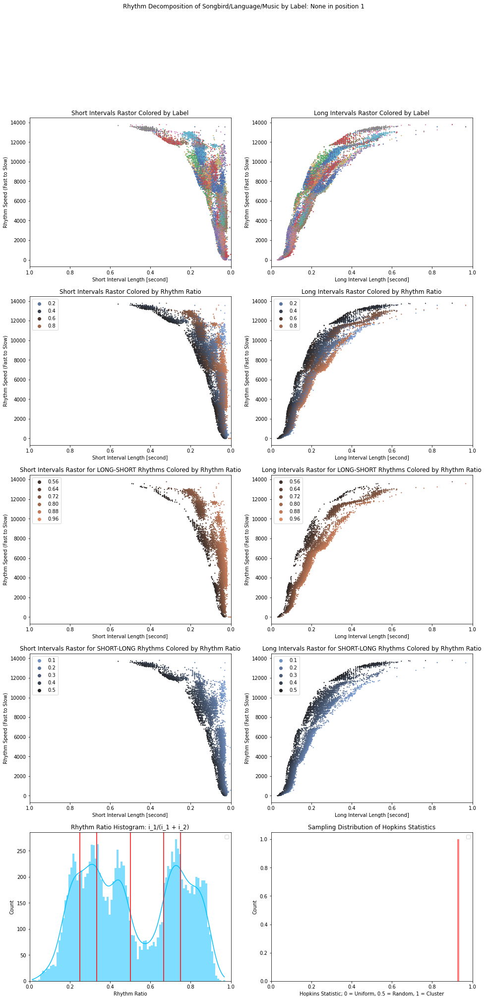

Currently Processing below 
0.41148867040660203


  0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


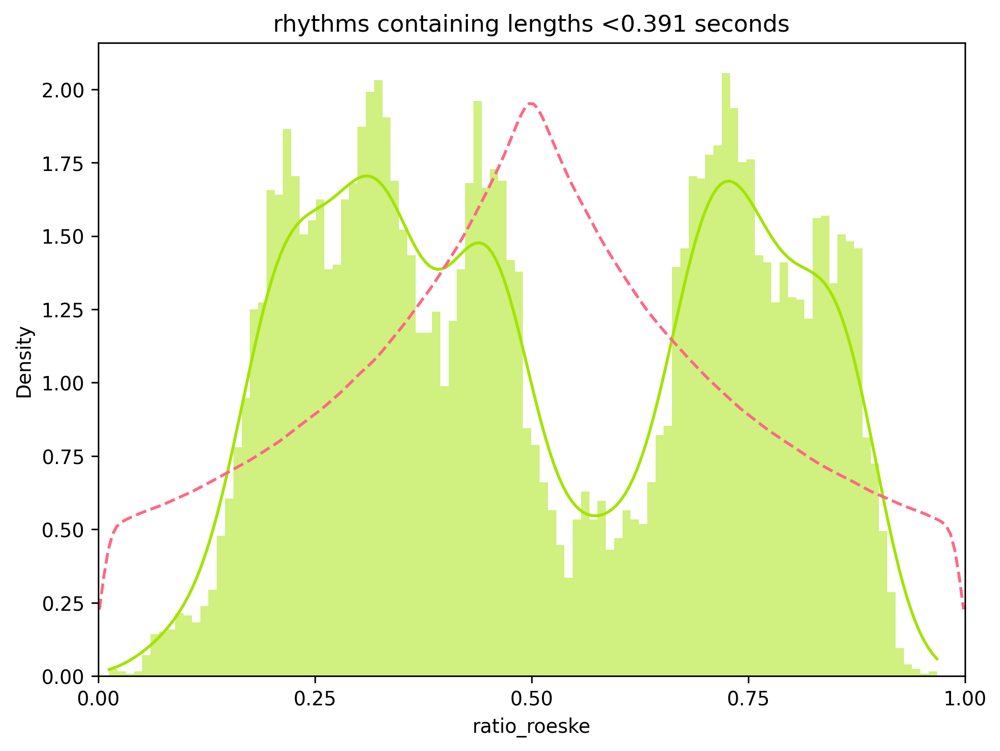

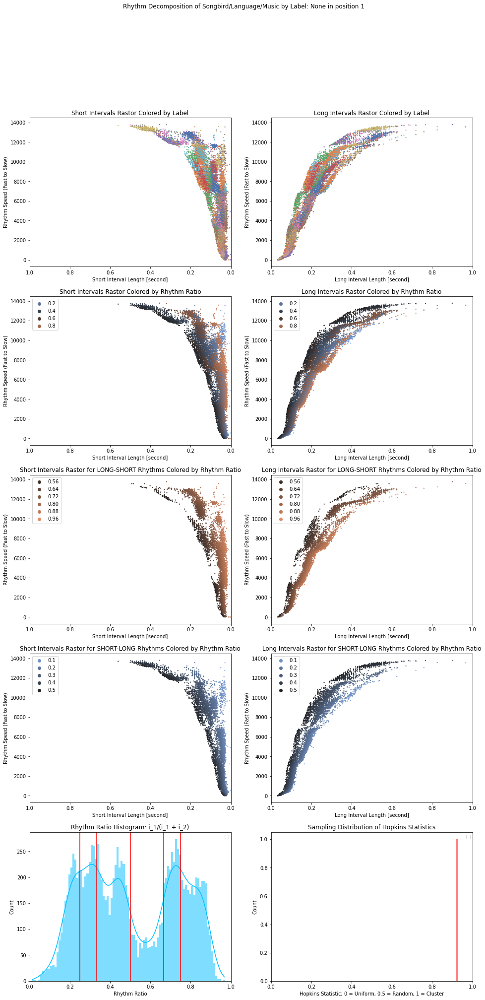

Currently Processing below 
0.4319762107544284


  0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


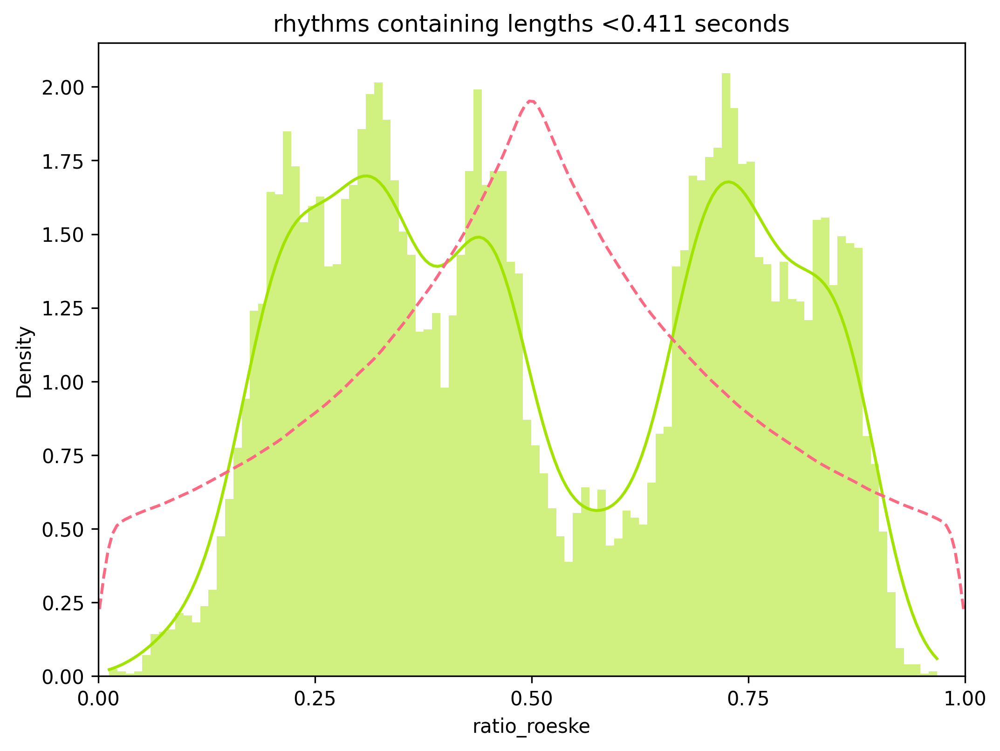

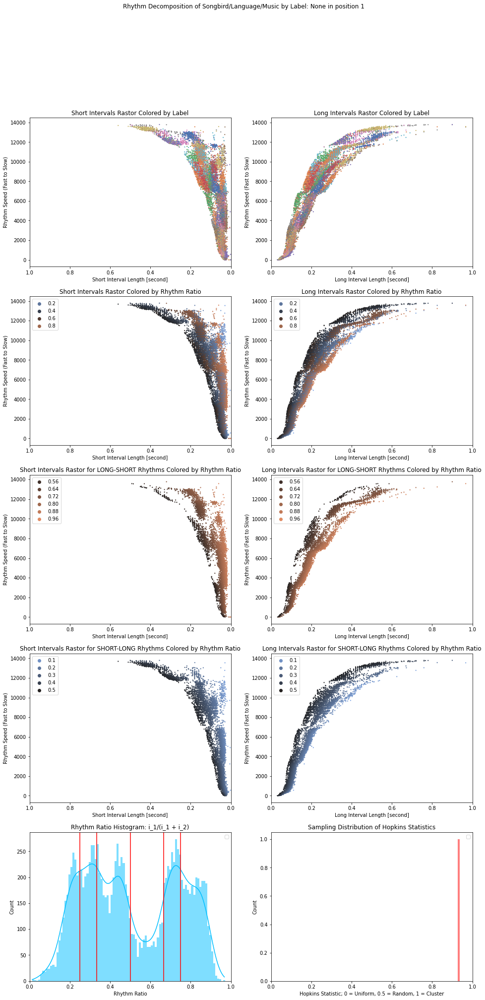

Currently Processing below 
0.45246375110225473


  0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


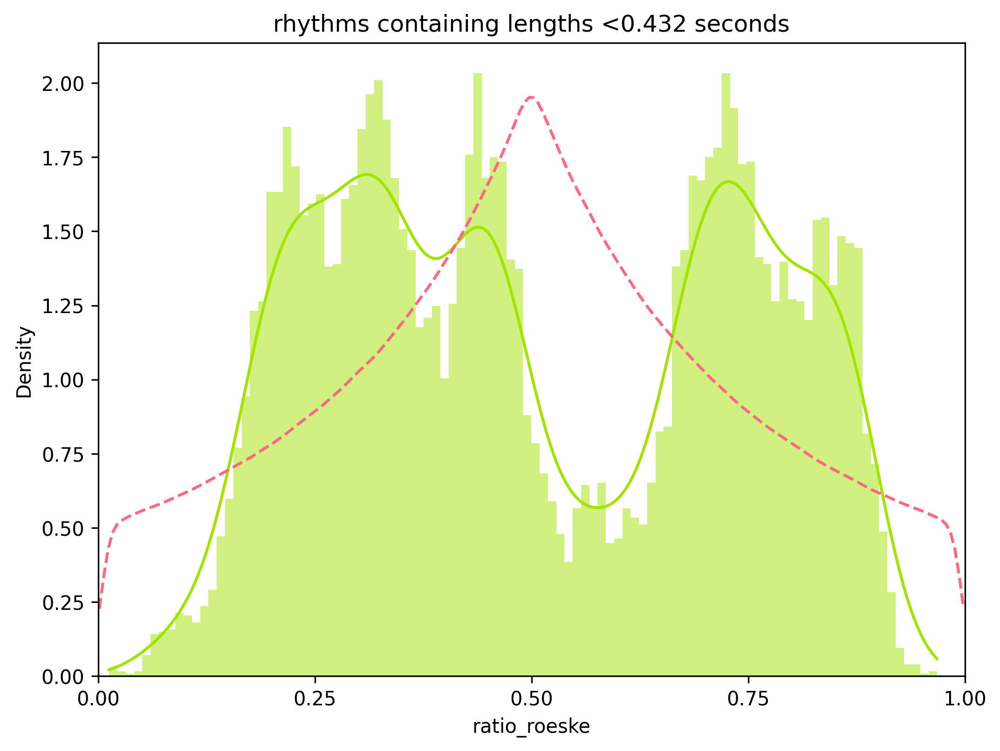

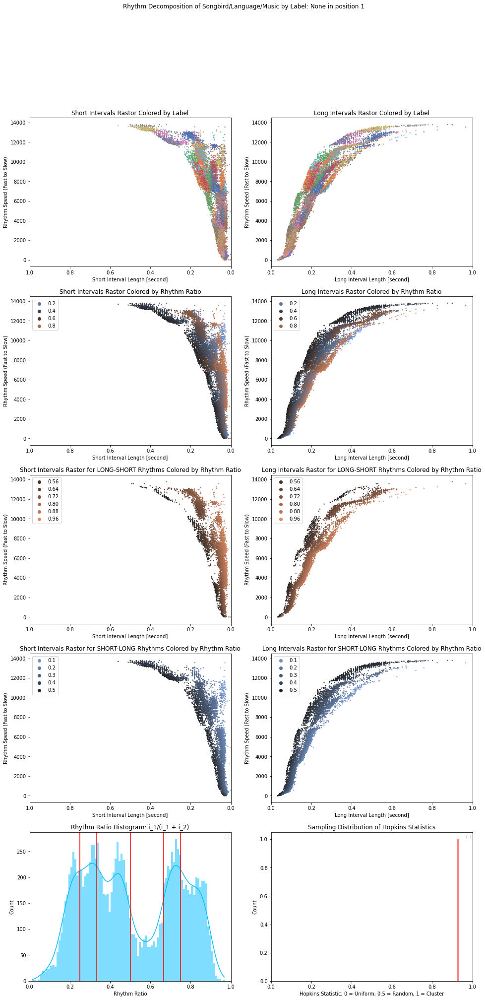

Currently Processing below 
0.472951291450081


  0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


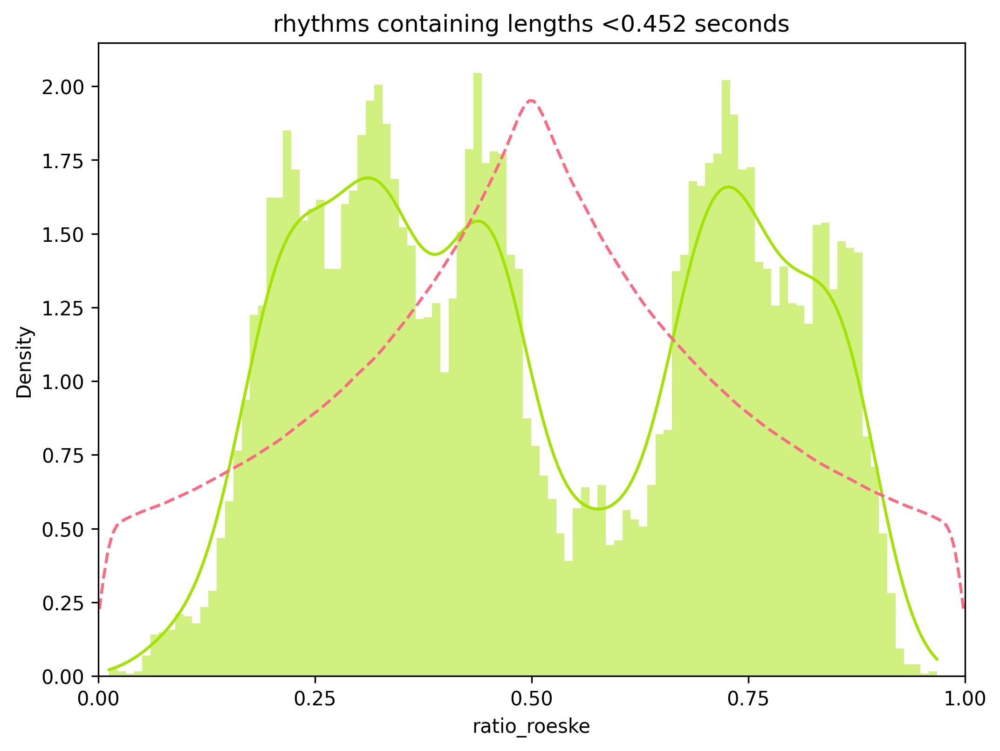

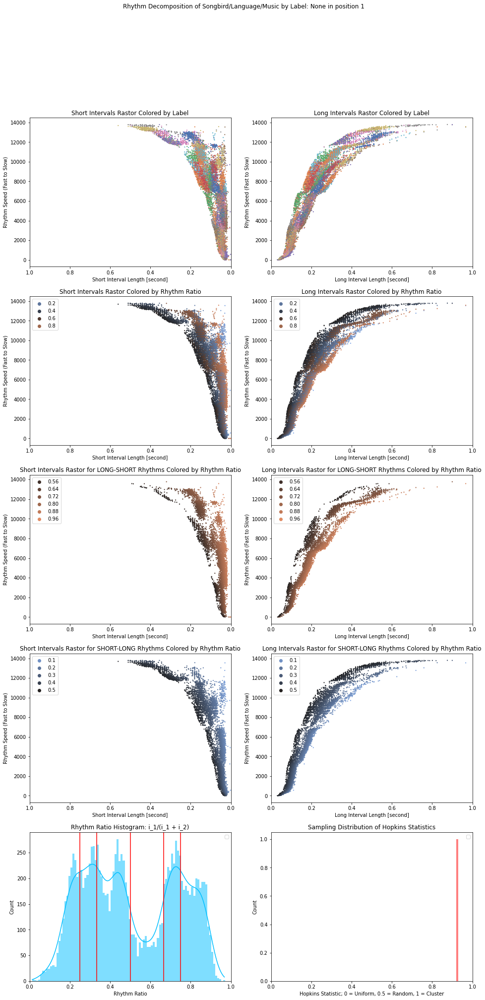

Currently Processing below 
0.48660965168196524


  0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


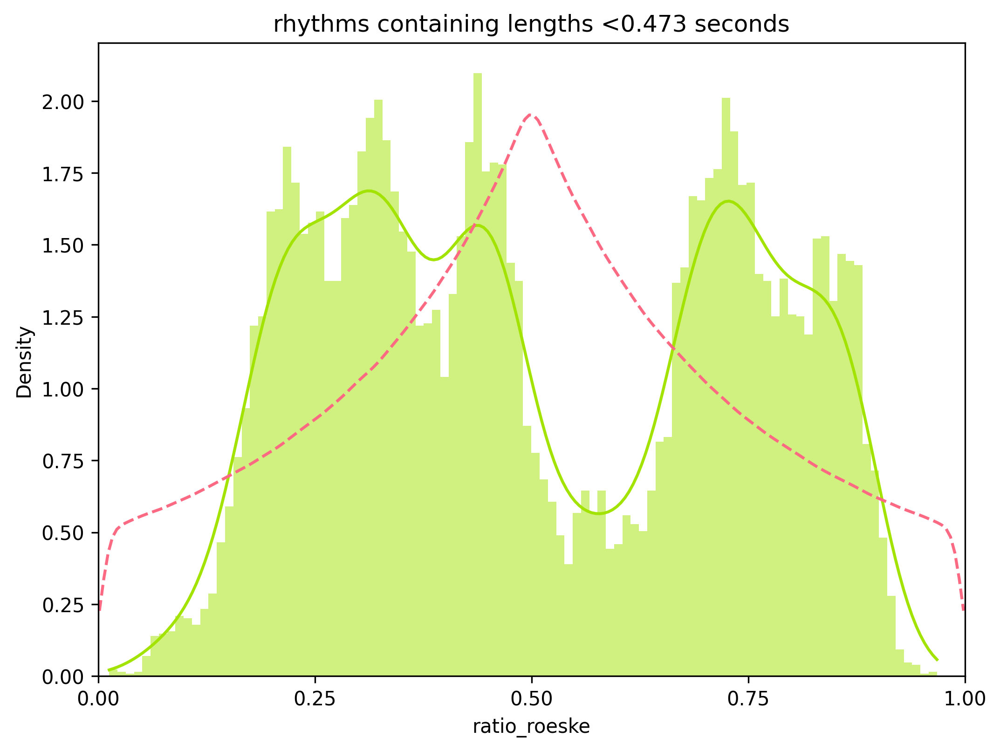

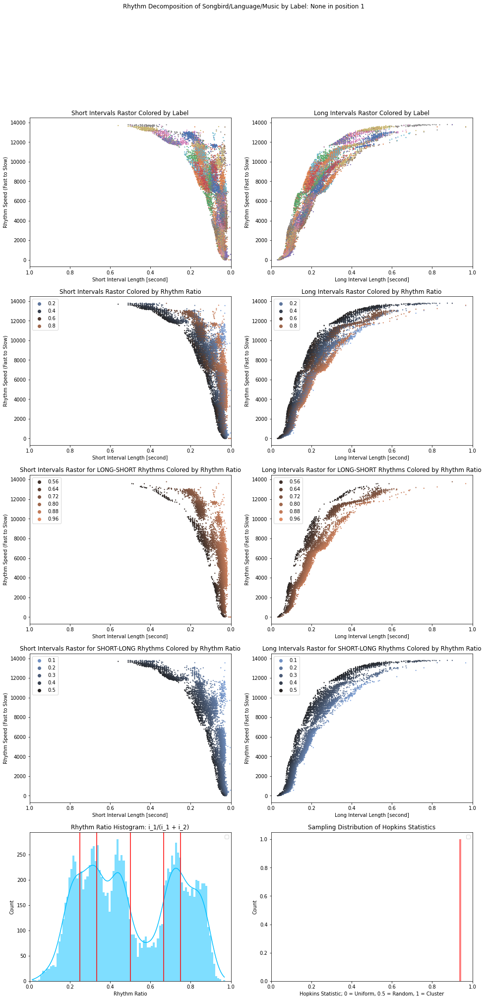

Currently Processing below 
0.5002680119138494


  0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


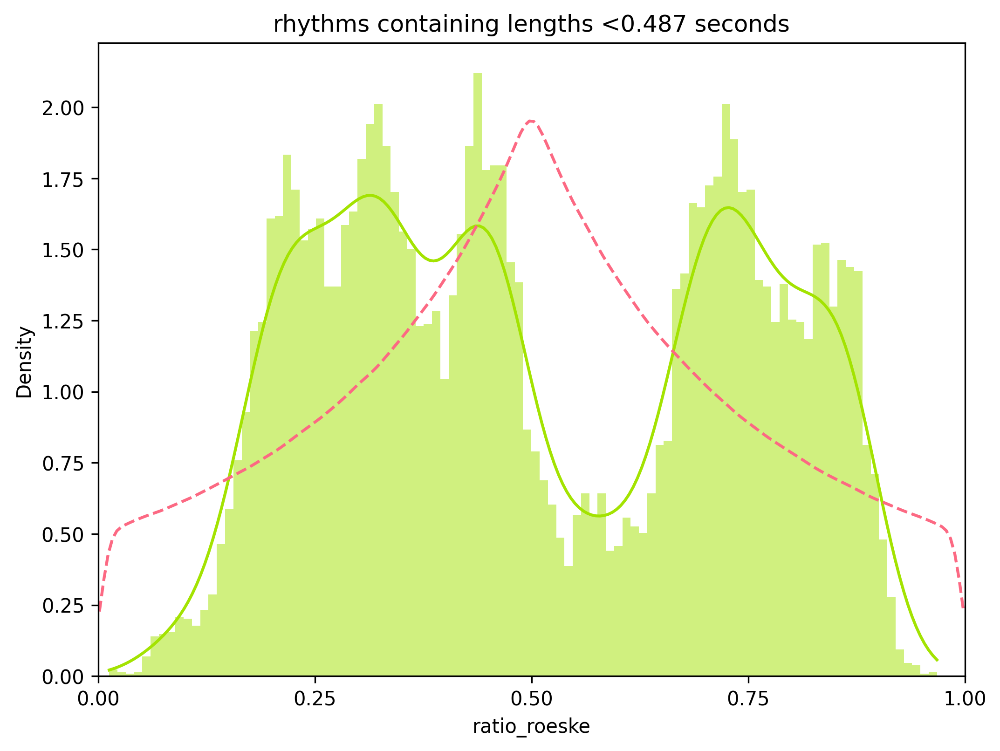

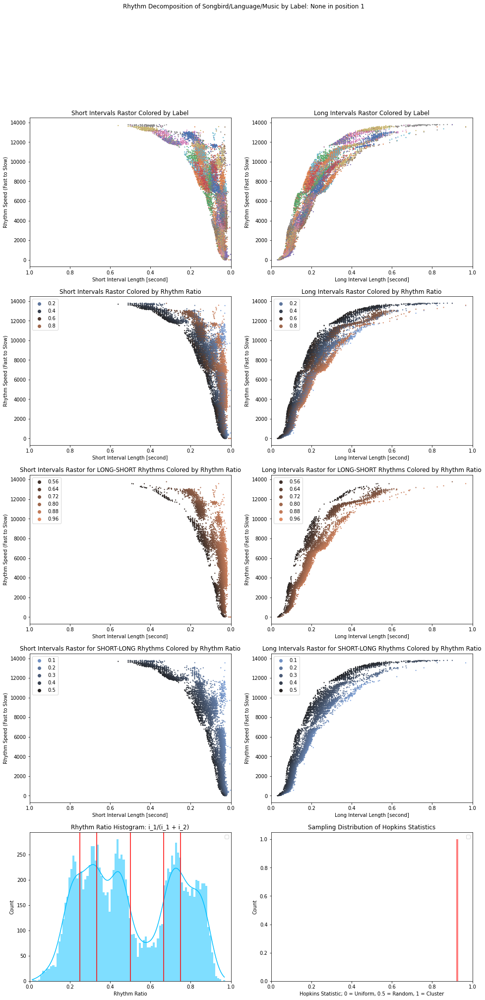

Currently Processing below 
0.5207555522616758


  0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


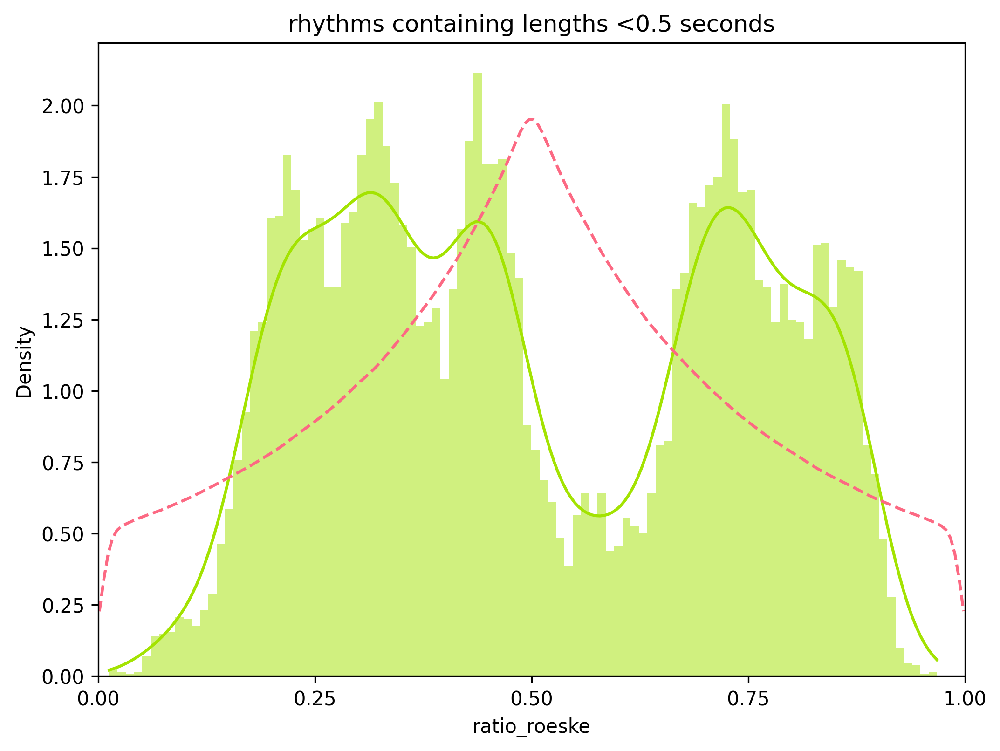

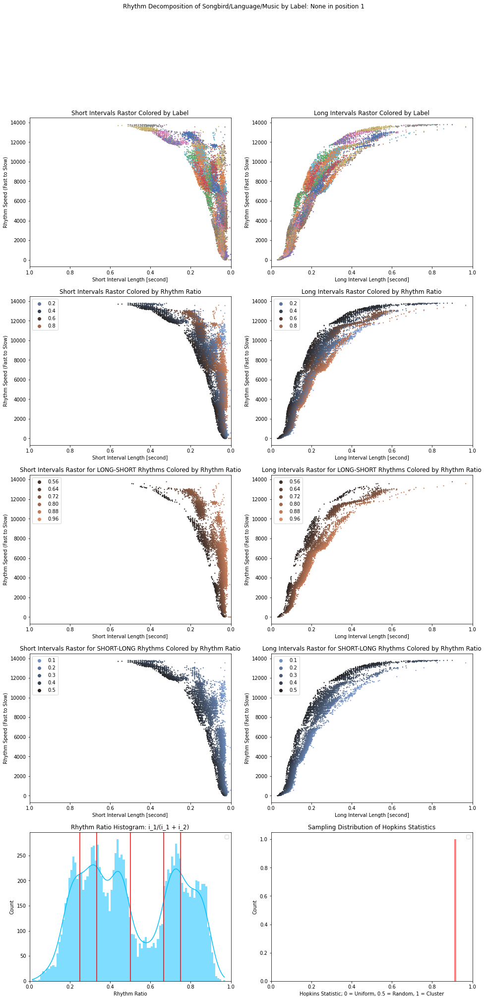

Currently Processing below 
0.5412430926095021


  0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


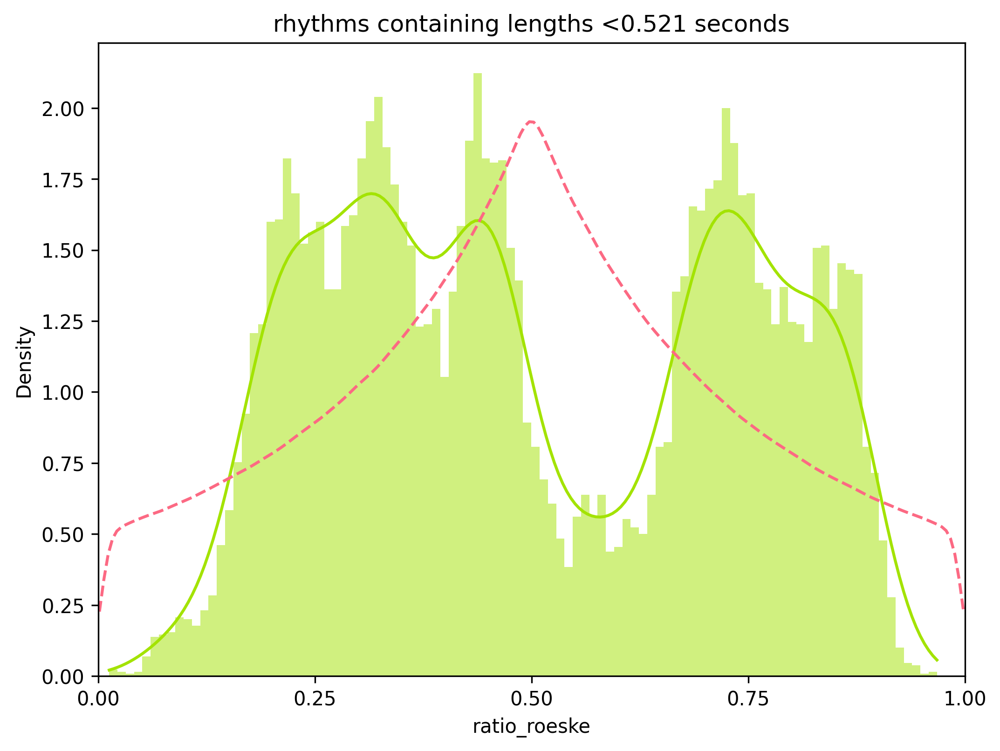

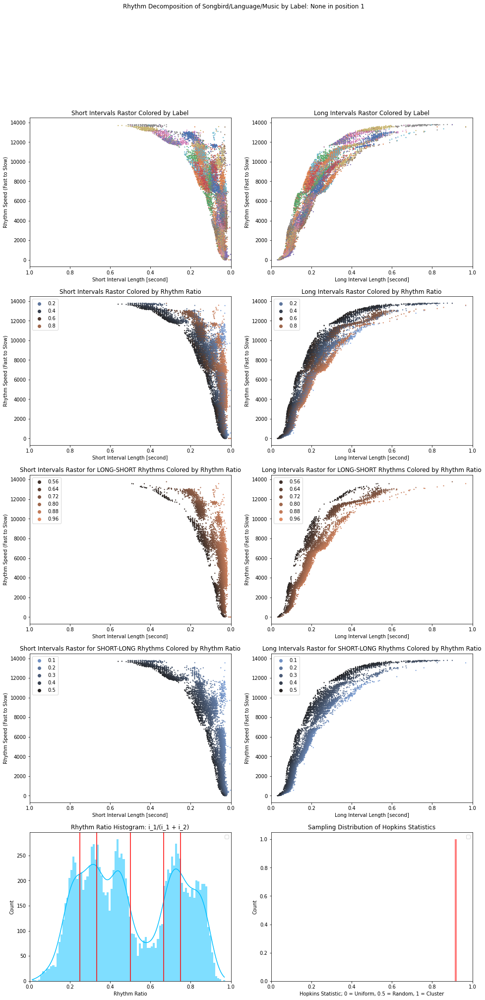

Currently Processing below 
0.5617306329573284


  0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


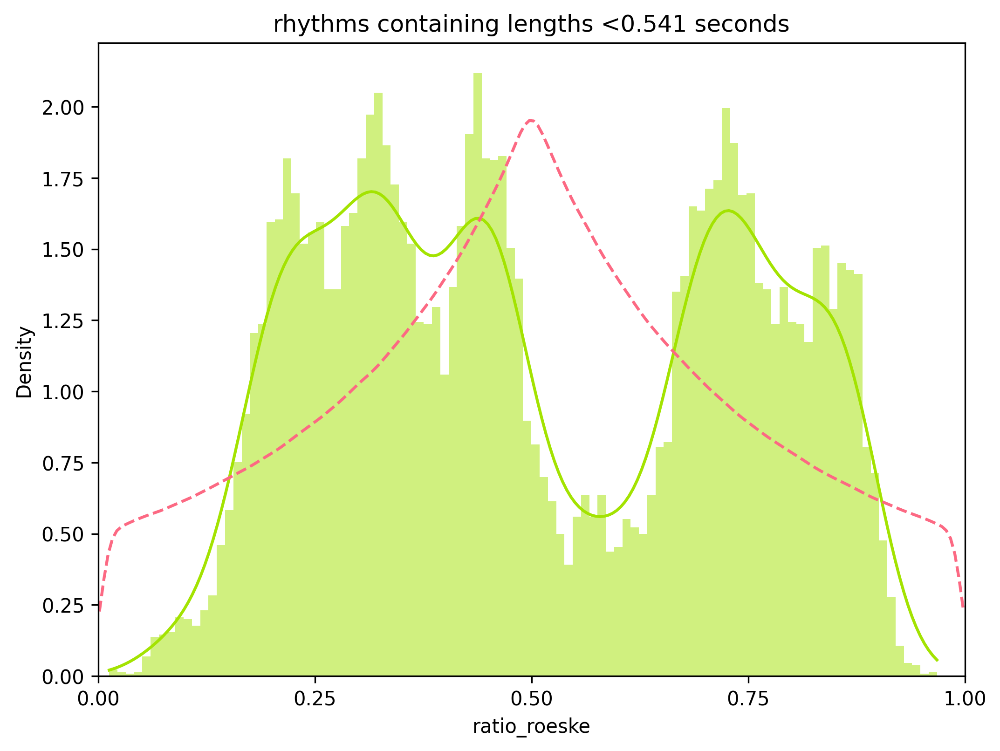

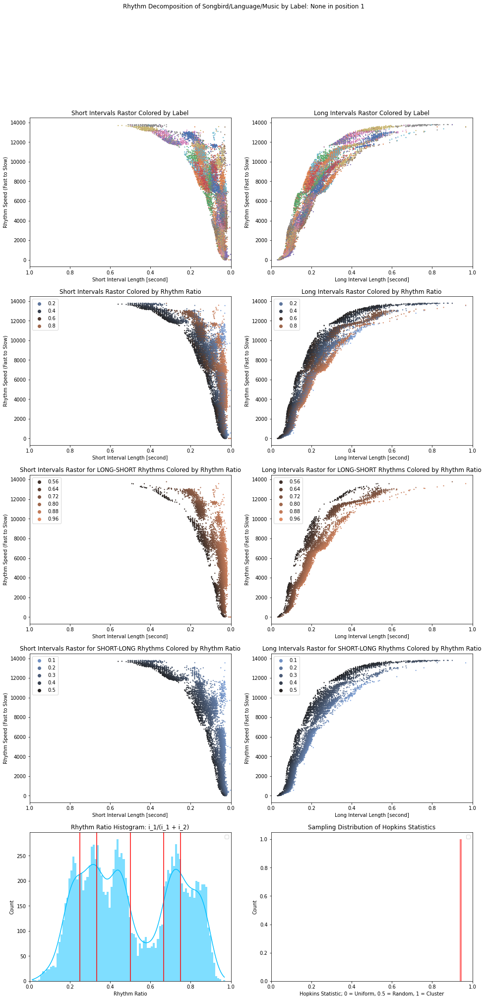

Currently Processing below 
0.6027057136529811


  0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


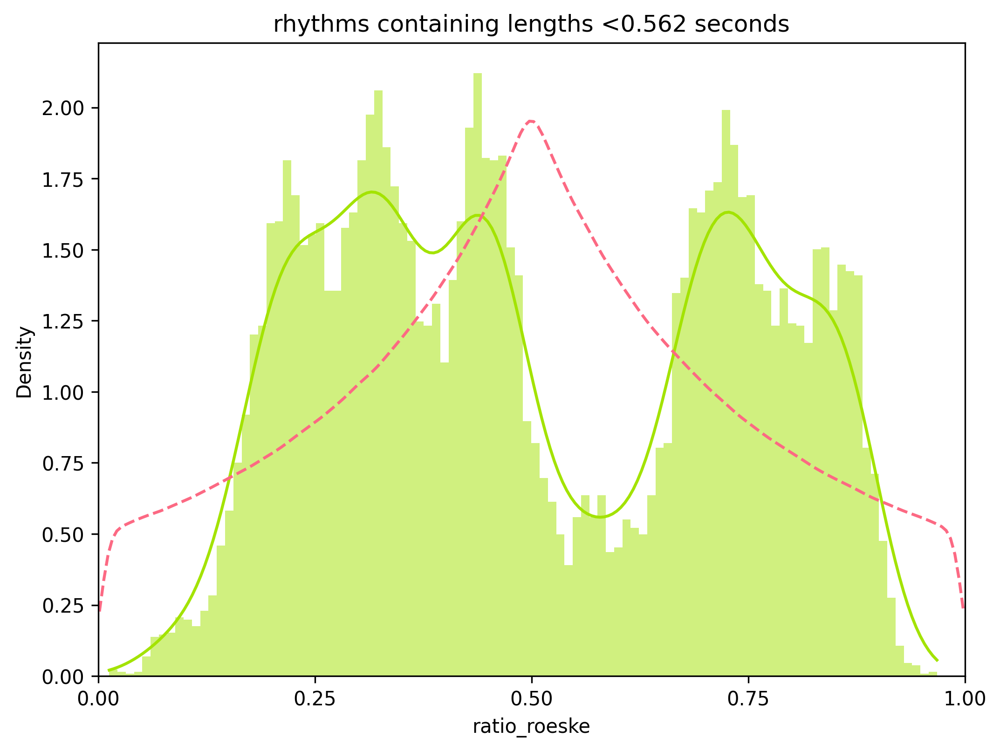

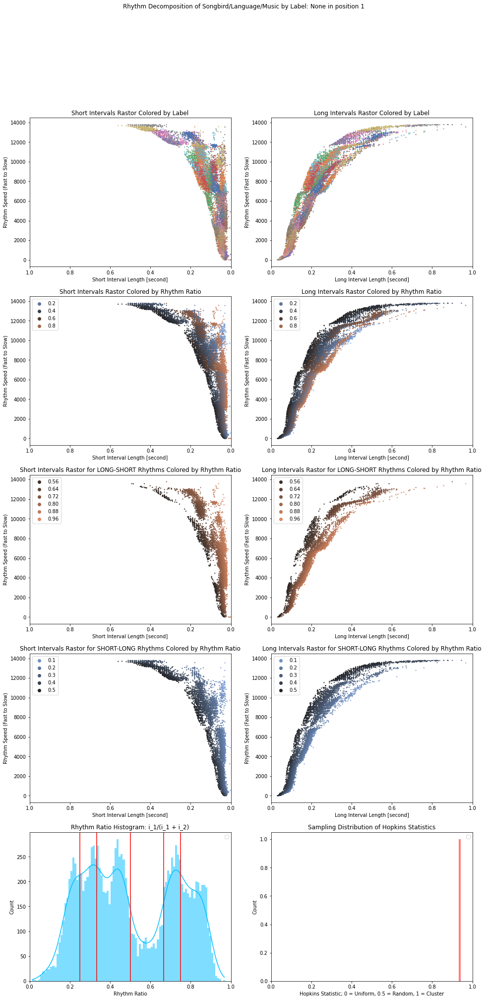

Currently Processing below 
0.6163640738848652


  0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


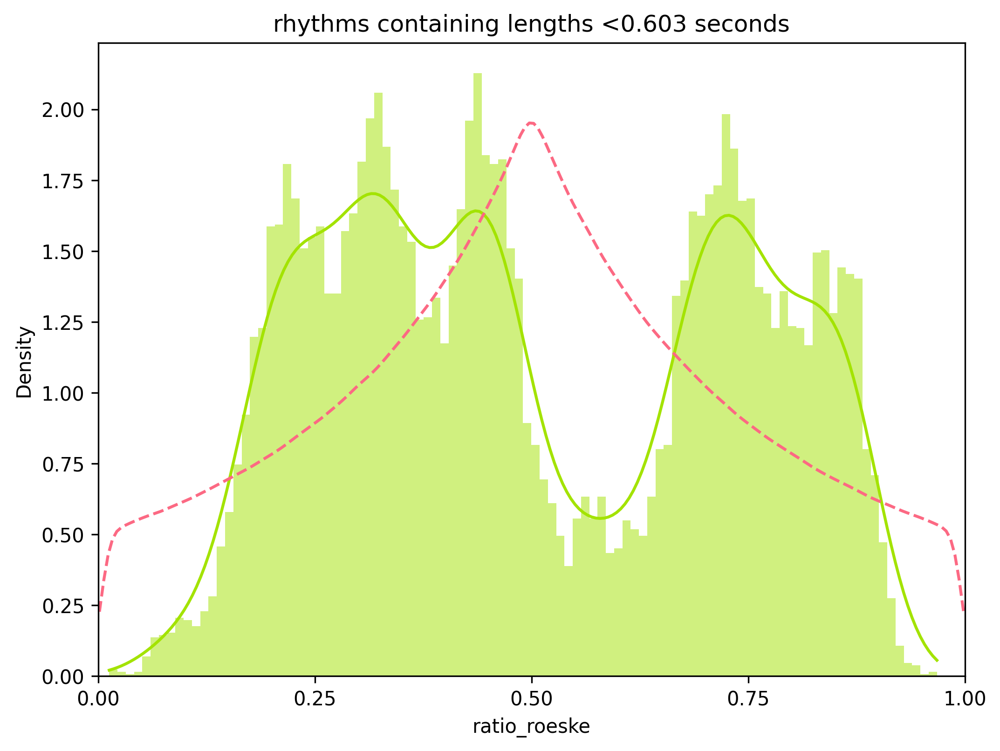

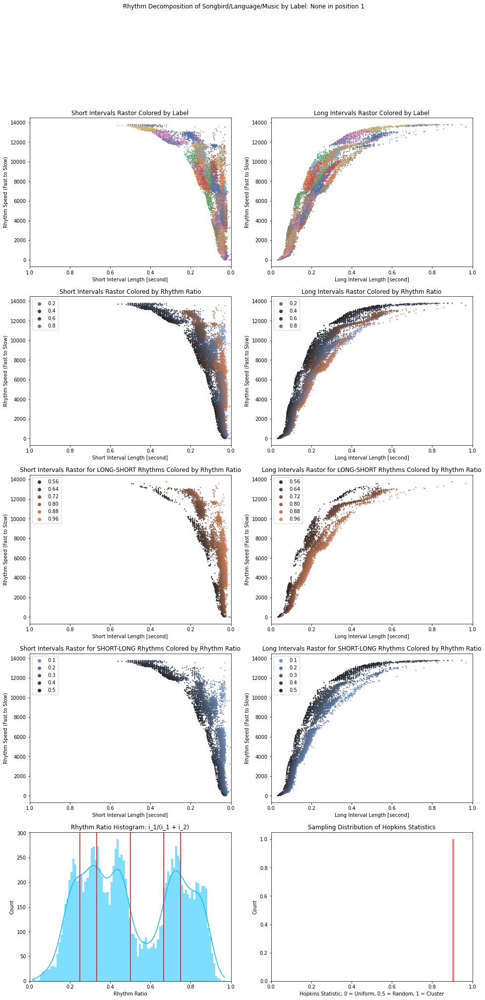

Currently Processing below 
0.6709975148124022


  0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


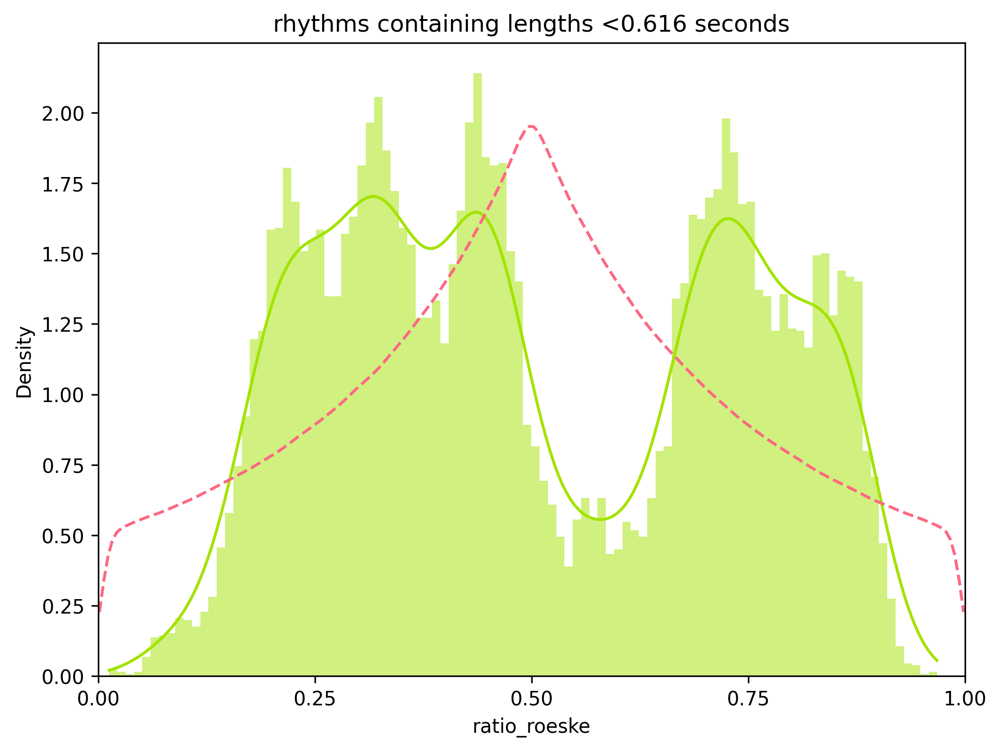

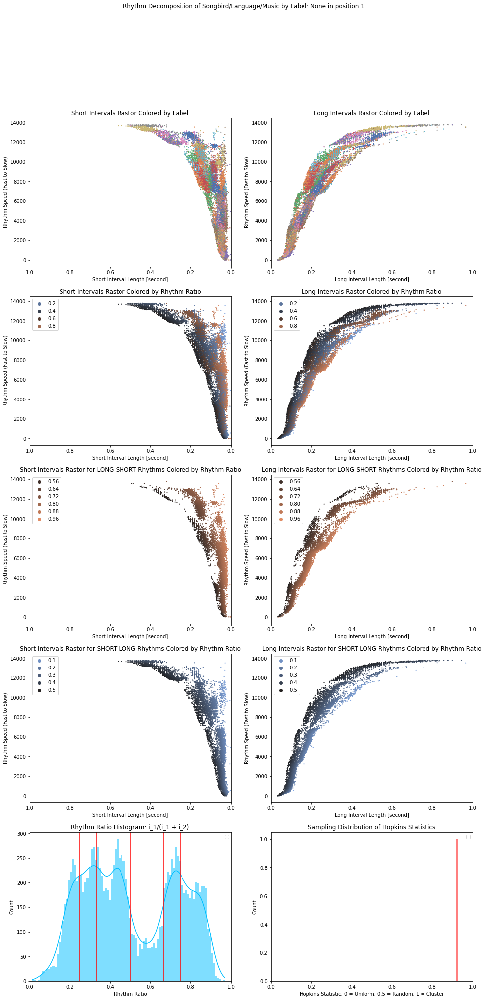

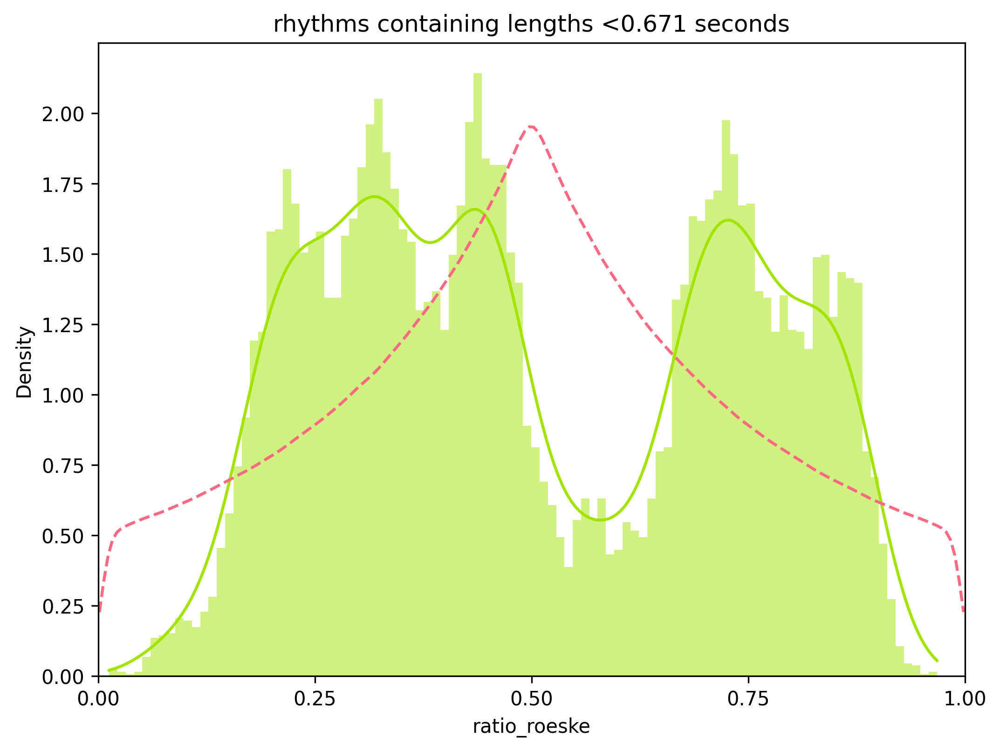

In [44]:
hopkins = []

## for each local minimum
for local_min in x[min_idx[0]]:
    
    print('Currently Processing below ')
    print(local_min)
    
    filtered_dyadic = dyadic[dyadic['len1'] < local_min]
    filtered_dyadic = filtered_dyadic[filtered_dyadic['len2'] < local_min]
    filtered_dyadic = filtered_dyadic[filtered_dyadic['len3'] < local_min]
    
    h = butcherbird.rhythm.decompose_rhythm(
        ## Macro controls
        filtered_dyadic, 
        label = None, 
        position = 1, 
        hopkins_iteration = 1,
        ## Graph controls
        figsize = (16, 32),
        xlim = (0, 1),
        s_interval = 's_interval',
        l_interval = 'l_interval', 
        cycle_rank = 'cycle_rank',
        marker = '.',
        color = 'black', 
        hue_norm = (0, 1),
        palette = 'deep',
        legend = False, 
        linewidth = 0,
        s = 20,
        s_ratio = 0.04,
        alpha = 1,
        alpha_ratio = 0.25,
        rhythm_ratio = 'ratio_roeske',
        binwidth = 0.01,
        kde = True
    )
    
    hopkins.append(np.mean(h))
    
    ## plot
    figure(figsize = (8, 6), dpi = 300)

    plt.rcParams['patch.edgecolor'] = 'none'

    fig = sns.histplot(
        x = filtered_dyadic['ratio_roeske'],
        bins = 100,
        stat = 'density',
        color = '#A3E301',
        fill = '#A3E301',
        kde = True,
    )

    uni = sns.histplot(
        x = uni_ratio,
        stat = 'density',
        alpha = 0,
        color = '#FC6983',
        kde = True,
        line_kws = dict(linestyle = 'dashed')
    )

    #sf = plt.hist(
    #    x = sf_ratio,
    #    histtype = 'step',
    #    density = True, 
    #    bins = 100,
    #    color = '#15215B'
    #)

    ax = plt.gca()
    ax.set_xlim([0, 1])
    plt.xticks(np.arange(0, 1.25, 0.25))

    ax.set_title('rhythms containing lengths '+'<'+str(np.round(local_min, 3)) + ' seconds')
    
    # save
    figname = 'fig1_' + 'categorical_rhythm_filtered' + indv + str(np.round(local_min, 3)) + '.pdf'
    plt.savefig(FIGURE_DIR/figname)

In [45]:
hopkins

[0.9262099265677626,
 0.9789746348015648,
 0.966060030793901,
 0.9539702210057955,
 0.9530953658861394,
 0.9380291968689204,
 0.9255552512099725,
 0.9191445821973275,
 0.9130695993648843,
 0.9318074165216161,
 0.9067588780580268,
 0.9047621827072234,
 0.9215334999651675,
 0.9129936386773959,
 0.9241764404958831,
 0.918849846891249,
 0.9261588331181069,
 0.9227131365206233,
 0.918953867738934,
 0.9350815900374999,
 0.9192694303590818,
 0.9109311888765619,
 0.9135282746357051,
 0.9375132016245249,
 0.9327702358283267,
 0.8990804546318696,
 0.9185406719501334]

Currently Processing above 
0.08368802484138087


  0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


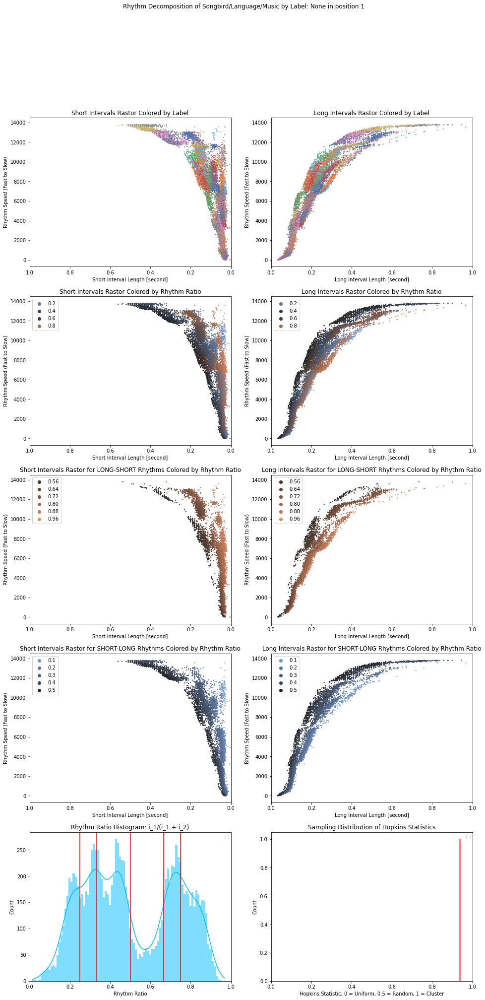

Currently Processing above 
0.10417556518920719


  0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


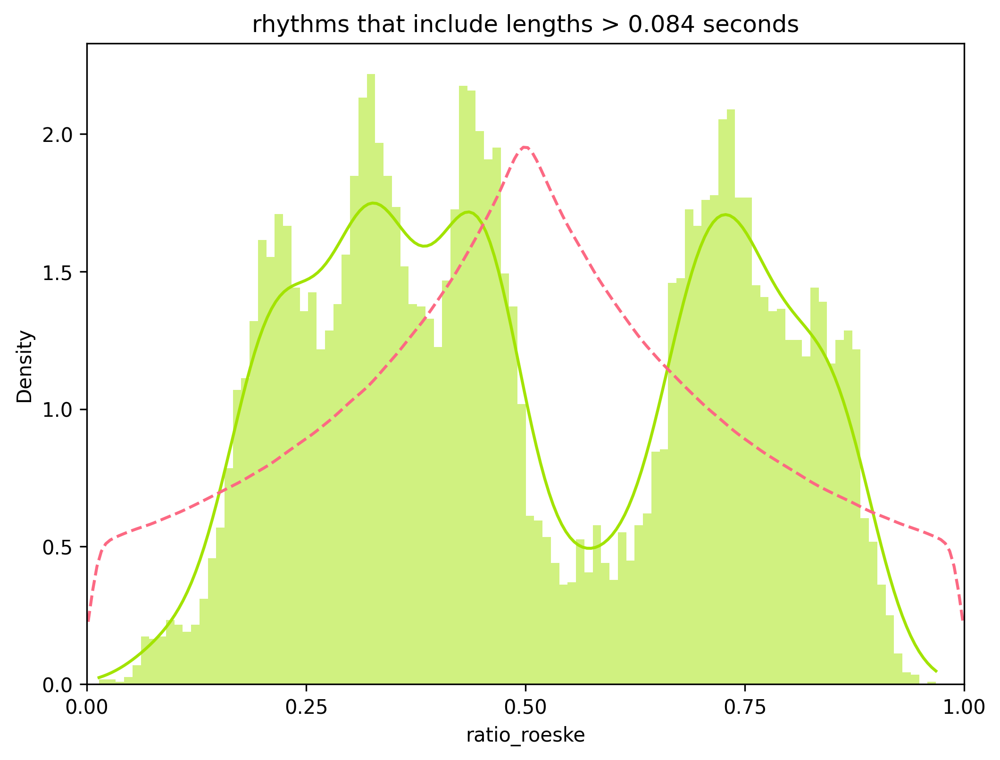

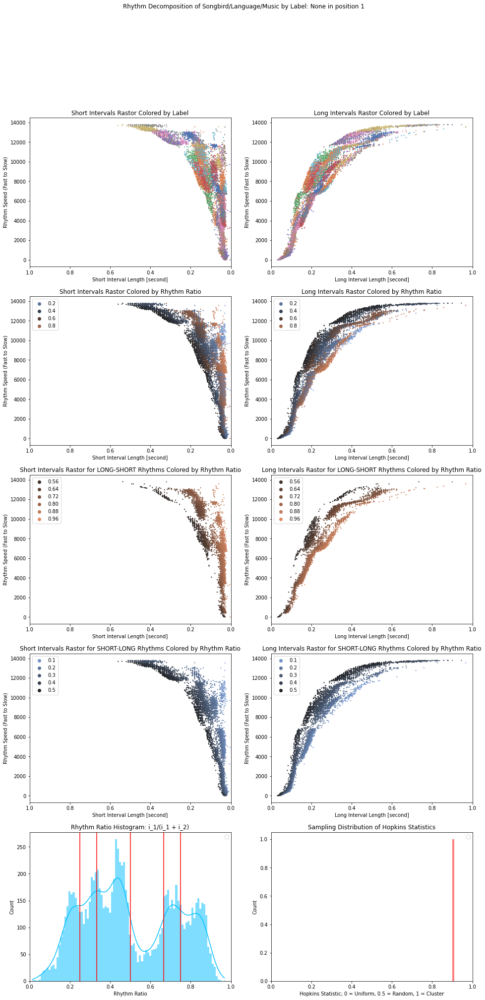

Currently Processing above 
0.1178339254210914


  0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


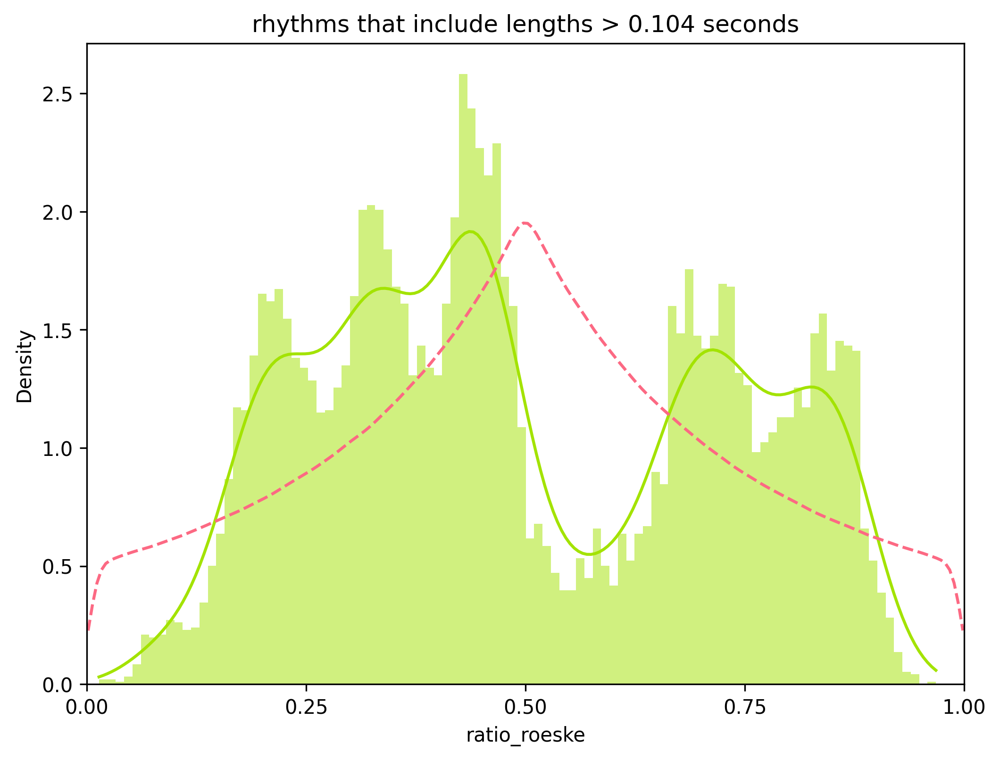

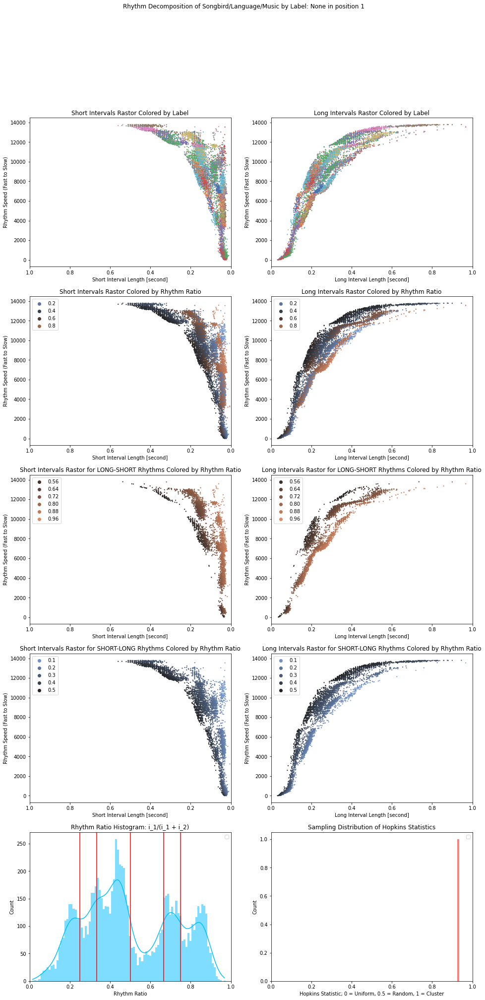

Currently Processing above 
0.17246736634862828


  0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


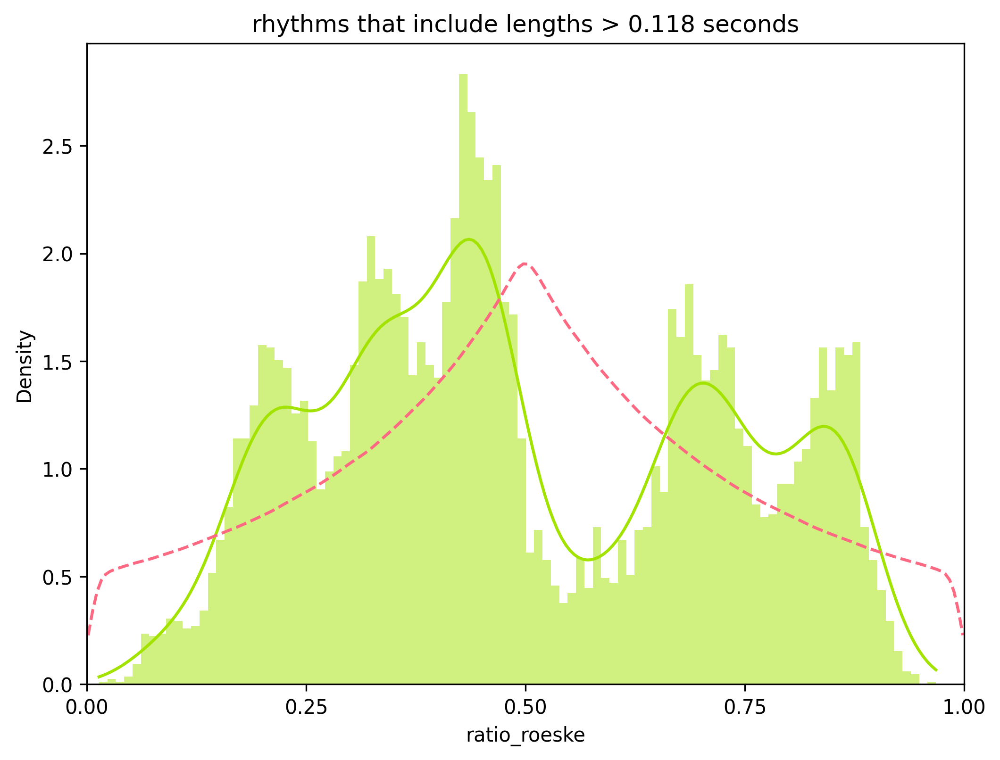

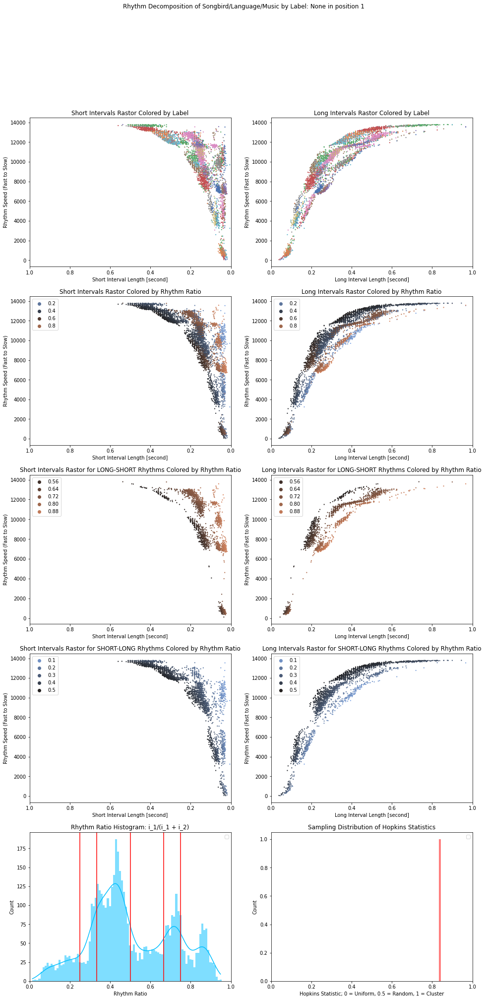

Currently Processing above 
0.1929549066964546


  0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


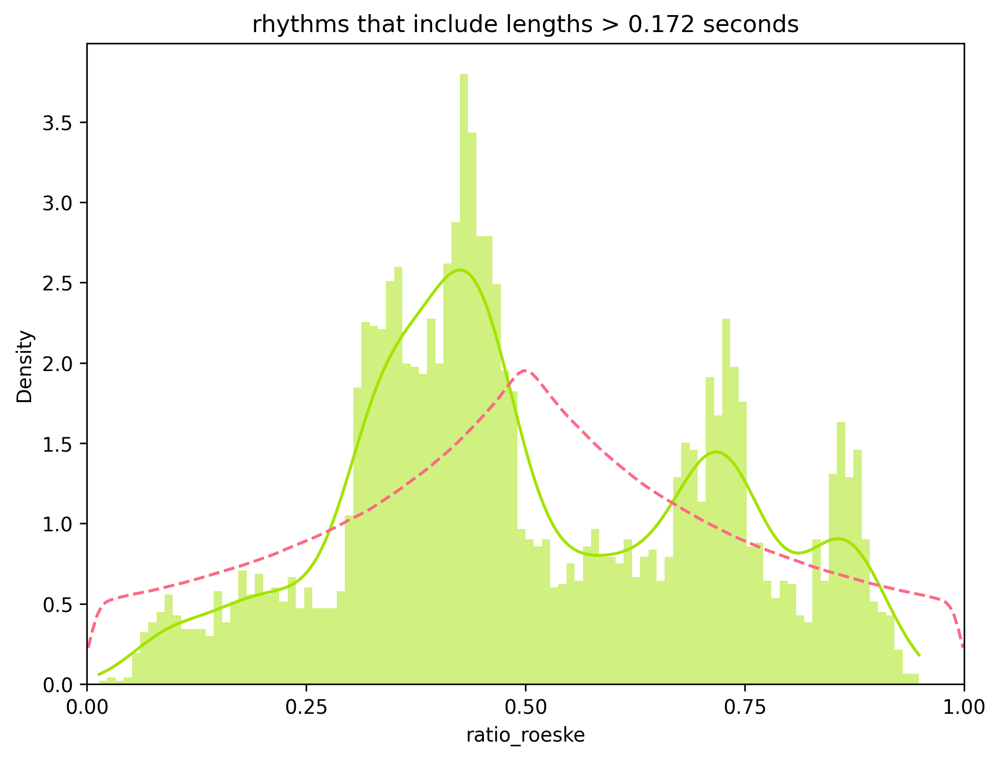

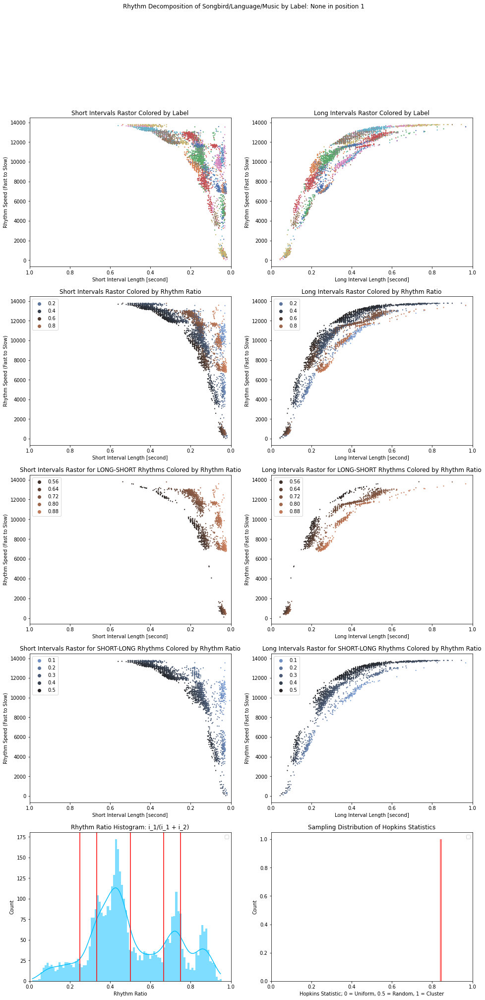

Currently Processing above 
0.22027162716022303


  0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


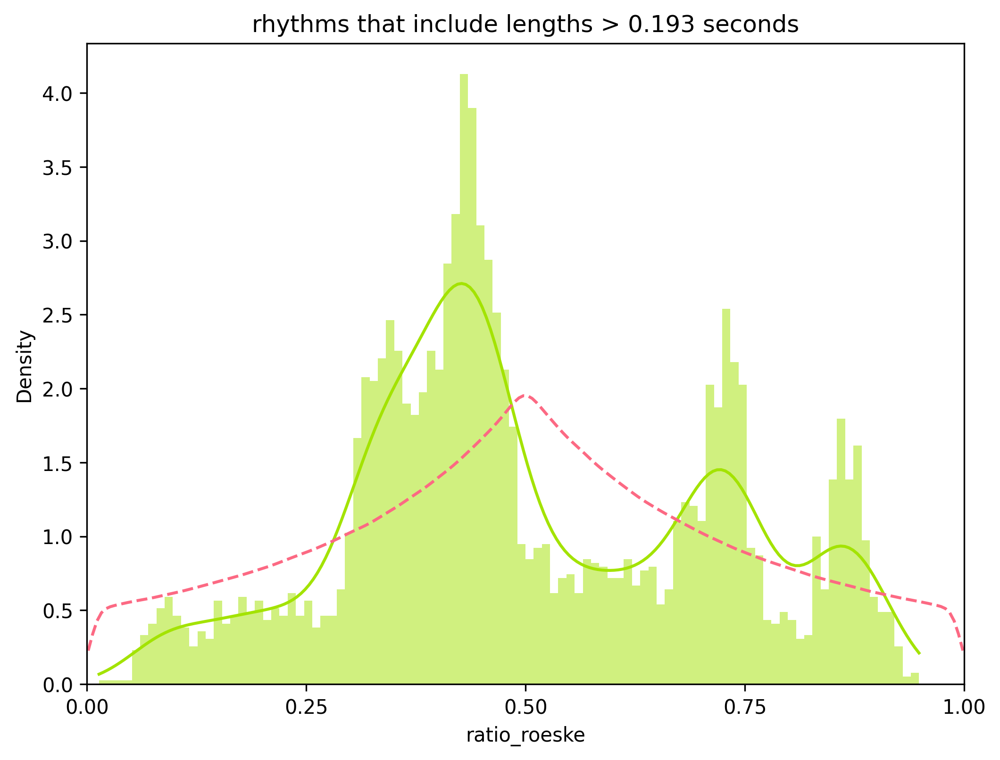

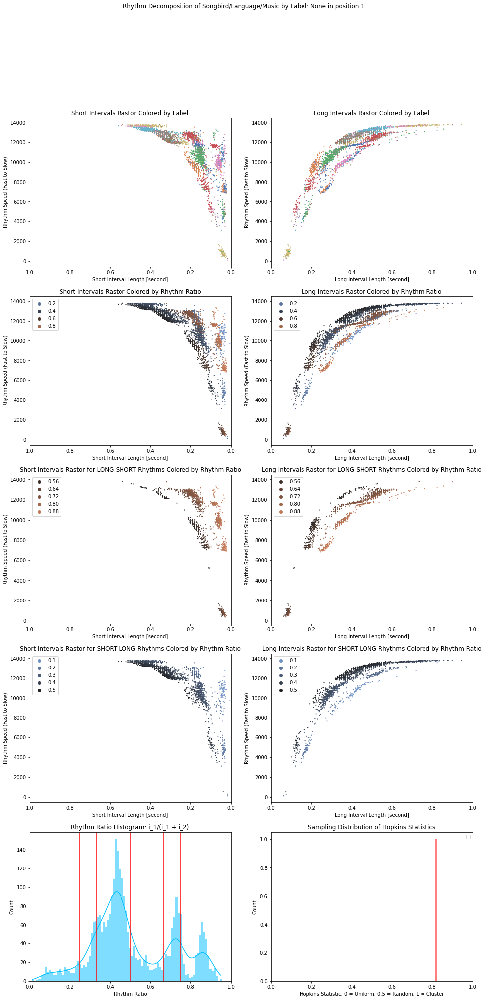

Currently Processing above 
0.24075916750804935


  0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


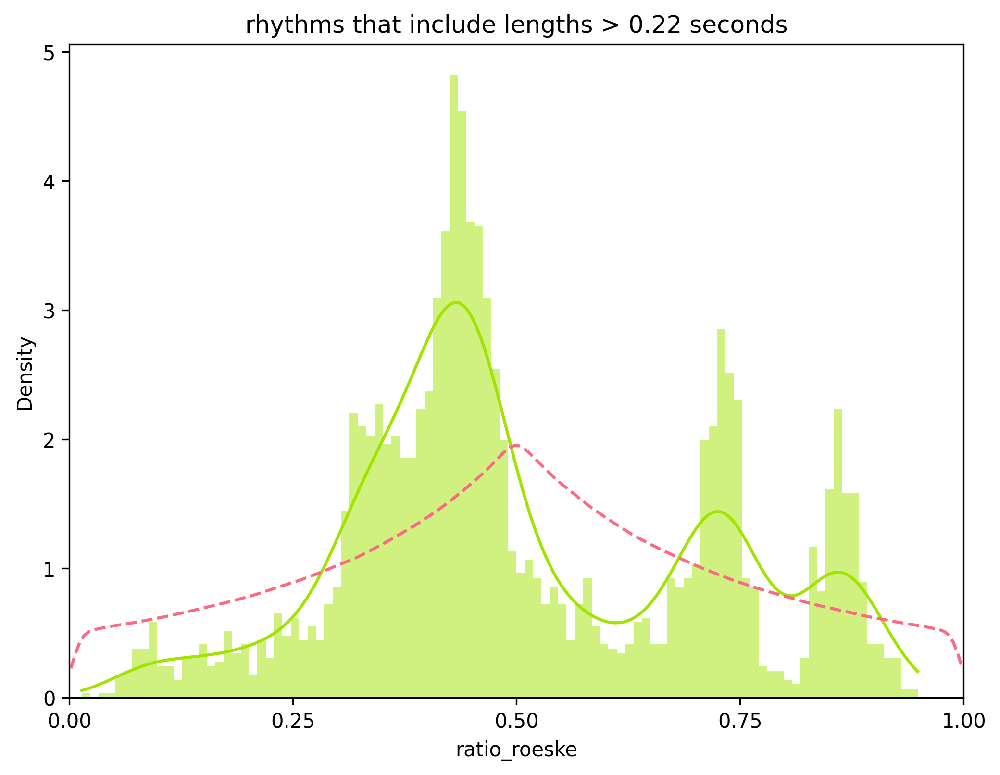

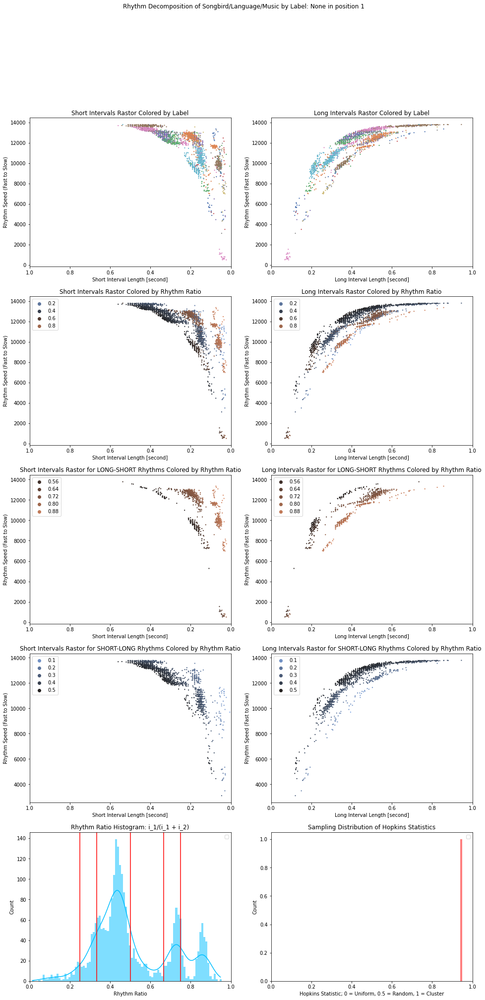

Currently Processing above 
0.26124670785587567


  0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


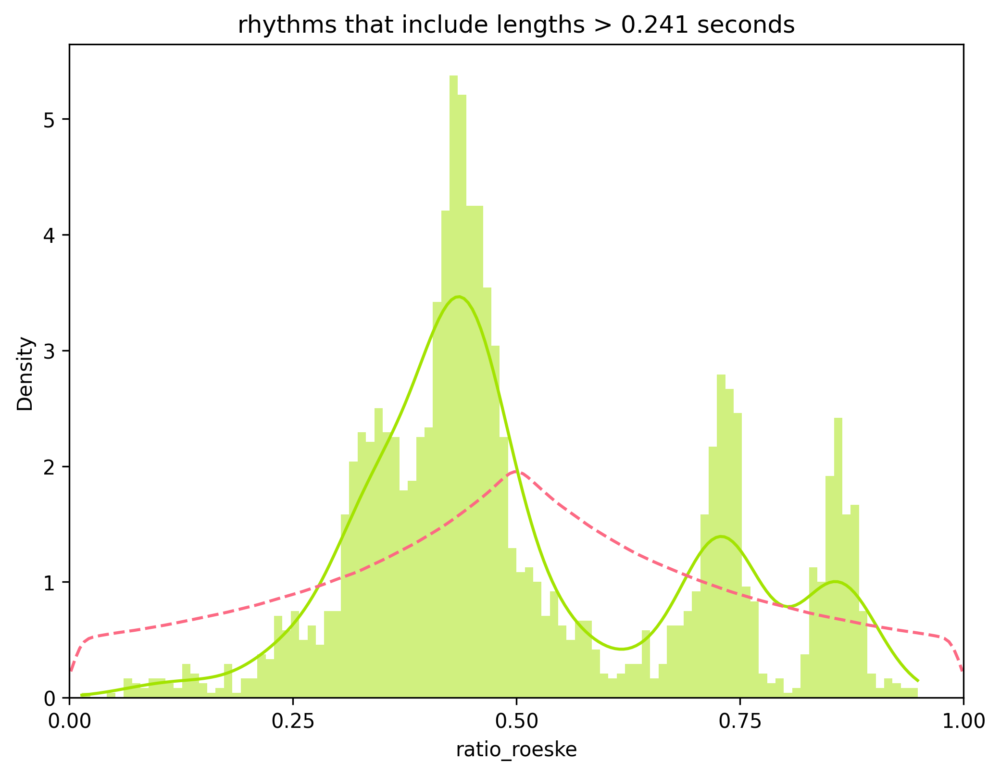

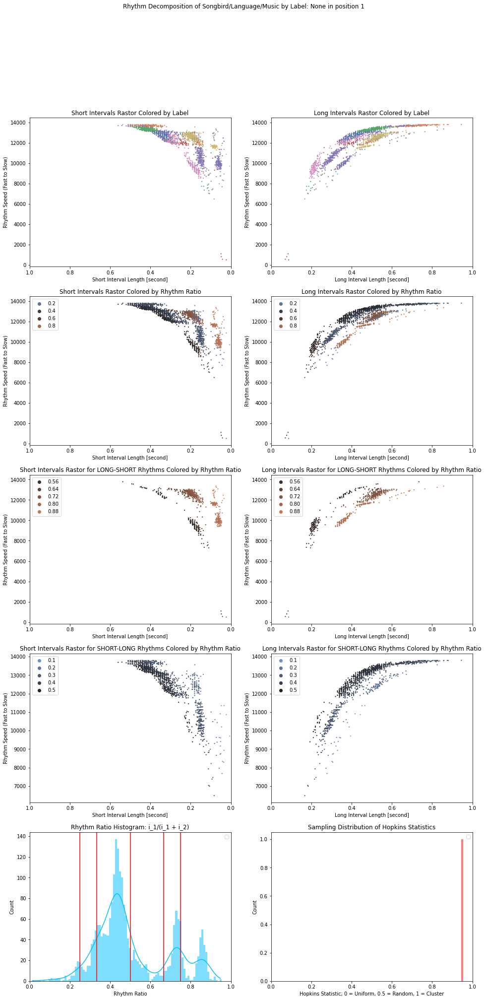

Currently Processing above 
0.281734248203702


  0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


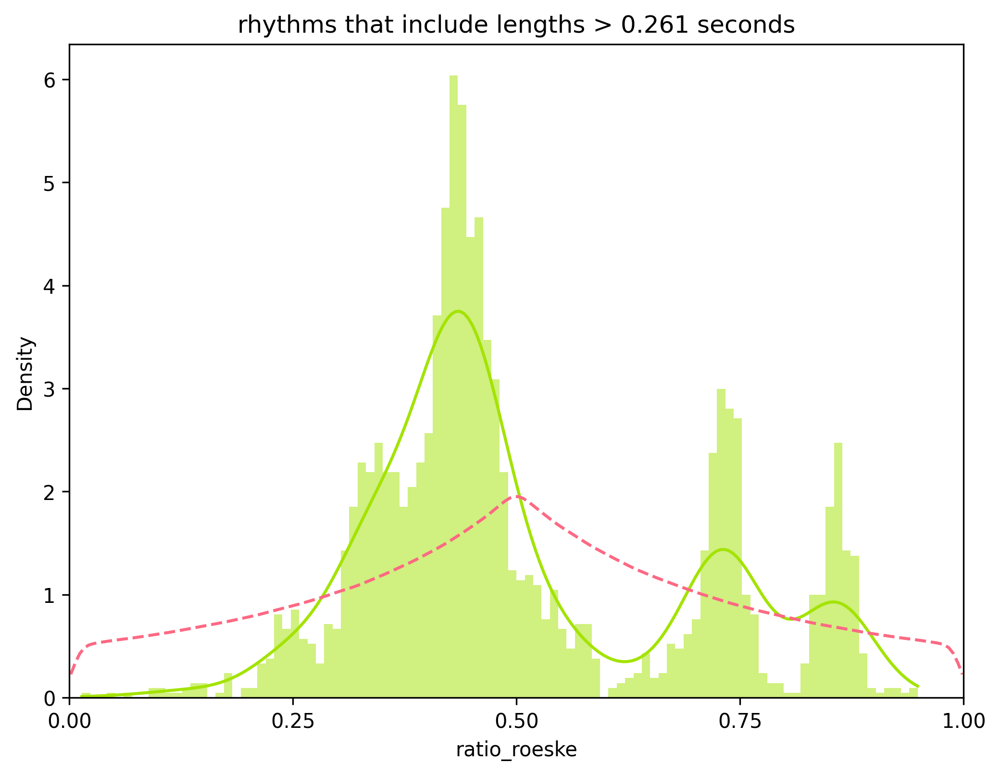

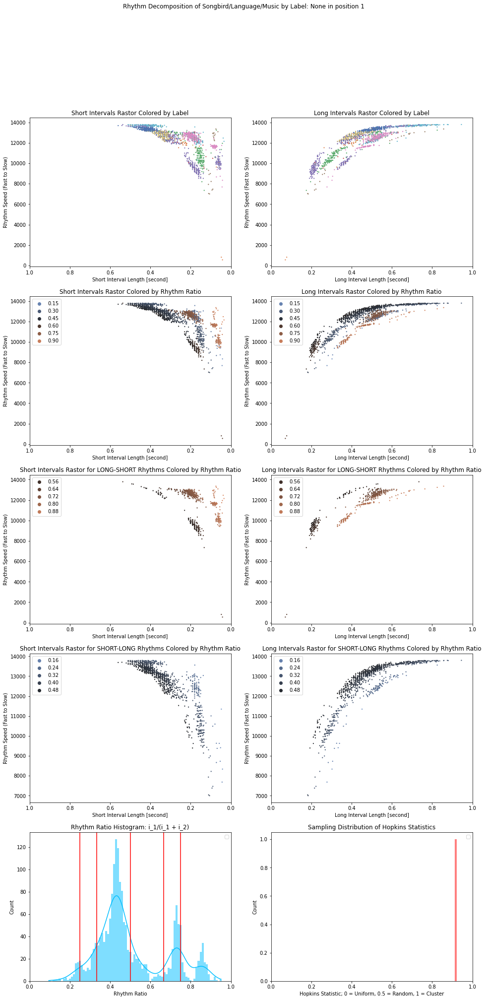

Currently Processing above 
0.3022217885515283


  0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


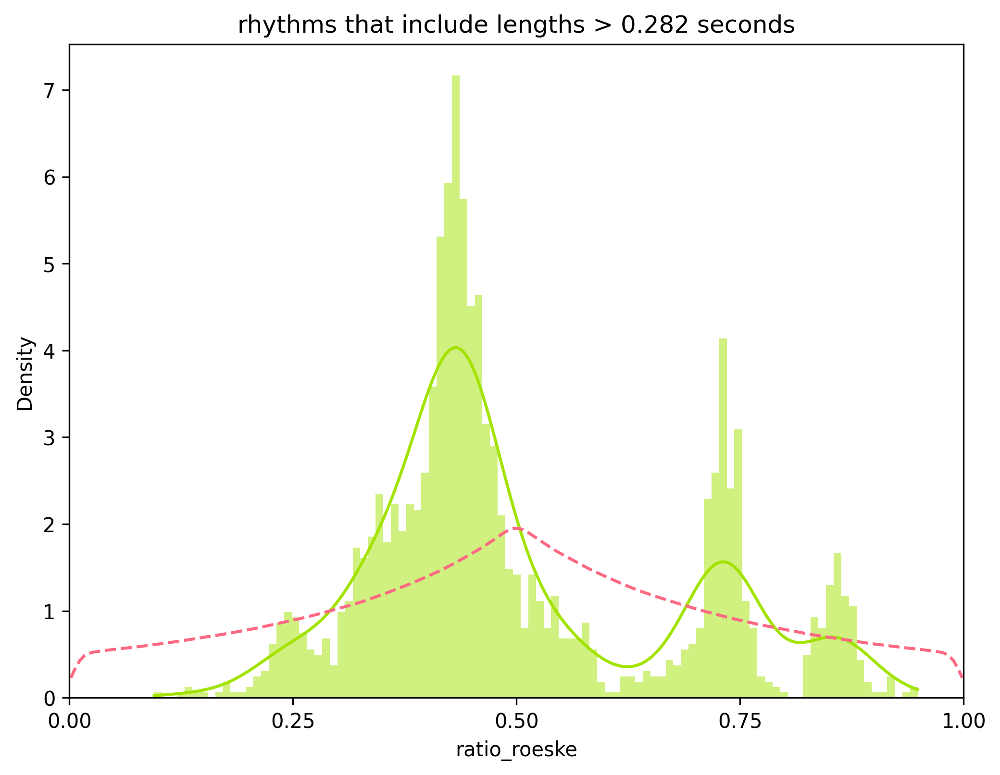

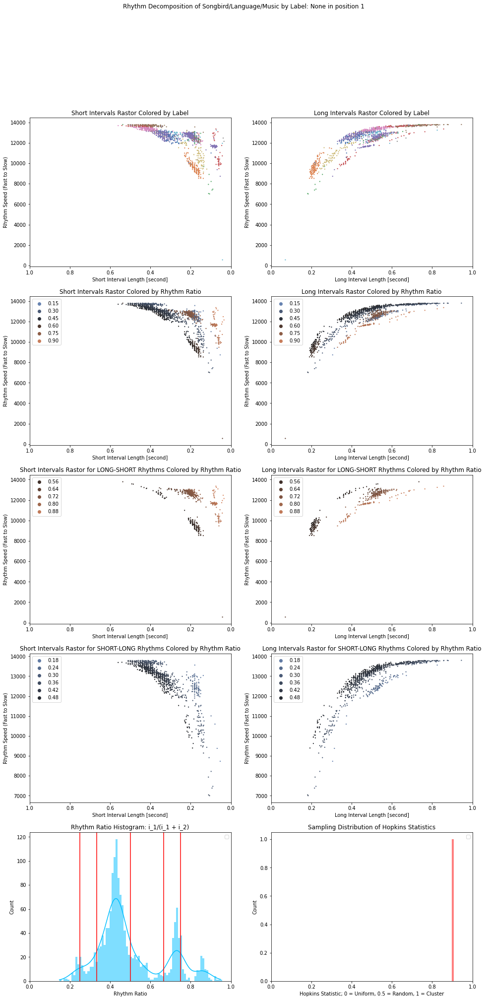

Currently Processing above 
0.32270932889935466


  0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


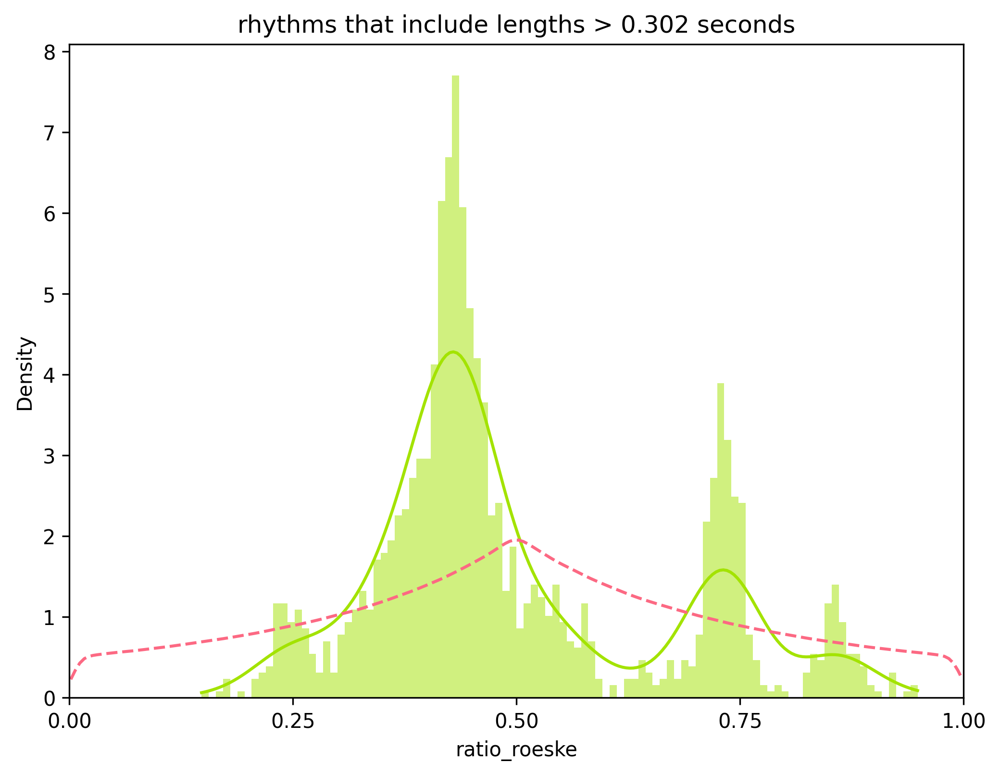

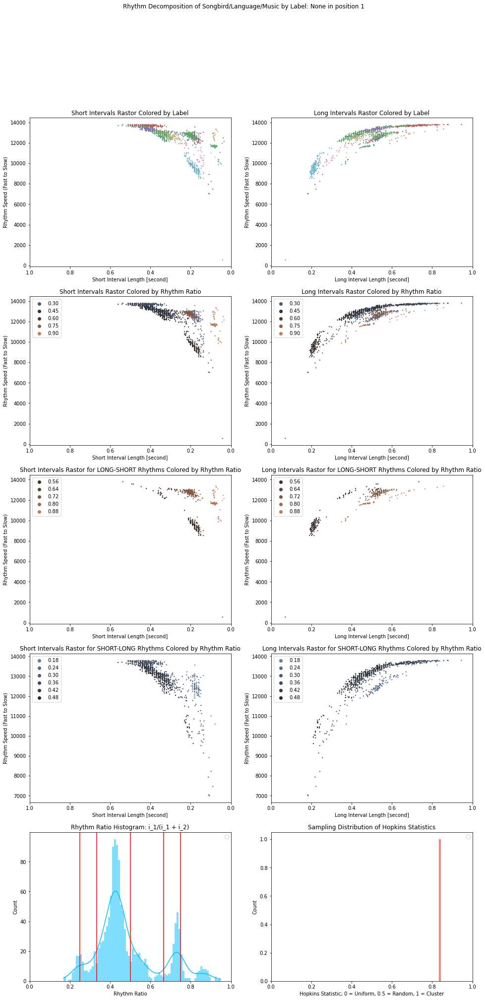

Currently Processing above 
0.3363676891312389


  0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


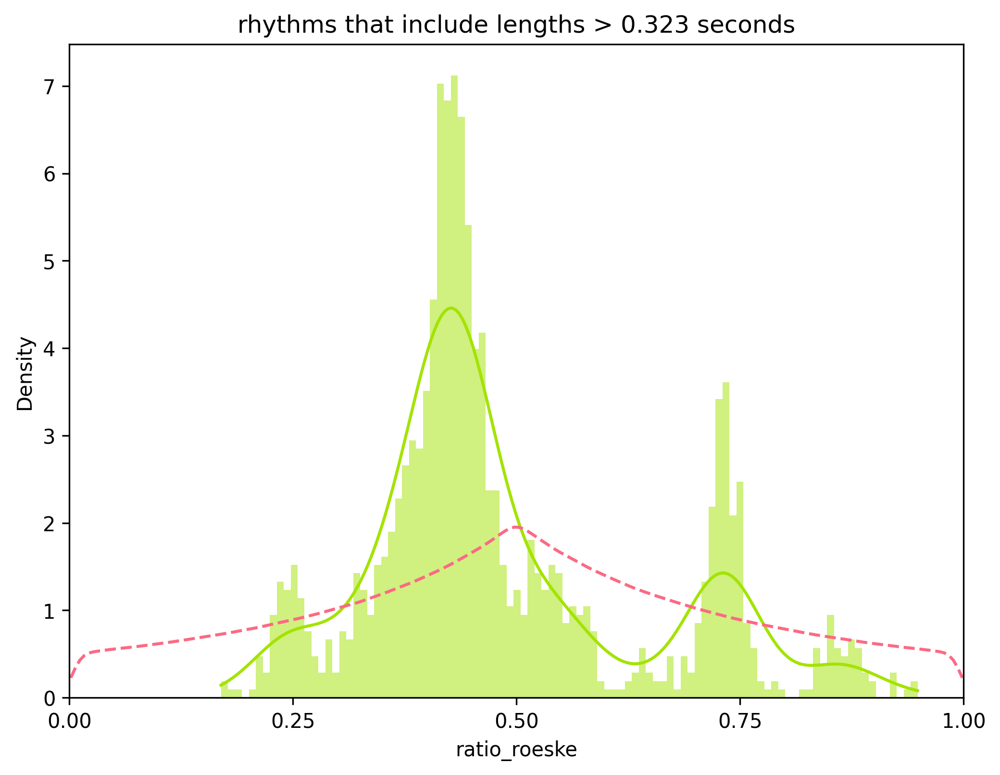

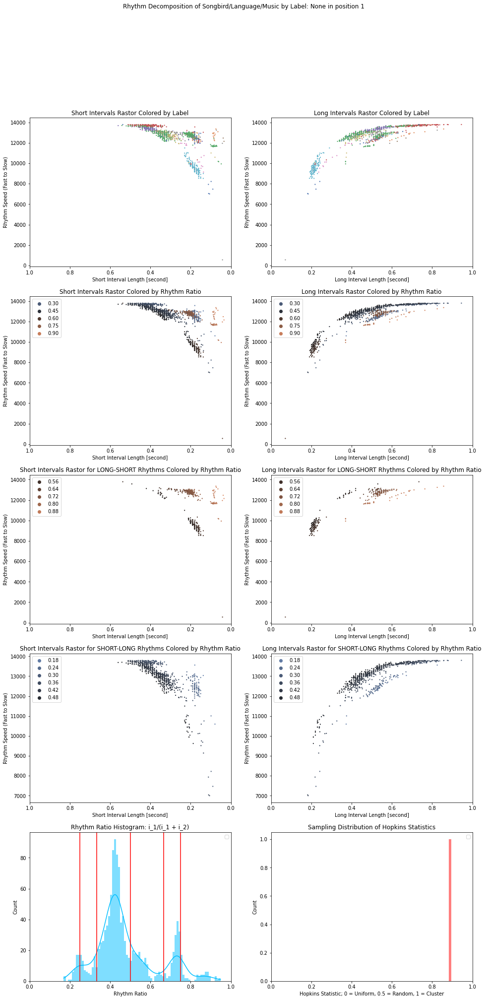

Currently Processing above 
0.3500260493631231


  0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


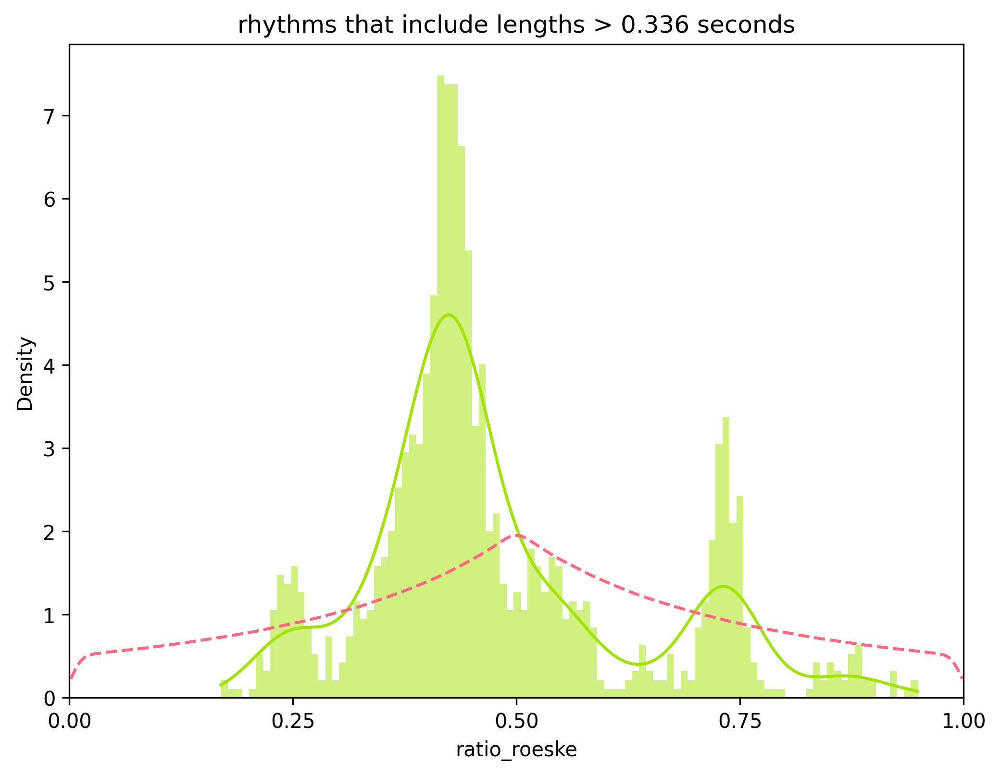

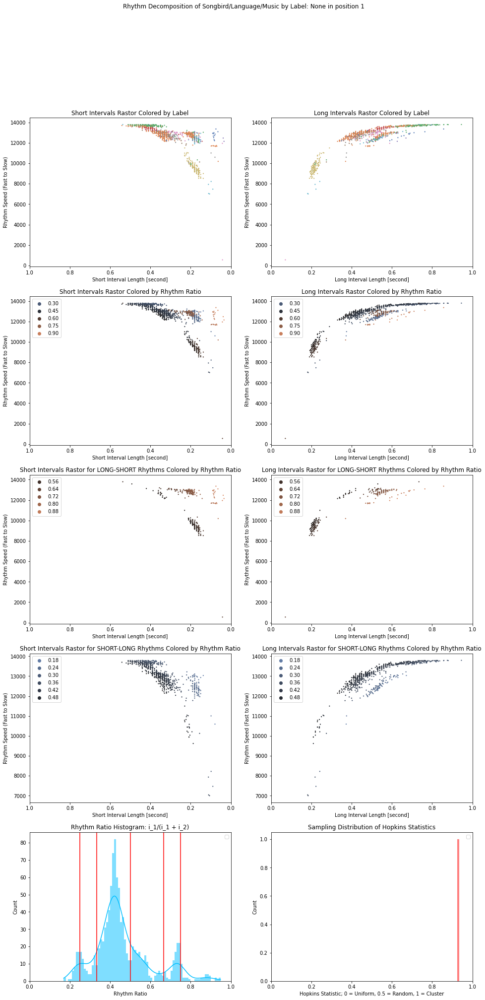

Currently Processing above 
0.3705135897109494


  0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


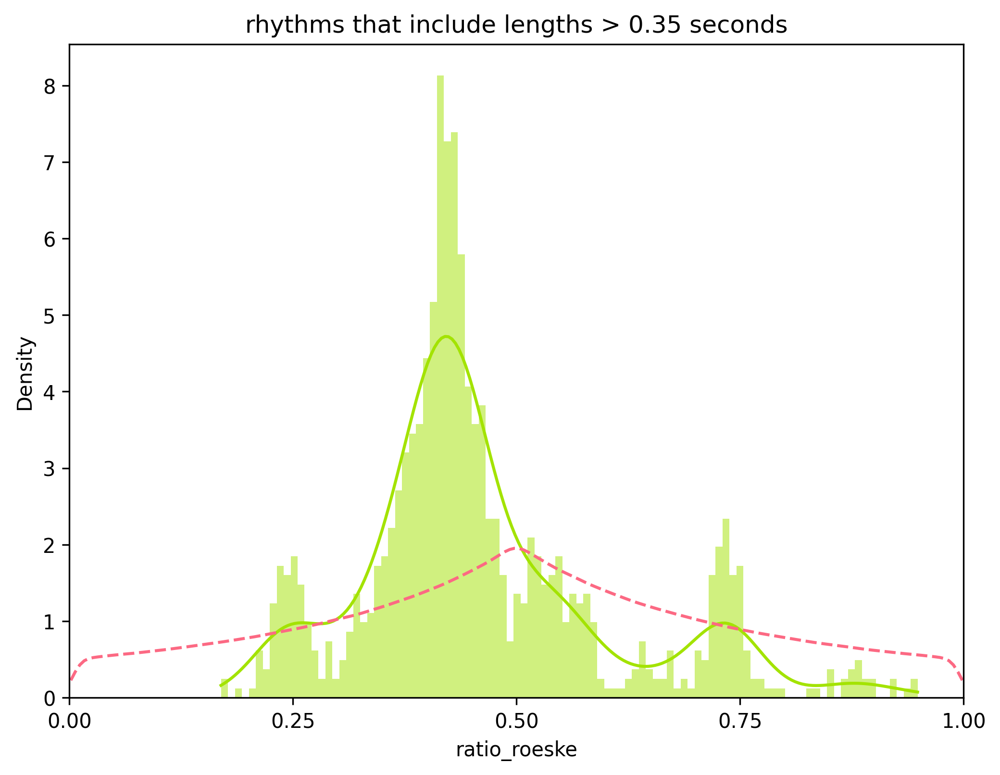

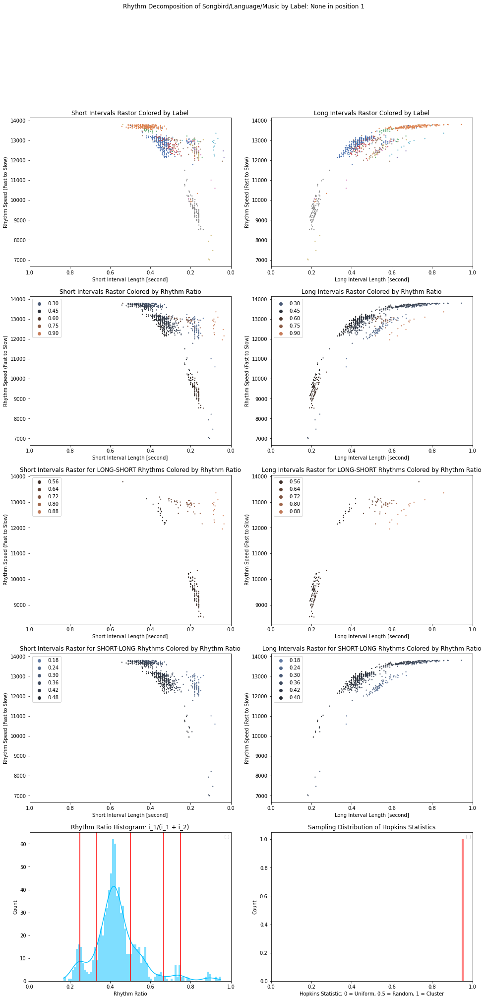

Currently Processing above 
0.39100113005877574


  0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


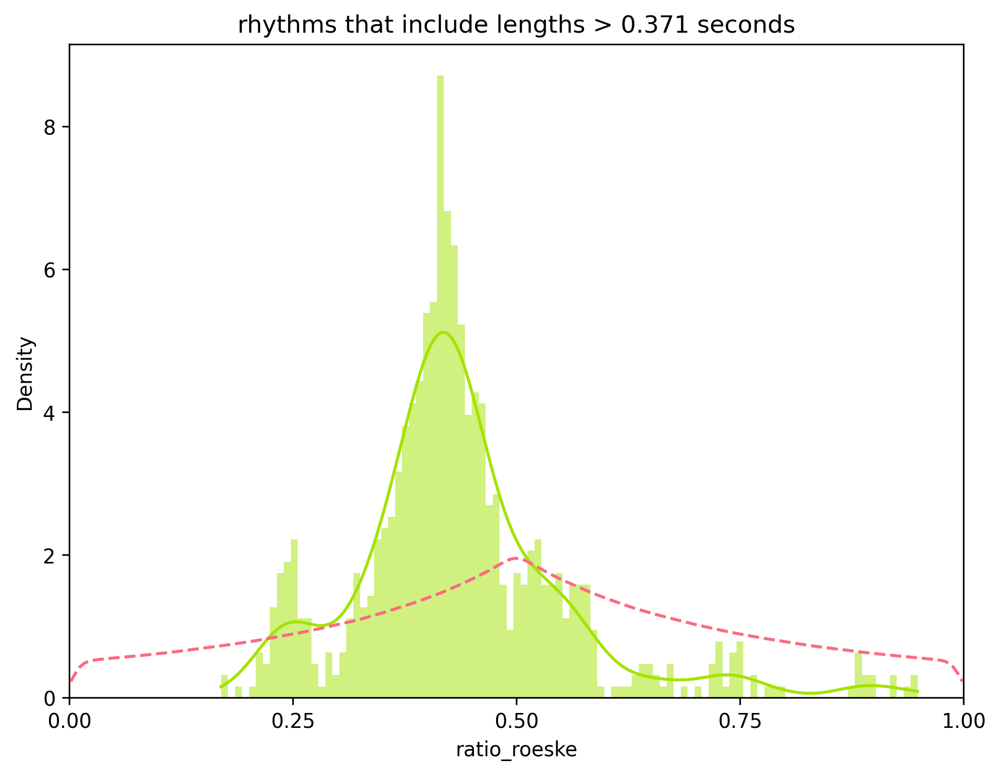

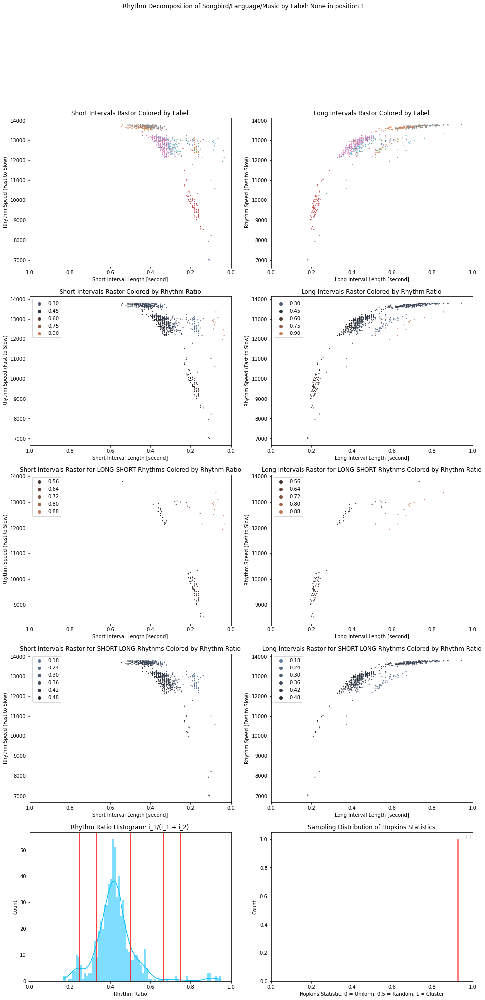

Currently Processing above 
0.41148867040660203


  0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


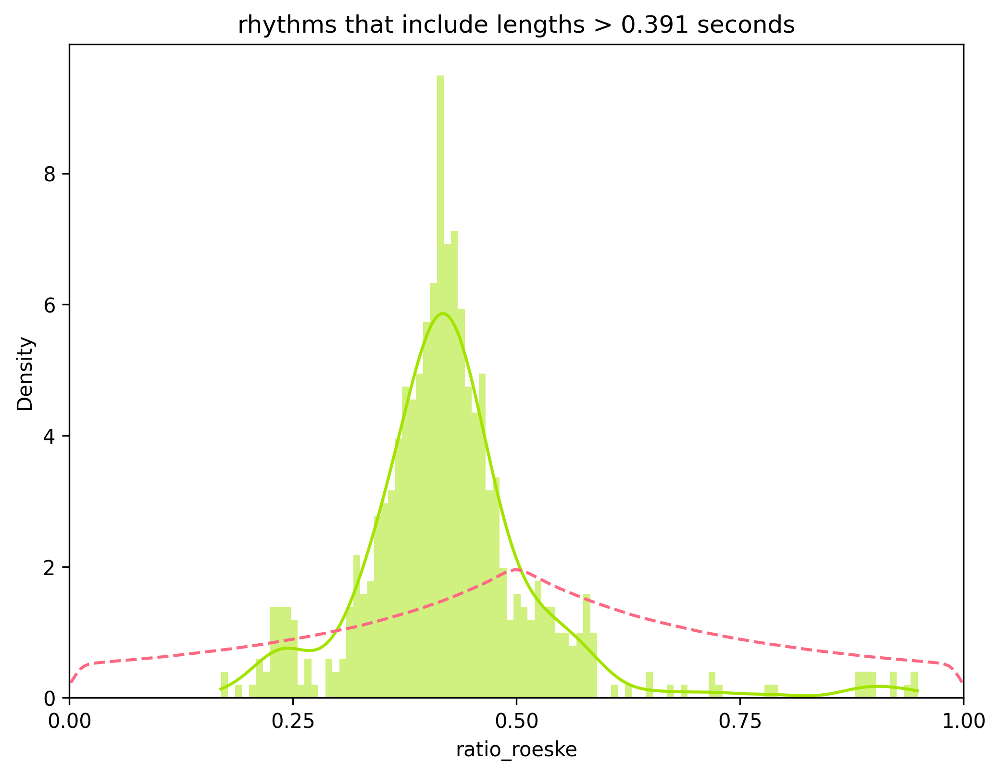

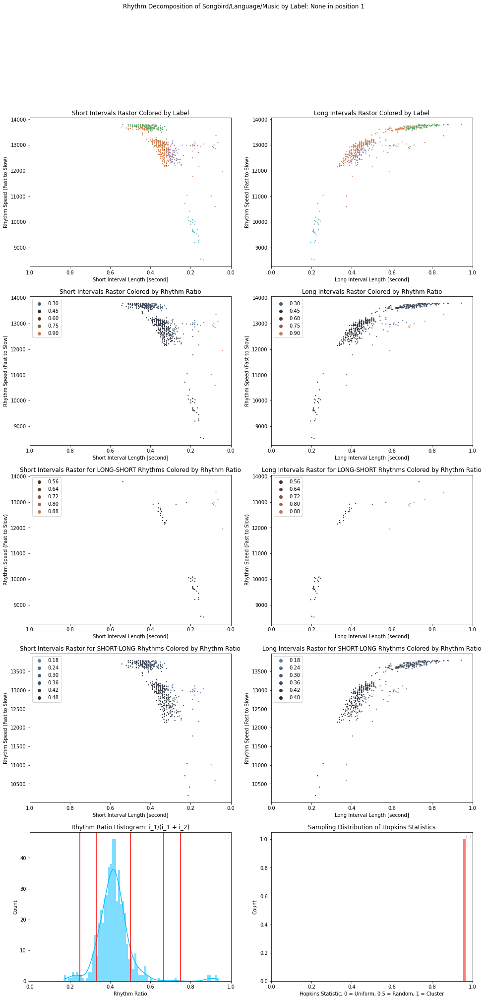

Currently Processing above 
0.4319762107544284


  0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


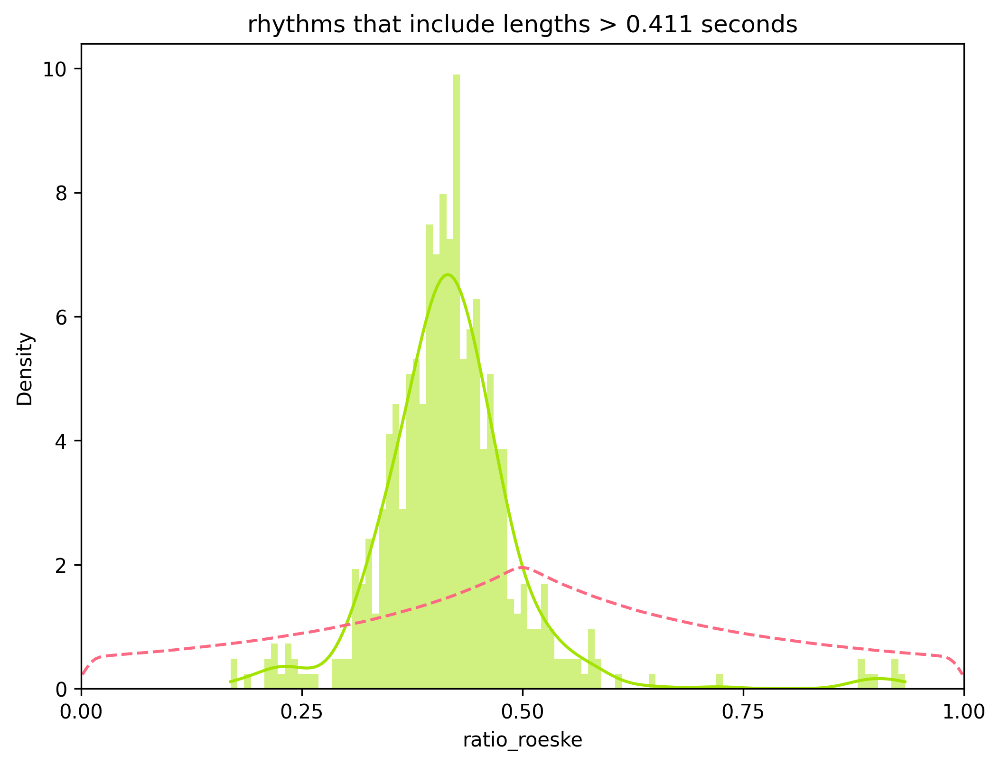

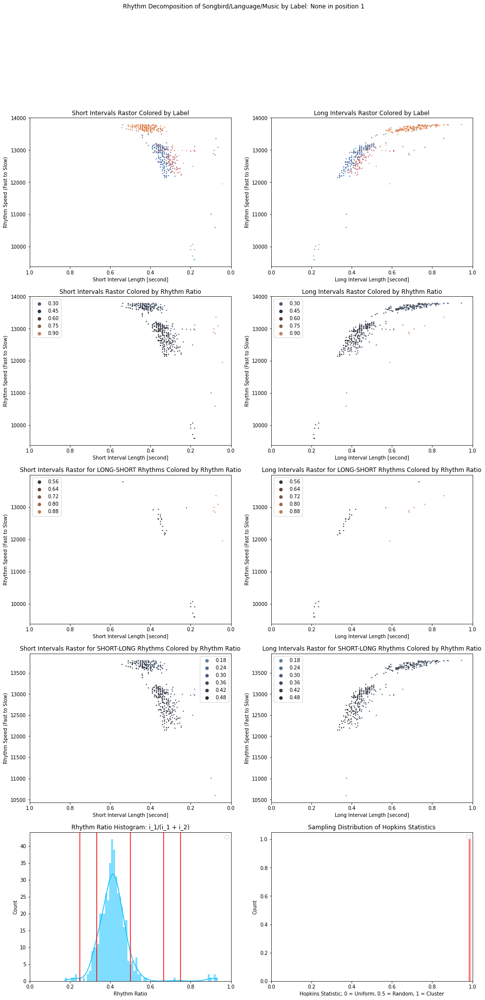

Currently Processing above 
0.45246375110225473


  0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


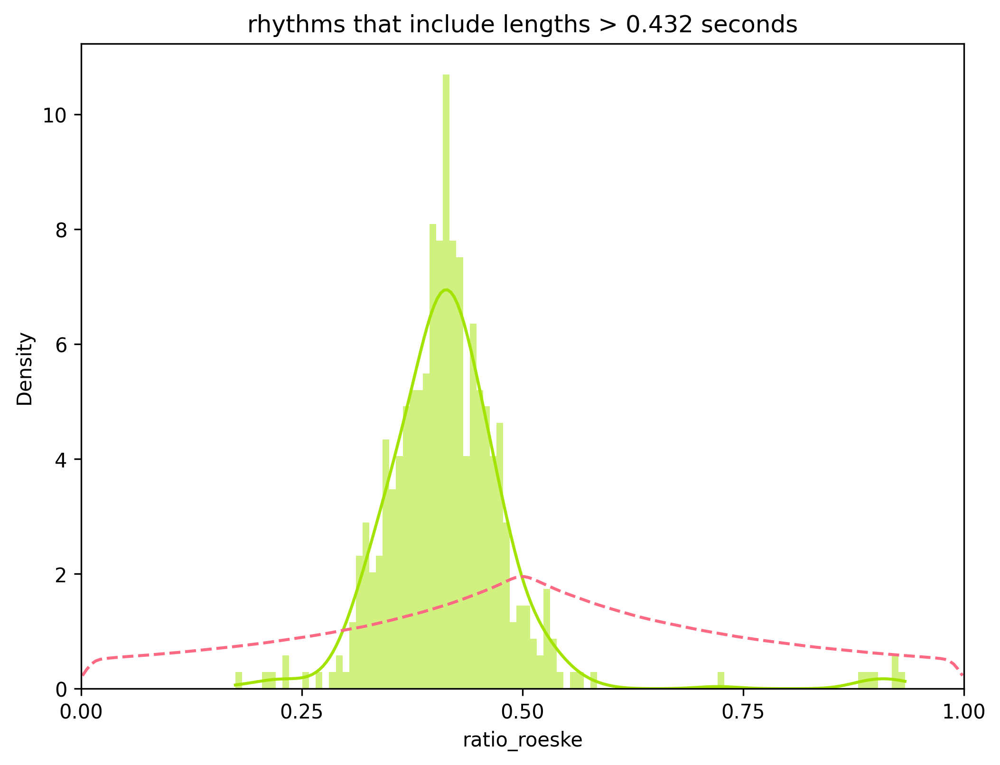

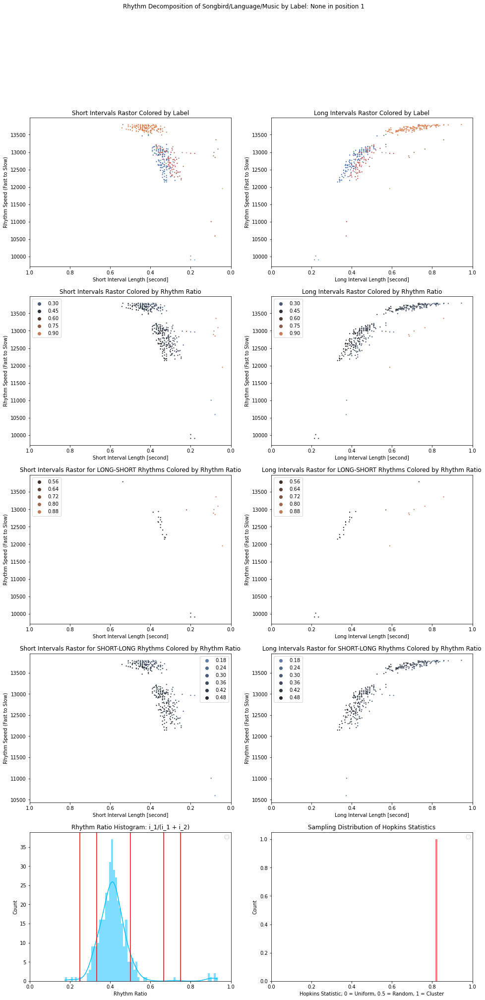

Currently Processing above 
0.472951291450081


  0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


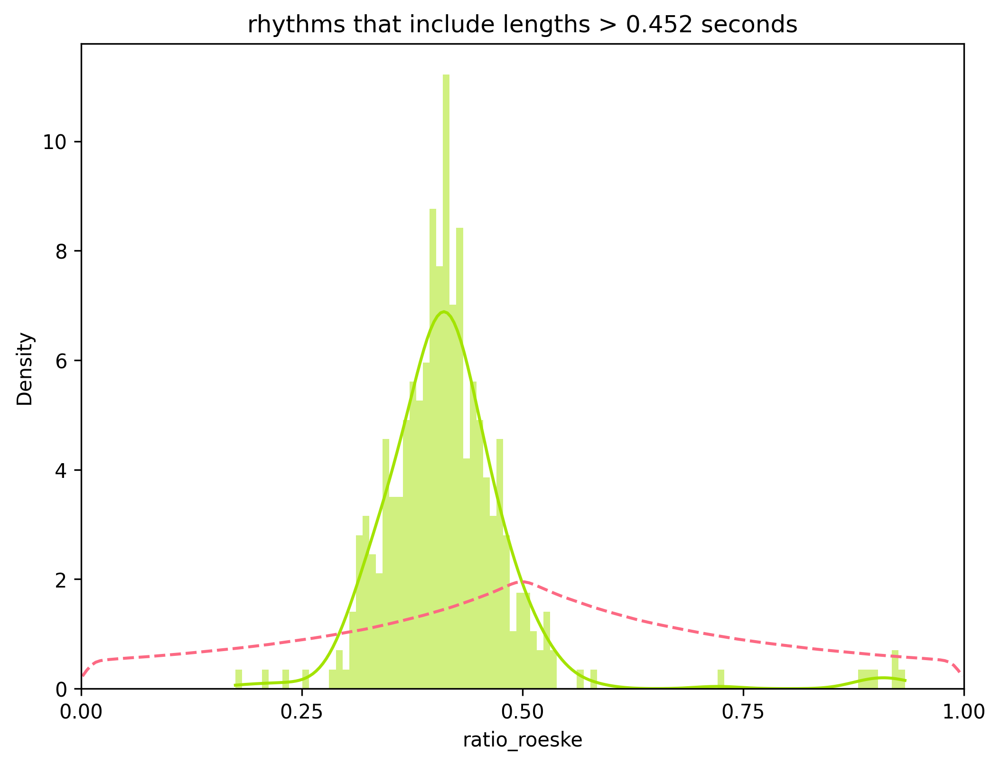

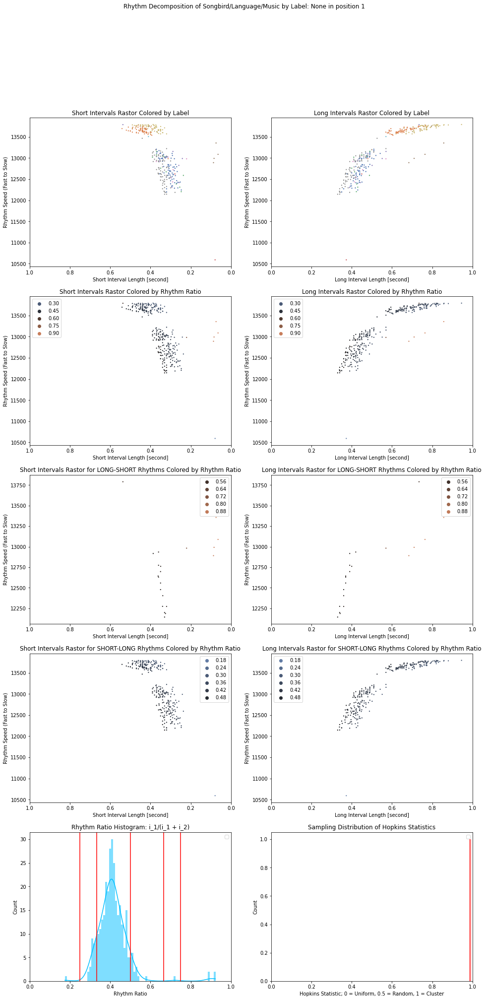

Currently Processing above 
0.48660965168196524


  0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


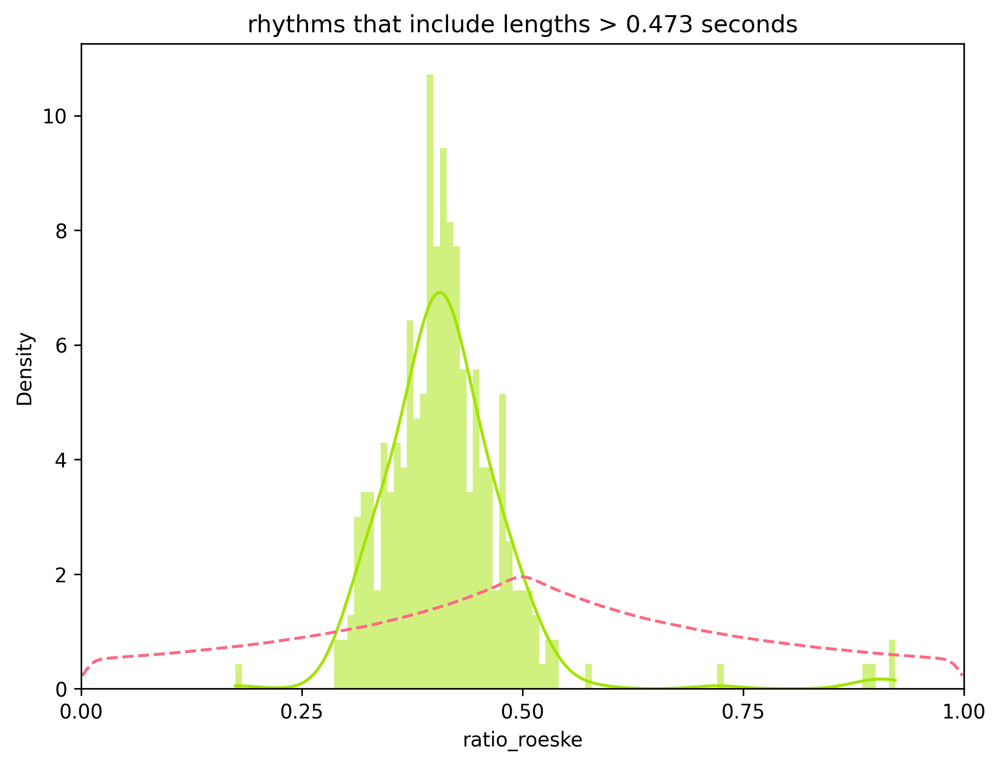

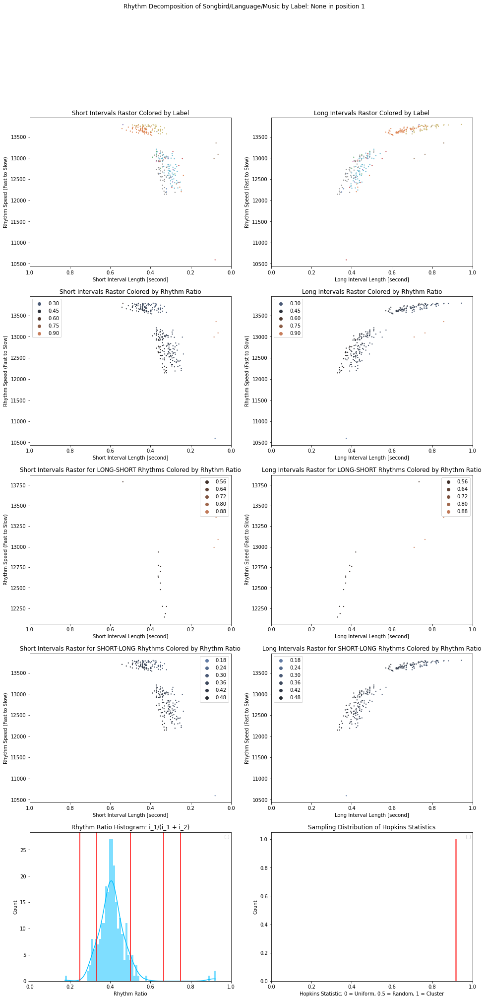

Currently Processing above 
0.5002680119138494


  0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


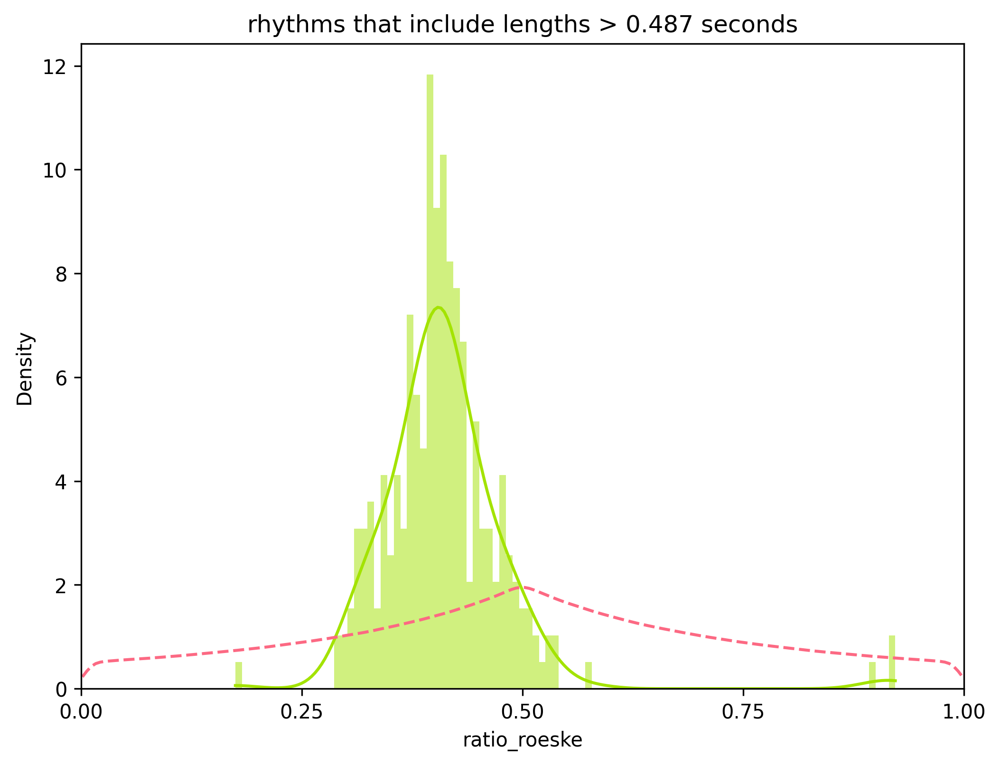

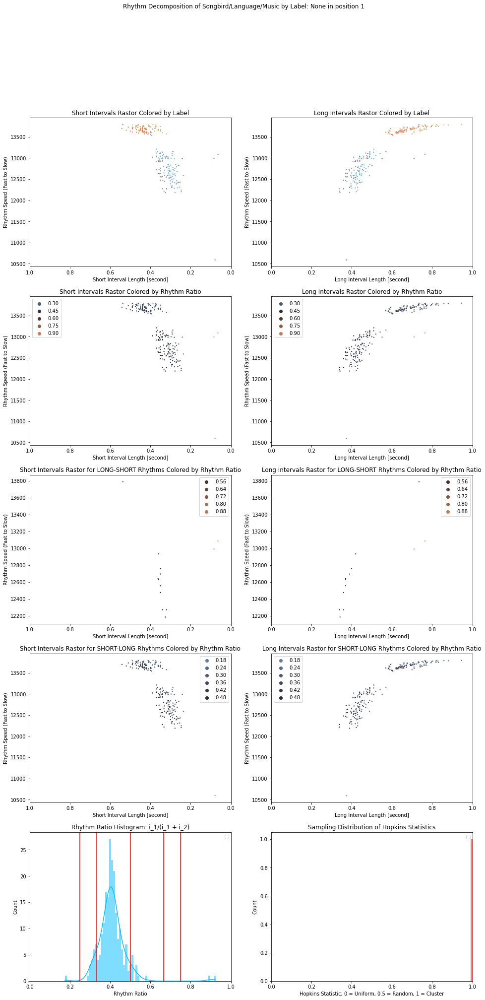

Currently Processing above 
0.5207555522616758


  0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


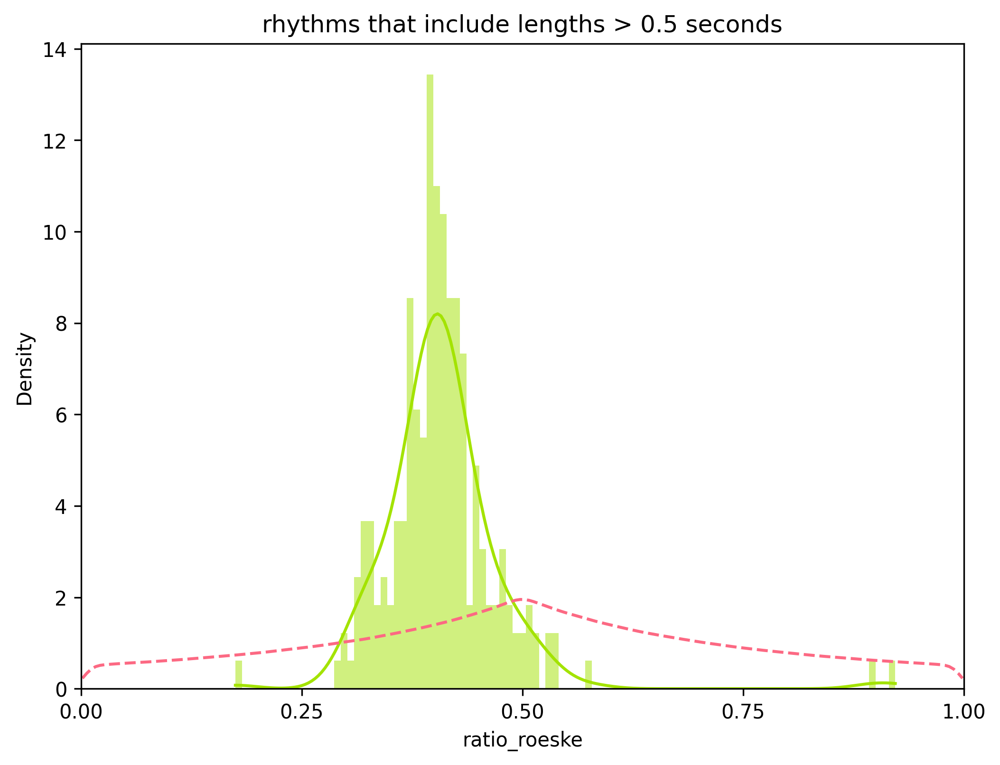

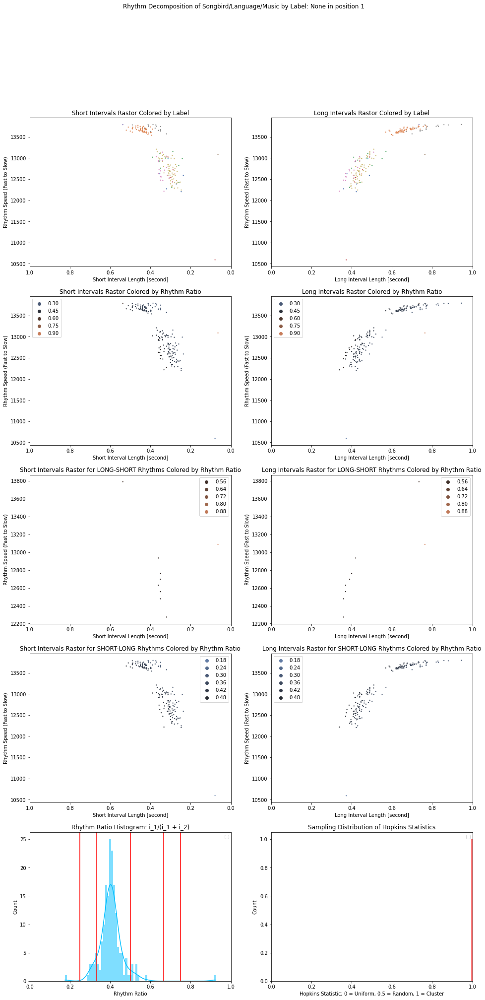

Currently Processing above 
0.5412430926095021


  0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


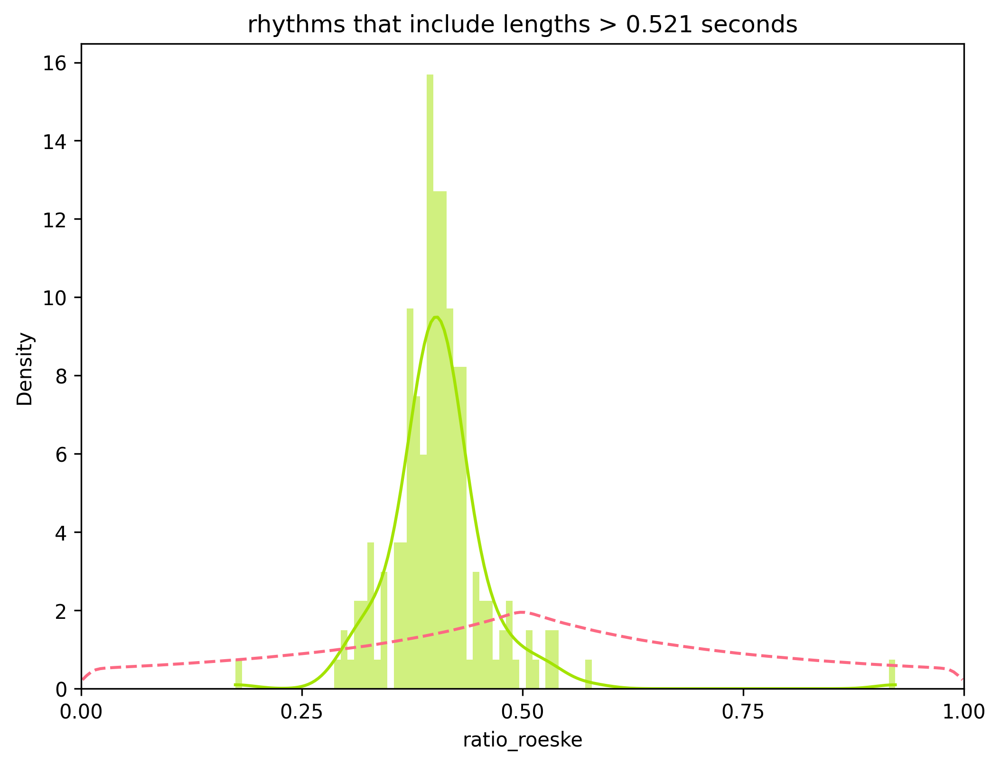

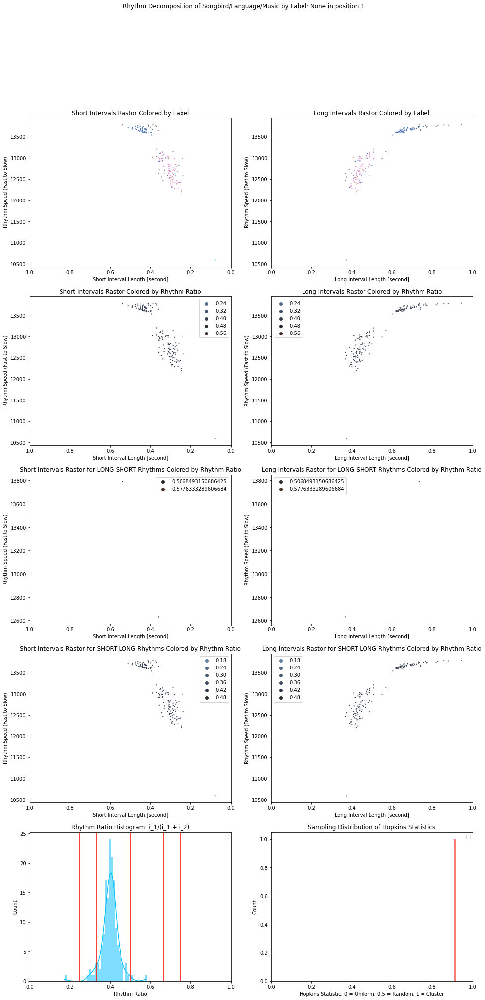

Currently Processing above 
0.5617306329573284


  0%|          | 0/1 [00:00<?, ?it/s]

ValueError: `bins` must be positive, when an integer

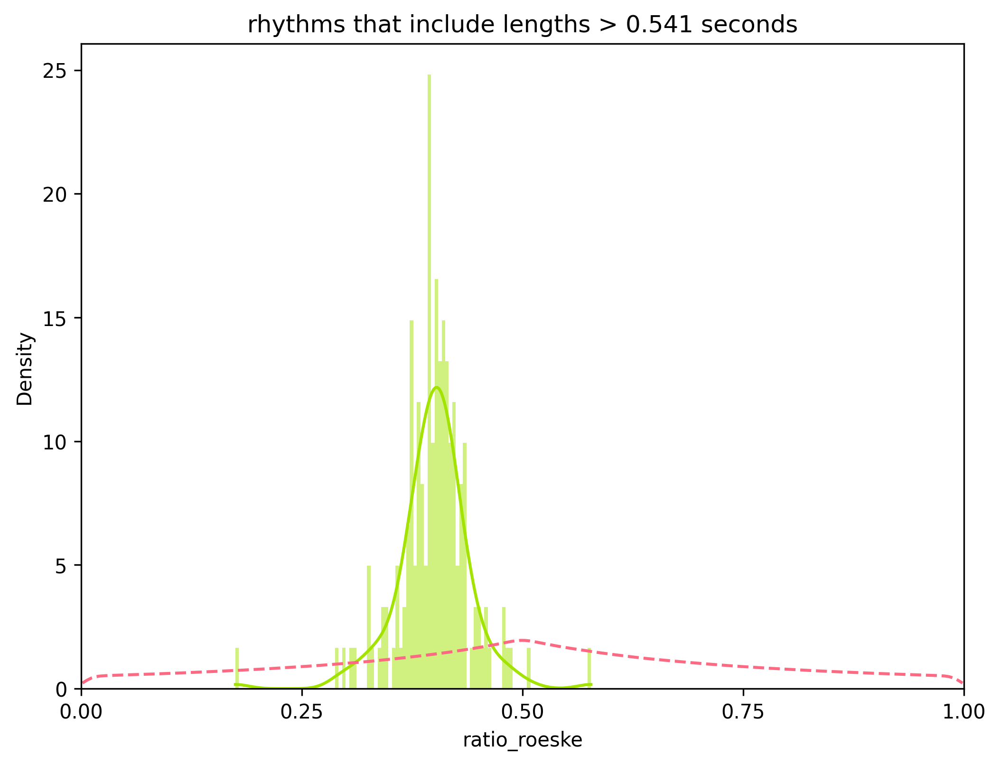

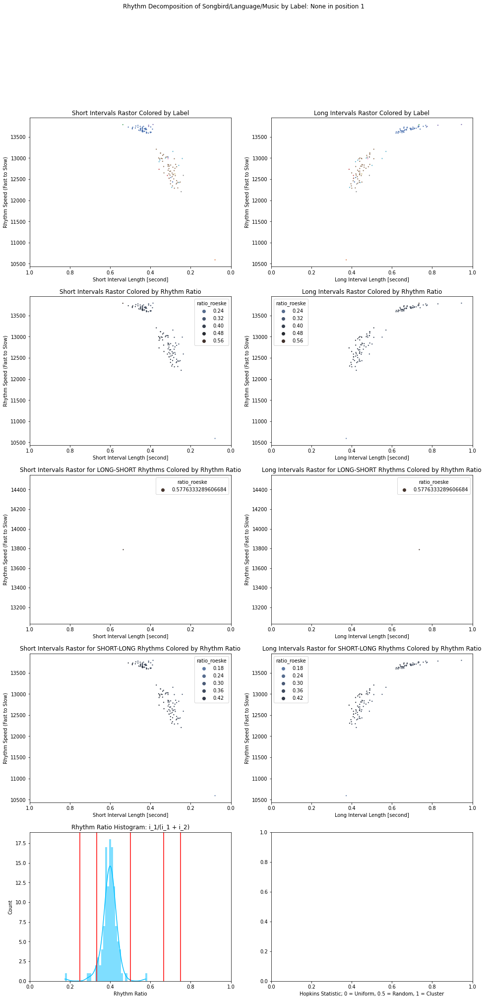

In [46]:
## reverse
hopkins_reverse = []

## for each local minimum
for local_min in x[min_idx[0]]:
    
    print('Currently Processing above ')
    print(local_min)
    
    filtered_dyadic = dyadic[dyadic['len1'] < local_min]
    filtered_dyadic = filtered_dyadic[filtered_dyadic['len2'] < local_min]
    filtered_dyadic = filtered_dyadic[filtered_dyadic['len3'] < local_min]
    
    dyadic_diff = pd.concat([dyadic,filtered_dyadic]).drop_duplicates(keep=False)
    
    h = butcherbird.rhythm.decompose_rhythm(
        ## Macro controls
        dyadic_diff, 
        label = None, 
        position = 1, 
        hopkins_iteration = 1,
        ## Graph controls
        figsize = (16, 32),
        xlim = (0, 1),
        s_interval = 's_interval',
        l_interval = 'l_interval', 
        cycle_rank = 'cycle_rank',
        marker = '.',
        color = 'black', 
        hue_norm = (0, 1),
        palette = 'deep',
        legend = False, 
        linewidth = 0,
        s = 20,
        s_ratio = 0.04,
        alpha = 1,
        alpha_ratio = 0.25,
        rhythm_ratio = 'ratio_roeske',
        binwidth = 0.01,
        kde = True
    )
    
    hopkins_reverse.append(np.mean(h))
    
    ## plot
    figure(figsize = (8, 6), dpi = 300)

    plt.rcParams['patch.edgecolor'] = 'none'

    fig = sns.histplot(
        x = dyadic_diff['ratio_roeske'],
        bins = 100,
        stat = 'density',
        color = '#A3E301',
        fill = '#A3E301',
        kde = True,
    )

    uni = sns.histplot(
        x = uni_ratio,
        stat = 'density',
        alpha = 0,
        color = '#FC6983',
        kde = True,
        line_kws = dict(linestyle = 'dashed')
    )

    #sf = plt.hist(
    #    x = sf_ratio,
    #    histtype = 'step',
    #    density = True, 
    #    bins = 100,
    #    color = '#15215B'
    #)

    ax = plt.gca()
    ax.set_xlim([0, 1])
    plt.xticks(np.arange(0, 1.25, 0.25))

    ax.set_title('rhythms that include lengths '+'> '+str(np.round(local_min, 3)) + ' seconds')
    
    # save
    figname = 'fig1_' + 'categorical_rhythm_filtered_reverse' + indv + str(np.round(local_min, 3)) + '.pdf'
    plt.savefig(FIGURE_DIR/figname)

In [ ]:
## Special Treatment fo 0.365

In [ ]:
local_min = x[min_idx[0]][-4]
local_min

In [ ]:
filtered_dyadic = dyadic[dyadic['len1'] < local_min]
filtered_dyadic = filtered_dyadic[filtered_dyadic['len2'] < local_min]
filtered_dyadic = filtered_dyadic[filtered_dyadic['len3'] < local_min]

In [ ]:
dyadic

In [ ]:
filtered_dyadic

In [ ]:
## what proportion of rhythm is taken out when taking out lengths > 0.365
1 - len(filtered_dyadic)/len(dyadic)

In [ ]:
len(note_df[note_df['note_len'] > local_min]) / len(note_df)